In [1]:
import numpy as np
import pandas as pd
import scipy as sp
import scanpy as sc
from glob import glob
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib as mpl
from matplotlib.pyplot import rc_context
import os
import seaborn as sns
import importlib
import re

In [2]:
import degSummary
from scanpyColor import godsnot_102

In [3]:
from adjustText import adjust_text

In [4]:
from scipy.stats import ranksums
import pingouin as pg

In [37]:
import statsmodels.stats.multitest as multi

In [5]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=150, facecolor='white', dpi_save=600)

scanpy==1.8.2 anndata==0.7.5 umap==0.5.3 numpy==1.23.5 scipy==1.10.0 pandas==1.5.3 scikit-learn==1.2.0 statsmodels==0.13.5 python-igraph==0.10.3 louvain==0.8.0 pynndescent==0.5.8


In [6]:
sns.set_theme(style="ticks")

# Load data

In [7]:
os.chdir('../..')

In [8]:
pwd

'/data/tcl/Project/ADFCA'

In [9]:
age_L=['10', '20', '30']
ageColor_L=['#1F77B4', '#FF7F0E', '#2CA02C', '#D62728']
ageColor_L2=['#009ACD', '#FF7D40', '#2CA02C', '#D62728']
ggplotColor3_L= ["#F8766D", "#00BA38", "#619CFF"]
set2Color_L=["#66C2A5", "#E9936A", "#A89BB0"]

In [10]:
genotype_L=['control', 'AB42', 'hTau']

In [11]:
figureFolder = 'Analysis/Figure'
os.makedirs(figureFolder, exist_ok=True)

In [12]:
figureDataFolder=f'Analysis/Figure'
os.makedirs(figureDataFolder, exist_ok=True)
figure1Folder=f'{figureDataFolder}/Figure1'
os.makedirs(figure1Folder, exist_ok=True)
figure2Folder=f'{figureDataFolder}/Figure2'
os.makedirs(figure2Folder, exist_ok=True)
figure2PicFolder=f'{figure2Folder}/pic'
os.makedirs(figure2PicFolder, exist_ok=True)

In [13]:
figure3Folder=f'{figureDataFolder}/Figure3'
os.makedirs(figure3Folder, exist_ok=True)
figure3PicFolder=f'{figure3Folder}/pic'
os.makedirs(figure3PicFolder, exist_ok=True)

In [14]:
figure4Folder=f'{figureDataFolder}/Figure4'
os.makedirs(figure4Folder, exist_ok=True)
figure4PicFolder=f'{figure4Folder}/pic'
os.makedirs(figure4PicFolder, exist_ok=True)

In [15]:
figure5Folder=f'{figureDataFolder}/Figure5'
os.makedirs(figure5Folder, exist_ok=True)
figure5PicFolder=f'{figure5Folder}/pic'
os.makedirs(figure5PicFolder, exist_ok=True)

In [16]:
cellnFolder=f'{figure2Folder}/cellN'
os.makedirs(cellnFolder, exist_ok=True)

compositionFolder=f'{figure2Folder}/composition'
os.makedirs(compositionFolder, exist_ok=True)

In [17]:
degControlFolder=f'{figure3Folder}/DEG_toControl'
os.makedirs(degControlFolder, exist_ok=True)

degGenoAgeFolder=f'{figure3Folder}/DEG_genoAge'
os.makedirs(degGenoAgeFolder, exist_ok=True)

degCelltypeFolder=f'{figure3Folder}/DEG_celltype'
os.makedirs(degCelltypeFolder, exist_ok=True)

In [18]:
geneNumFolder=f'{figure5Folder}/geneNum'
os.makedirs(geneNumFolder, exist_ok=True)

geneNumPicFolder=f'{geneNumFolder}/pic'
os.makedirs(geneNumPicFolder, exist_ok=True)

In [77]:
cellnFig4Folder=f'{figure4Folder}/cellN'
os.makedirs(cellnFig4Folder, exist_ok=True)

cellnFig5Folder=f'{figure5Folder}/cellN'
os.makedirs(cellnFig5Folder, exist_ok=True)

In [20]:
genoAge_L = ['control_10', 'control_20', 'control_30', 'AB42_10', 'AB42_20', 'hTau_20', 'hTau_30']

In [21]:
genoAgeSex_L = ['control_10_female', 'control_20_female', 'control_30_female', 'control_10_male', 'control_20_male', 'control_30_male', 
                'AB42_10_female', 'AB42_20_female', 'AB42_10_male', 'AB42_20_male', 
                'hTau_20_female', 'hTau_30_female', 'hTau_20_male', 'hTau_30_male']

In [22]:
# ageCompare
genoCompare_Df = pd.DataFrame(columns=['expSet', 'controlSet', 'age'])
# genoCompare_Df['expSet'] = [exp for exp in genoAge_L if 'control' not in exp]
# genoCompare_Df['controlSet'] = pd.Categorical(['control_' + '_'.join(genoAge.split('_')[1:]) for genoAge in genoCompare_Df['expSet']])


genoCompare_Df.loc[0,:] = ['AB42', 'control_inAB42', '10,20']
genoCompare_Df.loc[1,:] = ['hTau', 'control_inTau', '20,30']
genoCompare_Df

,expSet,controlSet,age
0,AB42,control_inAB42,"10,20"
1,hTau,control_inTau,"20,30"


In [23]:
celltypeN700_L = pd.read_csv(f'{cellnFolder}/celltype_cellN_n700.csv').annotation.to_list()

# neuronCellType_L = [x.strip() for x in open(f'{figure3Folder}/neuronCellType_L.txt')]
# nonNeuronCellType_L = [x.strip() for x in open(f'{figure3Folder}/nonNeuronCellType_L')]

In [24]:
# preMature_compare_L = ['hTau_20/control_20', 'hTau_30/control_30', 'AB42_10/control_10', 'AB42_20/control_20', 'control_30/control_20', 'control_20/control_10']
genoAgeCompare_L =    ['hTau_20/control_20', 'hTau_30/control_30', 'AB42_10/control_10', 'AB42_20/control_20', 'control_30/control_20', 'control_20/control_10']

# Fig. 5A: aging features: UMI#/gene# per cell (compare between different genoAge groups)

## Load files

In [28]:
adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_head_v0.6_woHarmony_raw.h5ad')
adata_body = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_body_v0.6_woHarmony_raw.h5ad')

In [29]:
adata_headBody = adata_head.concatenate(adata_body, join='outer')
adata_headBody

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


AnnData object with n_obs × n_vars = 624458 × 16219
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_subcluster'
    var: 'gene_ids', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    layers: 'logNormalize_exp', 'umi_counts'

In [30]:
adfcaTissue = 'head'

## Compare gene#

### Plot gene# and UMI#

In [28]:
for cellType in celltypeN700_L[:]:
    cellTypeName='_'.join(cellType.split('/'))
    adata=adata_headBody[adata_headBody.obs.adfca_annotation == cellType]
    for n, count in enumerate(['n_genes_by_counts', 'total_counts']):
        fig, ax = plt.subplots(figsize=(5, 5))
        sc.pl.violin(adata, keys=[count], groupby='genoAge', rotation=90, show=False, ax=ax) # 
        ax.set_title(f'{count}__{cellType}')
        plt.savefig(f'{geneNumPicFolder}/violin__{count}__{cellTypeName}.pdf', bbox_inches='tight')
        plt.close()
        
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{geneNumPicFolder}/{x}')

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.ob

In [31]:
### Use genoAgeSex groups
geneNum_genoAgeFolder=f'{figure5Folder}/geneNum_genoAge'
os.makedirs(geneNum_genoAgeFolder, exist_ok=True)
geneNum_genoAgePicFolder=f'{geneNum_genoAgeFolder}/pic'
os.makedirs(geneNum_genoAgePicFolder, exist_ok=True)

for cellType in celltypeN700_L[:]:
    cellTypeName='_'.join(cellType.split('/'))
    adata=adata_headBody[adata_headBody.obs.adfca_annotation == cellType]
    for n, count in enumerate(['n_genes_by_counts', 'total_counts']):
        fig, ax = plt.subplots(figsize=(5, 5))
        sc.pl.violin(adata, keys=[count], groupby='genoAgeSex', rotation=90, show=False, ax=ax) # 
        ax.set_title(f'{count}__{cellType}')
        plt.savefig(f'{geneNum_genoAgePicFolder}/violin__{count}__{cellTypeName}.pdf', bbox_inches='tight')
        plt.close()
        
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{geneNumPicFolder}/{x}')

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.ob

### Load gene# and UMI#

In [32]:
### calculate median gene# & umi#
geneN_Df = pd.DataFrame(columns=['genoAgeCompare', 'annotation', 'medGeneNum_exp', 'medGeneNum_ref', 'medUmiNum_exp', 'medUmiNum_ref', 'genenRatio', 'genenLog2Ratio', 'umiRatio', 'umiLog2Ratio' ])

n=0
for genoAgeCompare in genoAgeCompare_L:
    print(genoAgeCompare)
    genoAgeCompareName = '_'.join(genoAgeCompare.split('/'))
    exp, ref = genoAgeCompare.split('/')
    
    umiRatio_L=[]
    umiLog2Ratio_L=[]
    geneN_ratio_L=[]
    geneN_log2ratio_L=[]
    
    for k, cellType in enumerate(celltypeN700_L):
        adata = adata_headBody[ (adata_headBody.obs.genoAge.isin([exp, ref])) & (adata_headBody.obs.adfca_annotation == cellType) ]
        # print(cellType)
        # print(adata)
        
        medGeneNum_exp, medGeneNum_ref, medUmiNum_exp, medUmiNum_ref = adata[adata.obs.genoAge == exp].obs.n_genes_by_counts.median(), adata[adata.obs.genoAge == ref].obs.n_genes_by_counts.median(), \
            adata[adata.obs.genoAge == exp].obs.total_counts.median(), adata[adata.obs.genoAge == ref].obs.total_counts.median()
        
        genenRatio=medGeneNum_exp/medGeneNum_ref
        genenLog2Ratio=np.log2(genenRatio)
        geneN_ratio_L.append(genenRatio)
        geneN_log2ratio_L.append(genenLog2Ratio)
        
        umiRatio=medUmiNum_exp/medUmiNum_ref
        umiLog2Ratio=np.log2(umiRatio)
        umiRatio_L.append(umiRatio)
        umiLog2Ratio_L.append(umiLog2Ratio)
        
        # print(medGeneNum_exp, medGeneNum_ref, medUmiNum_exp, medUmiNum_ref)
        # print(genenRatio, genenLog2Ratio, umiRatio, umiLog2Ratio)
        
        geneN_Df.loc[n] = [genoAgeCompare, cellType, medGeneNum_exp, medGeneNum_ref, medUmiNum_exp, medUmiNum_ref, genenRatio, genenLog2Ratio, umiRatio, umiLog2Ratio]
        n+=1
        
    print()

# geneN_Df.reset_index(drop=True, inplace=True)
geneN_Df.to_csv(f'{geneNumFolder}/geneNum_genoAgeCompareName.csv', index=False)

hTau_20/control_20

hTau_30/control_30

AB42_10/control_10

AB42_20/control_20

control_30/control_20

control_20/control_10



In [33]:
sortOrder_L = geneN_Df[geneN_Df.genoAgeCompare == 'hTau_20/control_20'].sort_values(by='genenLog2Ratio', ascending=False).annotation.to_list()

In [34]:
geneN_sort_Df = pd.DataFrame(columns=['genoAgeCompare', 'annotation', 'ratioType', 'log2Ratio',])
for genoAgeCompare in genoAgeCompare_L:
    print(genoAgeCompare)
    genoAgeCompareName = '_'.join(genoAgeCompare.split('/'))
    exp, ref = genoAgeCompare.split('/')
    
    #sorted DF
    genoAge_sort_Df = geneN_Df[geneN_Df.genoAgeCompare == genoAgeCompare]
    genoAge_sort_Df.index = genoAge_sort_Df.annotation.to_list()
    genoAge_sort_Df=genoAge_sort_Df.loc[sortOrder_L]
    genoAge_sort_Df=genoAge_sort_Df.loc[:,['genoAgeCompare', 'annotation', 'genenLog2Ratio', 'umiLog2Ratio']
                                       ].melt(id_vars=['genoAgeCompare', 'annotation'], var_name='ratioType', value_name='log2Ratio') #  
    geneN_sort_Df = pd.concat([geneN_sort_Df, genoAge_sort_Df ], axis=0)
    

geneN_sort_Df.reset_index(drop=True, inplace=True)
geneN_sort_Df

hTau_20/control_20
hTau_30/control_30
AB42_10/control_10
AB42_20/control_20
control_30/control_20
control_20/control_10


,genoAgeCompare,annotation,ratioType,log2Ratio
0,hTau_20/control_20,hemocyte_body,genenLog2Ratio,0.386481
1,hTau_20/control_20,ejaculatory bulb,genenLog2Ratio,0.340979
2,hTau_20/control_20,adult ventral nervous system,genenLog2Ratio,0.185075
3,hTau_20/control_20,intestinal stem cell,genenLog2Ratio,0.175012
4,hTau_20/control_20,hemocyte_head,genenLog2Ratio,0.157135
...,...,...,...,...
1219,control_20/control_10,seminal vesicle & testis epithelia,umiLog2Ratio,-0.066939
1220,control_20/control_10,anterior ejaculatory duct,umiLog2Ratio,-0.596953
1221,control_20/control_10,enterocyte of anterior adult midgut epithelium,umiLog2Ratio,-0.256904
1222,control_20/control_10,male accessory gland main cell_roX1+,umiLog2Ratio,-0.012971


### wilcoxon rank sum test

In [35]:
for col in ['ranksumsTwoSides_stat', 'ranksumsTwoSides_pvalue', 'ranksumsGreater_stat', 'ranksumsGreater_pvalue', 'ranksumsLess_stat', 'ranksumsLess_pvalue']:
    geneN_sort_Df[col] = np.nan


### stat: wilcoxon rank sum test
for n, cellType in enumerate(geneN_sort_Df.annotation):
    adata=adata_headBody[ (adata_headBody.obs.adfca_annotation == cellType) ]
    
    genoAgeCompare = geneN_sort_Df.genoAgeCompare[n]
    expSet, controlSet = genoAgeCompare.split('/')
    ratioType = geneN_sort_Df.ratioType[n]
    
    if 'umi' in ratioType: countType = 'total_counts'
    else: countType = 'n_genes_by_counts'
    
    
    countExp_L=adata[adata.obs.genoAge == expSet].obs[countType].to_list()
    countControl_L=adata[adata.obs.genoAge == controlSet].obs[countType].to_list()

    # Stat
    ranksumsTwosides=ranksums(countExp_L, countControl_L)
    ranksumsGreater=ranksums(countExp_L, countControl_L, alternative='greater')
    ranksumsLess=ranksums(countExp_L, countControl_L, alternative='less')

    geneN_sort_Df.iloc[n, 4:] = [ranksumsTwosides.statistic, ranksumsTwosides.pvalue, ranksumsGreater.statistic, ranksumsGreater.pvalue, ranksumsLess.statistic, ranksumsLess.pvalue]
    

geneN_sort_Df.to_csv(f'{geneNumFolder}/geneN_sort_Df_genoAgeCompare_wilcoxon.csv', index=False)
geneN_sort_Df

,genoAgeCompare,annotation,ratioType,log2Ratio,ranksumsTwoSides_stat,ranksumsTwoSides_pvalue,ranksumsGreater_stat,ranksumsGreater_pvalue,ranksumsLess_stat,ranksumsLess_pvalue
0,hTau_20/control_20,hemocyte_body,genenLog2Ratio,0.386481,13.802174,2.472802e-43,13.802174,1.236401e-43,13.802174,1.000000e+00
1,hTau_20/control_20,ejaculatory bulb,genenLog2Ratio,0.340979,6.727306,1.728336e-11,6.727306,8.641681e-12,6.727306,1.000000e+00
2,hTau_20/control_20,adult ventral nervous system,genenLog2Ratio,0.185075,9.276021,1.759253e-20,9.276021,8.796264e-21,9.276021,1.000000e+00
3,hTau_20/control_20,intestinal stem cell,genenLog2Ratio,0.175012,5.037615,4.713694e-07,5.037615,2.356847e-07,5.037615,9.999998e-01
4,hTau_20/control_20,hemocyte_head,genenLog2Ratio,0.157135,8.031052,9.664037e-16,8.031052,4.832019e-16,8.031052,1.000000e+00
...,...,...,...,...,...,...,...,...,...,...
1219,control_20/control_10,seminal vesicle & testis epithelia,umiLog2Ratio,-0.066939,-1.419655,1.557081e-01,-1.419655,9.221460e-01,-1.419655,7.785404e-02
1220,control_20/control_10,anterior ejaculatory duct,umiLog2Ratio,-0.596953,-8.198830,2.427389e-16,-8.198830,1.000000e+00,-8.198830,1.213694e-16
1221,control_20/control_10,enterocyte of anterior adult midgut epithelium,umiLog2Ratio,-0.256904,-0.884019,3.766860e-01,-0.884019,8.116570e-01,-0.884019,1.883430e-01
1222,control_20/control_10,male accessory gland main cell_roX1+,umiLog2Ratio,-0.012971,-0.489433,6.245353e-01,-0.489433,6.877324e-01,-0.489433,3.122676e-01


In [38]:
allGeneN_test_Df = pd.DataFrame(columns=['statistic', 'pvalue', 'group1', 'group2', 'annotation'])
allUmiN_test_Df = pd.DataFrame(columns=['statistic', 'pvalue', 'group1', 'group2', 'annotation'])

genenFdr_L=[]
uminFdr_L =[]
for k, cellType in enumerate(celltypeN700_L[:]):
    adata = adata_headBody[ (adata_headBody.obs.adfca_annotation == cellType) ] # (adata_headBody.obs.genoAge.isin([exp, ref])) &
    print(cellType)
    # print(adata)
    
    genenPvalue_L=[]
    uminPvalue_L =[]
    
    for i, refGenoAge in enumerate(genoAge_L[:-1]):
        for j, comGenoAge in enumerate(genoAge_L[i+1:]):
            comGenoAge = genoAge_L[i+j+1]
            # print(comGenoAge, refGenoAge)
            
            com_geneN_L = adata[adata.obs.genoAge == comGenoAge].obs.n_genes_by_counts.to_list()
            ref_geneN_L = adata[adata.obs.genoAge == refGenoAge].obs.n_genes_by_counts.to_list()
            ranksumGeneN=ranksums(com_geneN_L, ref_geneN_L)
            genenStat, genenPval= ranksumGeneN.statistic, ranksumGeneN.pvalue
            allGeneN_test_Df.loc[len(allGeneN_test_Df)] = [genenStat, genenPval, comGenoAge, refGenoAge, cellType]
            genenPvalue_L.append(genenPval)
            
            com_umiN_L = adata[adata.obs.genoAge == comGenoAge].obs.total_counts.to_list()
            ref_umiN_L = adata[adata.obs.genoAge == refGenoAge].obs.total_counts.to_list()
            ranksumUmiN = ranksums(com_umiN_L, ref_umiN_L)
            umiStat, umiPval= ranksumUmiN.statistic, ranksumUmiN.pvalue
            allUmiN_test_Df.loc[len(allUmiN_test_Df)] = [umiStat, umiPval, comGenoAge, refGenoAge, cellType]
            uminPvalue_L.append(umiPval)
        
    genenFdr_L.extend( list(multi.fdrcorrection(genenPvalue_L, )[1])  )
    uminFdr_L.extend(  list(multi.fdrcorrection(uminPvalue_L, )[1])  )

    
allGeneN_test_Df['fdr_bh'] = genenFdr_L
allUmiN_test_Df['fdr_bh'] = uminFdr_L

allGeneN_test_Df.to_csv(f'{geneNumFolder}/geneN_genoAgeCompare_wilcoxon_fdr.csv', index=False)
allUmiN_test_Df.to_csv(f'{geneNumFolder}/umiN_genoAgeCompare_wilcoxon_fdr.csv', index=False)

16-cell germline cyst in germarium region 2a and 2b
ABeta42-specific cluster
T neuron T2
T neuron T2a
T neuron T3
T neuron T4/T5
adult alary muscle
adult brain cell body glial cell
adult brain perineurial glial cell
adult fat body_body
adult fat body_head
adult glial cell
adult hindgut
adult lamina epithelial/marginal glial cell
adult oenocyte
adult optic chiasma glial cell
adult peripheral nervous system
adult reticular neuropil associated glial cell_head
adult salivary gland
adult tracheal cell_body
adult tracheal cell_head
adult ventral nervous system
alpha'/beta' Kenyon cell
alpha/beta Kenyon cell
anterior ejaculatory duct
auditory sensory neuron
cardia (1)
cell body glial cell
centrifugal neuron C2
centrifugal neuron C3
choriogenic main body follicle cell and corpus luteum
columnar neuron T1
cone cell
crop
distal medullary amacrine neuron Dm10
distal medullary amacrine neuron Dm2
distal medullary amacrine neuron Dm3
distal medullary amacrine neuron Dm8
ejaculatory bulb
ejaculatory

In [39]:
geneN_sort_Df.sort_values(by='ranksumsTwoSides_pvalue').head(n=50)

,genoAgeCompare,annotation,ratioType,log2Ratio,ranksumsTwoSides_stat,ranksumsTwoSides_pvalue,ranksumsGreater_stat,ranksumsGreater_pvalue,ranksumsLess_stat,ranksumsLess_pvalue
196,hTau_20/control_20,follicle cell,umiLog2Ratio,-0.714177,-55.858734,0.000000e+00,-55.858734,1.000000e+00,-55.858734,0.000000e+00
94,hTau_20/control_20,follicle cell,genenLog2Ratio,-0.356431,-46.161761,0.000000e+00,-46.161761,1.000000e+00,-46.161761,0.000000e+00
1012,control_30/control_20,follicle cell,umiLog2Ratio,-1.061095,-53.080373,0.000000e+00,-53.080373,1.000000e+00,-53.080373,0.000000e+00
910,control_30/control_20,follicle cell,genenLog2Ratio,-0.628684,-49.808178,0.000000e+00,-49.808178,1.000000e+00,-49.808178,0.000000e+00
197,hTau_20/control_20,adult fat body_body,umiLog2Ratio,-0.683409,-36.002465,7.654349e-284,-36.002465,1.000000e+00,-36.002465,3.827174e-284
1013,control_30/control_20,adult fat body_body,umiLog2Ratio,-0.402270,-33.875850,1.511195e-251,-33.875850,1.000000e+00,-33.875850,7.555977e-252
837,control_30/control_20,outer photoreceptor cell,genenLog2Ratio,-0.204446,-32.507781,8.278049e-232,-32.507781,1.000000e+00,-32.507781,4.139024e-232
95,hTau_20/control_20,adult fat body_body,genenLog2Ratio,-0.370494,-31.283065,7.931425e-215,-31.283065,1.000000e+00,-31.283065,3.965713e-215
502,AB42_10/control_10,follicle cell,genenLog2Ratio,-0.236479,-30.861821,3.888142e-209,-30.861821,1.000000e+00,-30.861821,1.944071e-209
735,AB42_20/control_20,outer photoreceptor cell,umiLog2Ratio,0.378723,29.965630,2.753328e-197,29.965630,1.376664e-197,29.965630,1.000000e+00


In [40]:
geneN_sort_Df[ geneN_sort_Df.annotation == 'adult oenocyte']

,genoAgeCompare,annotation,ratioType,log2Ratio,ranksumsTwoSides_stat,ranksumsTwoSides_pvalue,ranksumsGreater_stat,ranksumsGreater_pvalue,ranksumsLess_stat,ranksumsLess_pvalue
33,hTau_20/control_20,adult oenocyte,genenLog2Ratio,-0.024837,-3.364644,7.664253e-04,-3.364644,9.996168e-01,-3.364644,3.832126e-04
135,hTau_20/control_20,adult oenocyte,umiLog2Ratio,-0.279701,-13.275893,3.194417e-40,-13.275893,1.000000e+00,-13.275893,1.597208e-40
237,hTau_30/control_30,adult oenocyte,genenLog2Ratio,0.036406,2.591415,9.558204e-03,2.591415,4.779102e-03,2.591415,9.952209e-01
339,hTau_30/control_30,adult oenocyte,umiLog2Ratio,0.130458,6.673207,2.502727e-11,6.673207,1.251364e-11,6.673207,1.000000e+00
441,AB42_10/control_10,adult oenocyte,genenLog2Ratio,-0.102205,-9.809796,1.021745e-22,-9.809796,1.000000e+00,-9.809796,5.108723e-23
543,AB42_10/control_10,adult oenocyte,umiLog2Ratio,-0.202549,-11.264650,1.961294e-29,-11.264650,1.000000e+00,-11.264650,9.806470e-30
645,AB42_20/control_20,adult oenocyte,genenLog2Ratio,0.012978,2.092490,3.639466e-02,2.092490,1.819733e-02,2.092490,9.818027e-01
747,AB42_20/control_20,adult oenocyte,umiLog2Ratio,0.085114,4.546666,5.450248e-06,4.546666,2.725124e-06,4.546666,9.999973e-01
849,control_30/control_20,adult oenocyte,genenLog2Ratio,-0.146221,-12.062771,1.660992e-33,-12.062771,1.000000e+00,-12.062771,8.304962e-34
951,control_30/control_20,adult oenocyte,umiLog2Ratio,-0.322915,-18.674319,8.010566e-78,-18.674319,1.000000e+00,-18.674319,4.005283e-78


In [41]:
geneN_sort_Df[ geneN_sort_Df.annotation == 'adult fat body_body']

,genoAgeCompare,annotation,ratioType,log2Ratio,ranksumsTwoSides_stat,ranksumsTwoSides_pvalue,ranksumsGreater_stat,ranksumsGreater_pvalue,ranksumsLess_stat,ranksumsLess_pvalue
95,hTau_20/control_20,adult fat body_body,genenLog2Ratio,-0.370494,-31.283065,7.931425e-215,-31.283065,1.000000,-31.283065,3.965713e-215
197,hTau_20/control_20,adult fat body_body,umiLog2Ratio,-0.683409,-36.002465,7.654349e-284,-36.002465,1.000000,-36.002465,3.827174e-284
299,hTau_30/control_30,adult fat body_body,genenLog2Ratio,0.000640,-0.795981,4.260429e-01,-0.795981,0.786979,-0.795981,2.130214e-01
401,hTau_30/control_30,adult fat body_body,umiLog2Ratio,-0.005388,1.083111,2.787593e-01,1.083111,0.139380,1.083111,8.606203e-01
503,AB42_10/control_10,adult fat body_body,genenLog2Ratio,-0.131839,-22.965072,1.041809e-116,-22.965072,1.000000,-22.965072,5.209044e-117
605,AB42_10/control_10,adult fat body_body,umiLog2Ratio,-0.285809,-27.753784,1.568566e-169,-27.753784,1.000000,-27.753784,7.842830e-170
707,AB42_20/control_20,adult fat body_body,genenLog2Ratio,-0.044002,-5.888907,3.887591e-09,-5.888907,1.000000,-5.888907,1.943795e-09
809,AB42_20/control_20,adult fat body_body,umiLog2Ratio,-0.056007,-4.169216,3.056495e-05,-4.169216,0.999985,-4.169216,1.528248e-05
911,control_30/control_20,adult fat body_body,genenLog2Ratio,-0.167290,-24.856159,2.218281e-136,-24.856159,1.000000,-24.856159,1.109141e-136
1013,control_30/control_20,adult fat body_body,umiLog2Ratio,-0.402270,-33.875850,1.511195e-251,-33.875850,1.000000,-33.875850,7.555977e-252


### ANOVA: gene# and UMI# differences

In [43]:
# for genoAgeCompare in genoAgeCompare_L:
#     print(genoAgeCompare)
#     genoAgeCompareName = '_'.join(genoAgeCompare.split('/'))
#     exp, ref = genoAgeCompare.split('/')
#     # print(exp, ref)

allGeneN_test_Df = pd.DataFrame()
allUmiN_test_Df = pd.DataFrame()

for k, cellType in enumerate(celltypeN700_L[:]):
    adata = adata_headBody[ (adata_headBody.obs.adfca_annotation == cellType) ] # (adata_headBody.obs.genoAge.isin([exp, ref])) &
    print(cellType)
    # print(adata)

    results_geneN = pg.pairwise_gameshowell(adata.obs, 'n_genes_by_counts', 'genoAge')
    results_umiN  = pg.pairwise_gameshowell(adata.obs, 'total_counts', 'genoAge')
    
    results_geneN['annotation'] = [cellType for i in range(len(results_geneN))]
    results_umiN['annotation'] = [cellType for i in range(len(results_umiN))]
    
    if len(allGeneN_test_Df) == 0:
        allGeneN_test_Df = results_geneN
        allUmiN_test_Df = results_umiN
    else:
        allGeneN_test_Df = pd.concat([allGeneN_test_Df, results_geneN])
        allUmiN_test_Df = pd.concat([allGeneN_test_Df, results_umiN])
    
    # print(results_geneN)
    # print()

16-cell germline cyst in germarium region 2a and 2b
ABeta42-specific cluster
T neuron T2
T neuron T2a
T neuron T3
T neuron T4/T5
adult alary muscle
adult brain cell body glial cell
adult brain perineurial glial cell
adult fat body_body
adult fat body_head
adult glial cell
adult hindgut
adult lamina epithelial/marginal glial cell
adult oenocyte
adult optic chiasma glial cell
adult peripheral nervous system
adult reticular neuropil associated glial cell_head
adult salivary gland
adult tracheal cell_body
adult tracheal cell_head
adult ventral nervous system
alpha'/beta' Kenyon cell
alpha/beta Kenyon cell
anterior ejaculatory duct
auditory sensory neuron
cardia (1)
cell body glial cell
centrifugal neuron C2
centrifugal neuron C3
choriogenic main body follicle cell and corpus luteum
columnar neuron T1
cone cell
crop
distal medullary amacrine neuron Dm10
distal medullary amacrine neuron Dm2
distal medullary amacrine neuron Dm3
distal medullary amacrine neuron Dm8
ejaculatory bulb
ejaculatory

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scipy/integrate/_quadpack_py.py:1225: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  quad_r = quad(f, low, high, args=args, full_output=self.full_output,


gamma Kenyon cell
germline cell
hemocyte_body
hemocyte_head
indirect flight muscle
intestinal stem cell
lamina intrinsic neuron
lamina monopolar neuron L1
lamina monopolar neuron L2
lamina monopolar neuron L3
lamina monopolar neuron L4
lamina monopolar neuron L5
lobula columnar neuron LC16
lobula columnar neuron LC17
lobula plate-lobula columnar LPLC2
male accessory gland main cell_roX1+
mechanosensory neuron
medullary intrinsic neuron Mi1
medullary intrinsic neuron Mi15
medullary intrinsic neuron Mi4
medullary intrinsic neuron Mi9
muscle cell
neuron 1
neuron 2
neuron 4
neuron 5
neuron 6
neuron 8
ocellus retinula cell
olfactory projection neuron
olfactory receptor neuron
optic-lobe-associated cortex glial cell
outer photoreceptor cell
oviduct
pericerebral adult fat mass
perineurial glial sheath
photoreceptor cell R7
photoreceptor cell R8
pigment cell
seminal vesicle & testis epithelia
skeletal muscle of head
subperineurial glial cell_head
transmedullary Y neuron TmY3
transmedullary Y n

In [42]:
allGeneN_test_Df.to_csv(f'{figure5Folder}/allGeneN_ANOVA.csv', index=None)
allUmiN_test_Df.to_csv(f'{figure5Folder}/allUmiN_ANOVA.csv', index=None)

### Multiple KS test

In [43]:
allGeneN_test_Df = pd.DataFrame(columns=['statistic', 'pvalue', 'group1', 'group2', 'annotation'])
allUmiN_test_Df = pd.DataFrame(columns=['statistic', 'pvalue', 'group1', 'group2', 'annotation'])

genenFdr_L=[]
uminFdr_L =[]
for k, cellType in enumerate(celltypeN700_L[:]):
    adata = adata_headBody[ (adata_headBody.obs.adfca_annotation == cellType) ] # (adata_headBody.obs.genoAge.isin([exp, ref])) &
    print(cellType)
    # print(adata)
    
    genenPvalue_L=[]
    uminPvalue_L =[]
    
    for i, refGenoAge in enumerate(genoAge_L[:-1]):
        for j, comGenoAge in enumerate(genoAge_L[i+1:]):
            comGenoAge = genoAge_L[i+j+1]
            # print(comGenoAge, refGenoAge)
            
            com_geneN_L = adata[adata.obs.genoAge == comGenoAge].obs.n_genes_by_counts.to_list()
            ref_geneN_L = adata[adata.obs.genoAge == refGenoAge].obs.n_genes_by_counts.to_list()
            ksGeneN=sp.stats.kstest(com_geneN_L, ref_geneN_L)
            genenStat, genenPval= ksGeneN
            allGeneN_test_Df.loc[len(allGeneN_test_Df)] = [genenStat, genenPval, comGenoAge, refGenoAge, cellType]
            genenPvalue_L.append(genenPval)
            
            com_umiN_L = adata[adata.obs.genoAge == comGenoAge].obs.total_counts.to_list()
            ref_umiN_L = adata[adata.obs.genoAge == refGenoAge].obs.total_counts.to_list()
            ksUmiN=sp.stats.kstest(com_umiN_L, ref_umiN_L)
            umiStat, umiPval= ksUmiN
            allUmiN_test_Df.loc[len(allUmiN_test_Df)] = [umiStat, umiPval, comGenoAge, refGenoAge, cellType]
            uminPvalue_L.append(umiPval)
        
    genenFdr_L.extend( list(multi.fdrcorrection(genenPvalue_L, )[1])  )
    uminFdr_L.extend(  list(multi.fdrcorrection(uminPvalue_L, )[1])  )

    
allGeneN_test_Df['fdr_bh'] = genenFdr_L
allUmiN_test_Df['fdr_bh'] = uminFdr_L

16-cell germline cyst in germarium region 2a and 2b
ABeta42-specific cluster
T neuron T2
T neuron T2a
T neuron T3
T neuron T4/T5
adult alary muscle
adult brain cell body glial cell
adult brain perineurial glial cell
adult fat body_body
adult fat body_head
adult glial cell
adult hindgut
adult lamina epithelial/marginal glial cell
adult oenocyte
adult optic chiasma glial cell
adult peripheral nervous system
adult reticular neuropil associated glial cell_head
adult salivary gland
adult tracheal cell_body
adult tracheal cell_head
adult ventral nervous system
alpha'/beta' Kenyon cell
alpha/beta Kenyon cell
anterior ejaculatory duct
auditory sensory neuron
cardia (1)
cell body glial cell
centrifugal neuron C2
centrifugal neuron C3
choriogenic main body follicle cell and corpus luteum
columnar neuron T1
cone cell
crop
distal medullary amacrine neuron Dm10
distal medullary amacrine neuron Dm2
distal medullary amacrine neuron Dm3
distal medullary amacrine neuron Dm8
ejaculatory bulb
ejaculatory

In [44]:
allGeneN_test_Df.to_csv(f'{figure5Folder}/allGeneN_KS_fdr.csv', index=None)
allUmiN_test_Df.to_csv(f'{figure5Folder}/allUmiN_KS_fdr.csv', index=None)

# Fig 5B: correlation between contol30/control20 and tau20/control20

### Plot pairwise umi correlation

In [91]:
from scipy.stats import pearsonr
from scipy import stats

In [69]:
umiN_mtx_head = pd.read_csv(f'{geneNumFolder}/umiN_mtx_head.csv', index_col=0)
umiN_mtx_body = pd.read_csv(f'{geneNumFolder}/umiN_mtx_body.csv', index_col=0)
umiN_mtx_body

,AB42_10/control_10,AB42_20/control_20,control_20/control_10,control_30/control_20,hTau_20/control_20,hTau_30/control_30
16-cell germline cyst in germarium region 2a and 2b,-0.171390,0.171875,0.093277,-0.549951,-0.501638,-0.006443
adult alary muscle,-0.253238,-0.251728,-0.236110,-0.386194,-0.096215,0.091254
adult fat body_body,-0.285809,-0.056007,-0.053735,-0.402270,-0.683409,-0.005388
adult glial cell,0.037336,0.168305,-0.016302,-0.173002,-0.078610,-0.011340
adult hindgut,-0.212005,0.095124,-0.274611,-0.661121,-1.414631,-0.692535
adult oenocyte,-0.202549,0.085114,-0.231196,-0.322915,-0.279701,0.130458
adult peripheral nervous system,0.234628,0.234465,-0.036151,-0.064660,-0.021796,0.123354
adult salivary gland,-0.248078,-0.056498,-0.194442,-0.578548,-0.682302,0.117375
adult tracheal cell_body,-0.267456,0.051680,-0.131090,-0.245086,-0.087196,0.139647
adult ventral nervous system,-0.008552,-0.056358,-0.403713,-0.048171,0.262282,-0.088994


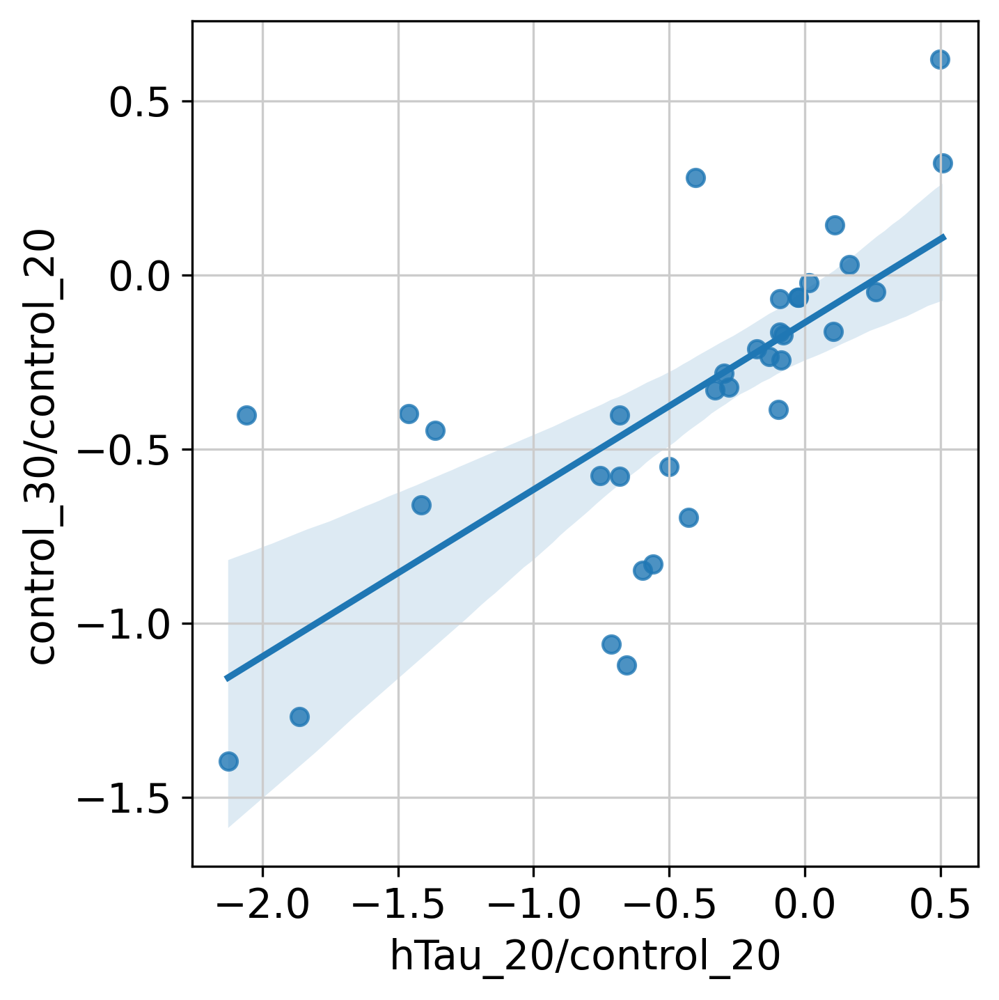

In [70]:
with rc_context({'figure.figsize': (5, 5)}):
    g = sns.regplot(x="hTau_20/control_20", y="control_30/control_20", data=umiN_mtx_body)
    # g = sns.lmplot(x="hTau_20/control_20", y="control_30/control_20", data=umiN_mtx_body)
    r, p = stats.pearsonr(umiN_mtx_body["hTau_20/control_20"], umiN_mtx_body['control_30/control_20'])

    # g.text(.02, .95, f'r={r:.2f}, p={p:.2g}', transform=g.transAxes) #  

    # texts = [plt.text(x=umiN_mtx_body['hTau_20/control_20'][n], y=umiN_mtx_body['control_30/control_20'][n], s=umiN_mtx_body.index[n], fontsize=5) 
    #          for n, cellType in enumerate(umiN_mtx_body.index) 
    #          if cellType in ['enterocyte of posterior adult midgut epithelium', 'choriogenic main body follicle cell and corpus luteum', 'adult fat body_body']]
    # adjust_text(texts, )
    plt.tight_layout()
    plt.savefig(f'{figure4PicFolder}/regression_umiN_mtx_body_correlation_noLabel.pdf', bbox_inches='tight')

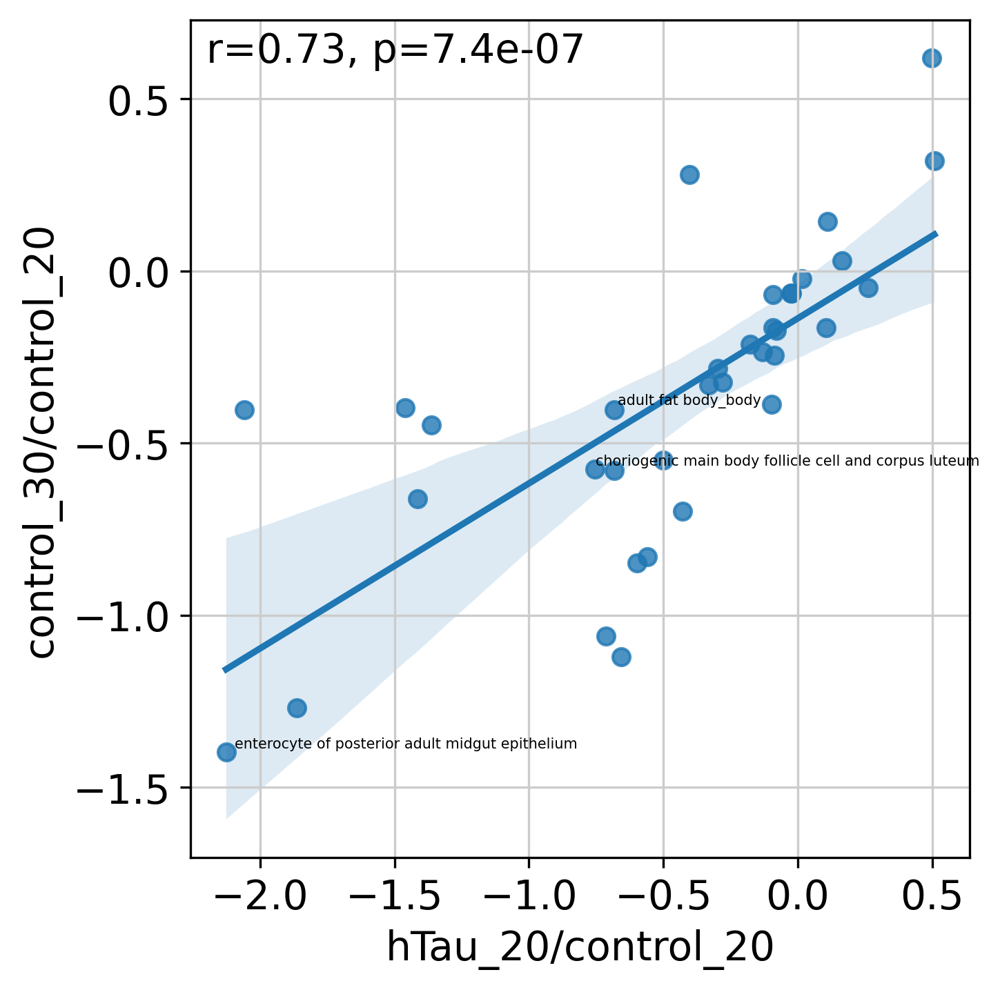

In [71]:
with rc_context({'figure.figsize': (5, 5)}):
    g = sns.regplot(x="hTau_20/control_20", y="control_30/control_20", data=umiN_mtx_body)
    # g = sns.lmplot(x="hTau_20/control_20", y="control_30/control_20", data=umiN_mtx_body)
    r, p = stats.pearsonr(umiN_mtx_body["hTau_20/control_20"], umiN_mtx_body['control_30/control_20'])

    g.text(.02, .95, f'r={r:.2f}, p={p:.2g}', transform=g.transAxes) #  
    # g.text(.02, .95, f'r2={r ** 2:.2f}, p={p:.2g}', transform=g.transAxes) # 


    texts = [plt.text(x=umiN_mtx_body['hTau_20/control_20'][n], y=umiN_mtx_body['control_30/control_20'][n], s=umiN_mtx_body.index[n], fontsize=5) 
             for n, cellType in enumerate(umiN_mtx_body.index) 
             if cellType in ['enterocyte of posterior adult midgut epithelium', 'choriogenic main body follicle cell and corpus luteum', 'adult fat body_body']]
    adjust_text(texts, )
    plt.tight_layout()
    plt.savefig(f'{figure4PicFolder}/regression_umiN_mtx_body_correlation.pdf', bbox_inches='tight')

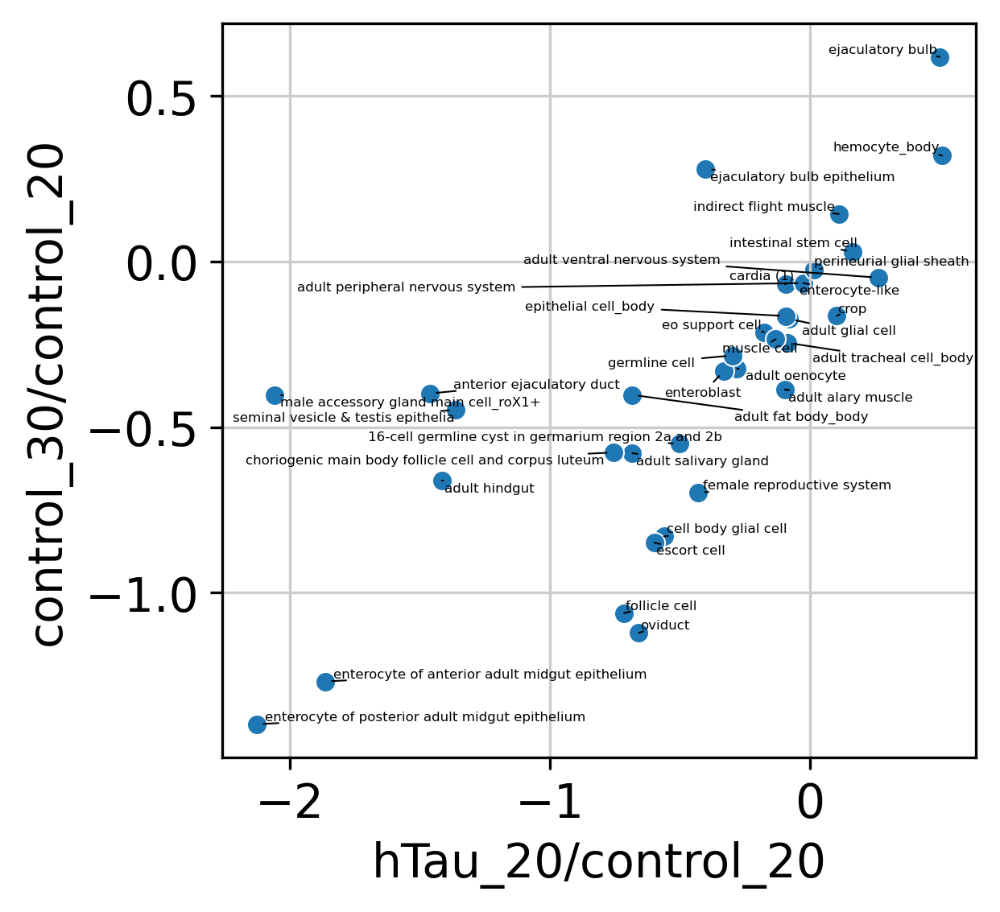

In [85]:
sns.scatterplot(data=umiN_mtx_body, x="hTau_20/control_20", y="control_30/control_20")
texts = [plt.text(x=umiN_mtx_body['hTau_20/control_20'][n], y=umiN_mtx_body['control_30/control_20'][n], s=umiN_mtx_body.index[n], fontsize=4) 
         for n, cellType in enumerate(umiN_mtx_body.index)]
adjust_text(texts, arrowprops=dict(arrowstyle="-", color='k', lw=0.5) ) # arrowprops=dict(arrowstyle='->', color='red') # arrowprops=dict(arrowstyle="-", color='k', lw=0.5)
plt.show()

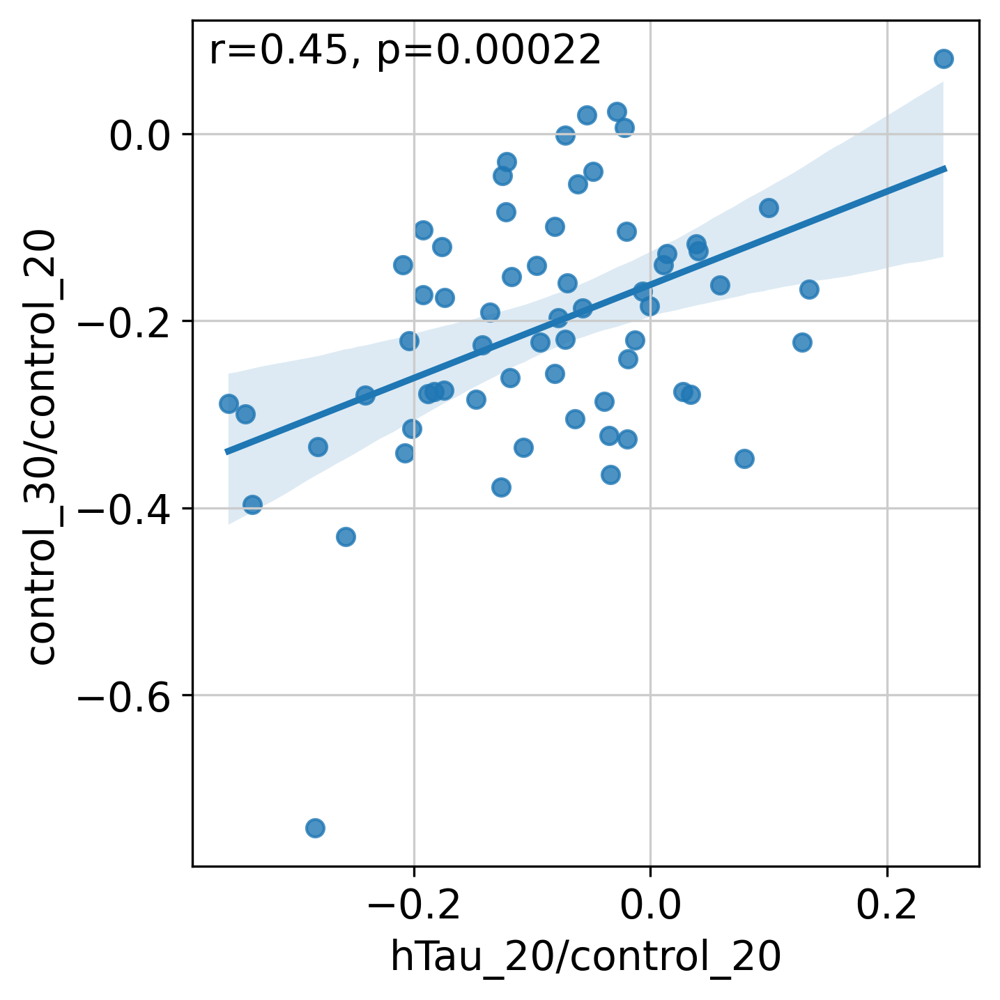

In [74]:
### head correlation

with rc_context({'figure.figsize': (5, 5)}):
    g = sns.regplot(x="hTau_20/control_20", y="control_30/control_20", data=umiN_mtx_head)
    # g = sns.lmplot(x="hTau_20/control_20", y="control_30/control_20", data=umiN_mtx_head)
    r, p = stats.pearsonr(umiN_mtx_head["hTau_20/control_20"], umiN_mtx_head['control_30/control_20'])

    g.text(.02, .95, f'r={r:.2f}, p={p:.2g}', transform=g.transAxes) #  

    # texts = [plt.text(x=umiN_mtx_head['hTau_20/control_20'][n], y=umiN_mtx_head['control_30/control_20'][n], s=umiN_mtx_head.index[n], fontsize=5) 
    #          for n, cellType in enumerate(umiN_mtx_head.index) 
    #          if cellType in ['enterocyte of posterior adult midgut epithelium', 'choriogenic main body follicle cell and corpus luteum', 'adult fat body_body']]
    # adjust_text(texts, )
    plt.tight_layout()
    plt.savefig(f'{figure4PicFolder}/regression_umiN_mtx_head_correlation_noLabel.pdf', bbox_inches='tight')

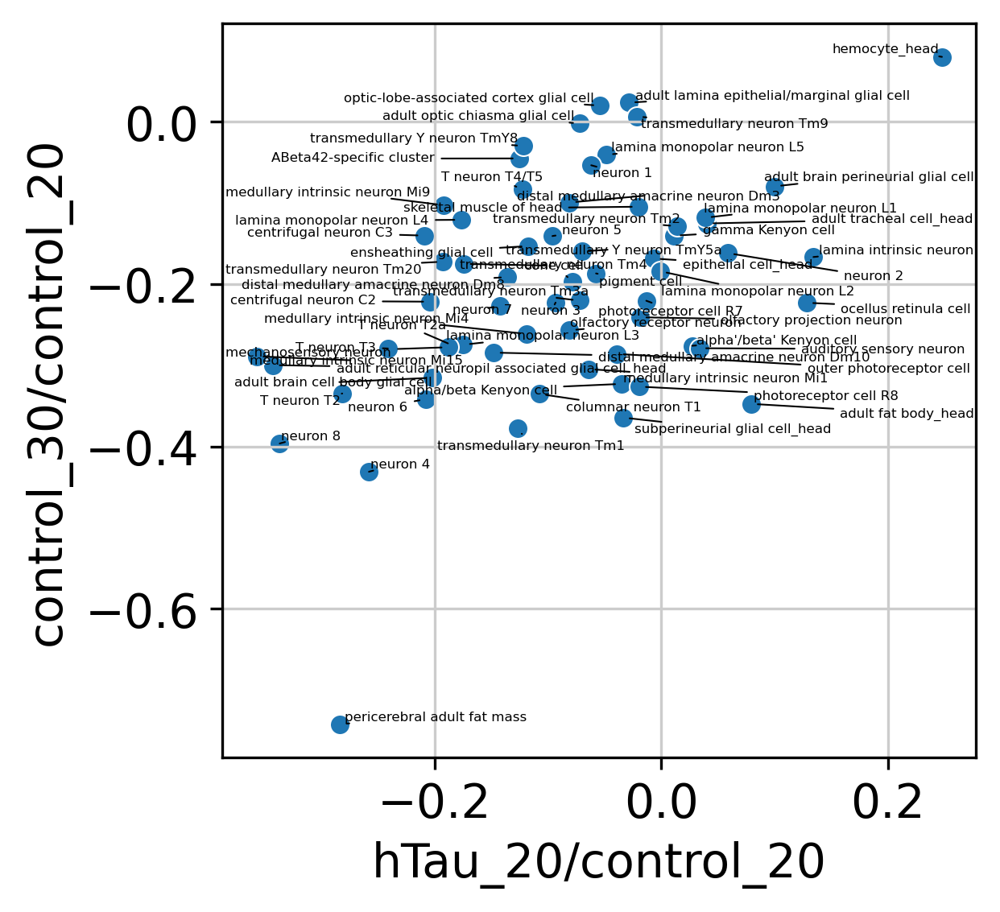

In [76]:
sns.scatterplot(data=umiN_mtx_head, x="hTau_20/control_20", y="control_30/control_20")
texts = [plt.text(x=umiN_mtx_head['hTau_20/control_20'][n], y=umiN_mtx_head['control_30/control_20'][n], s=umiN_mtx_head.index[n], fontsize=4) 
         for n, cellType in enumerate(umiN_mtx_head.index)]
adjust_text(texts, arrowprops=dict(arrowstyle="-", color='k', lw=0.5) ) # arrowprops=dict(arrowstyle='->', color='red') # arrowprops=dict(arrowstyle="-", color='k', lw=0.5)
plt.show()

### Plot pairwise geneN correlation

In [91]:
from scipy.stats import pearsonr
from scipy import stats

In [79]:
geneN_mtx_head = pd.read_csv(f'{geneNumFolder}/geneN_mtx_head.csv', index_col=0)
geneN_mtx_body = pd.read_csv(f'{geneNumFolder}/geneN_mtx_body.csv', index_col=0)
geneN_mtx_head

,AB42_10/control_10,AB42_20/control_20,control_20/control_10,control_30/control_20,hTau_20/control_20,hTau_30/control_30
ABeta42-specific cluster,0.451258,0.424439,-0.151701,-0.064816,-0.119507,-0.094583
T neuron T2,0.032892,-0.085247,0.032892,-0.292301,-0.237250,0.016200
T neuron T2a,0.020780,-0.002953,0.019306,-0.263034,-0.188857,-0.010660
T neuron T3,0.083861,0.043172,0.037290,-0.250120,-0.196909,0.049188
T neuron T4/T5,0.054862,-0.076816,0.065588,-0.076816,-0.114884,-0.011315
...,...,...,...,...,...,...
transmedullary neuron Tm2,0.131128,0.265590,-0.189572,-0.072386,0.003066,-0.014597
transmedullary neuron Tm20,0.116758,-0.035785,0.052348,-0.141687,-0.155936,-0.046833
transmedullary neuron Tm3a,0.095839,0.018034,-0.053439,-0.202617,-0.103430,0.042864
transmedullary neuron Tm4,0.054340,0.037243,-0.050418,-0.172946,-0.161086,-0.039670


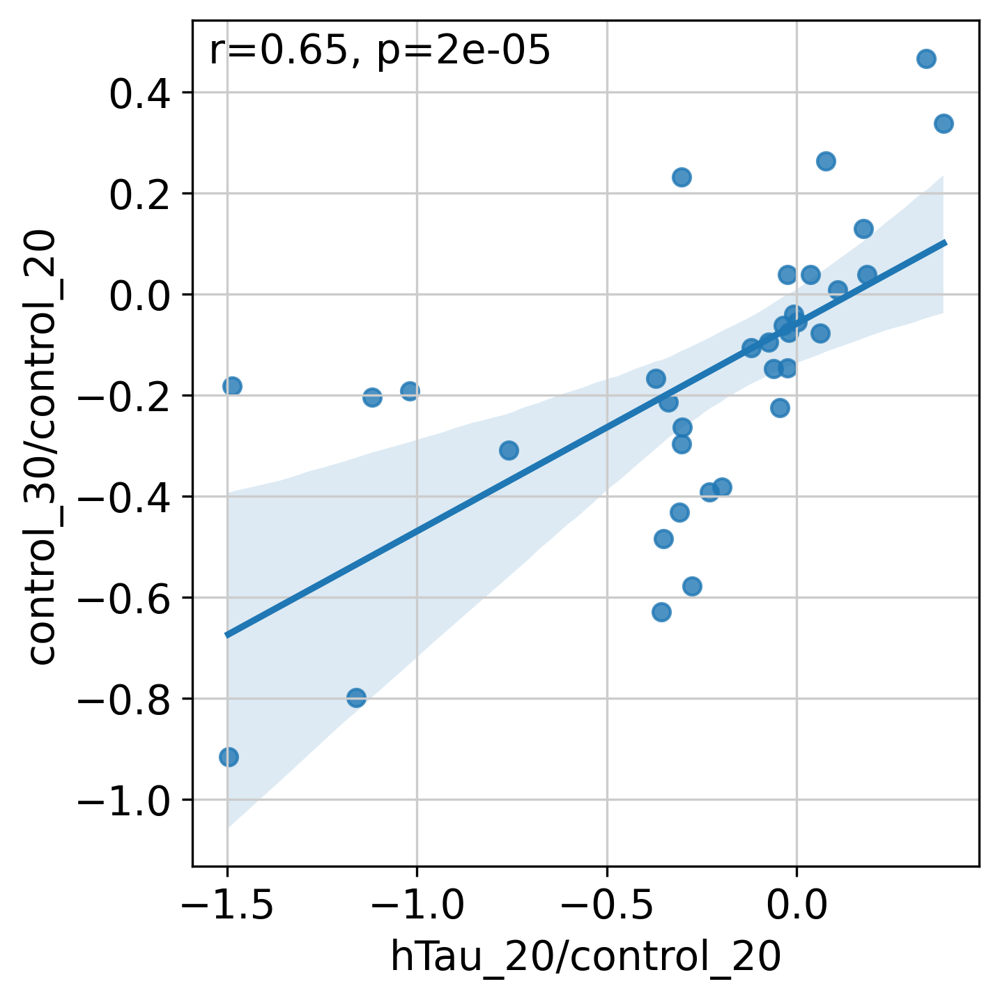

In [80]:
### body geneN
with rc_context({'figure.figsize': (5, 5)}):
    g = sns.regplot(x="hTau_20/control_20", y="control_30/control_20", data=geneN_mtx_body)
    # g = sns.lmplot(x="hTau_20/control_20", y="control_30/control_20", data=geneN_mtx_body)
    r, p = stats.pearsonr(geneN_mtx_body["hTau_20/control_20"], geneN_mtx_body['control_30/control_20'])

    g.text(.02, .95, f'r={r:.2f}, p={p:.2g}', transform=g.transAxes) #  

    # texts = [plt.text(x=geneN_mtx_body['hTau_20/control_20'][n], y=geneN_mtx_body['control_30/control_20'][n], s=geneN_mtx_body.index[n], fontsize=5) 
    #          for n, cellType in enumerate(geneN_mtx_body.index) 
    #          if cellType in ['enterocyte of posterior adult midgut epithelium', 'choriogenic main body follicle cell and corpus luteum', 'adult fat body_body']]
    # adjust_text(texts, )
    plt.tight_layout()
    plt.savefig(f'{figure4PicFolder}/regression_geneN_mtx_body_correlation_noLabel.pdf', bbox_inches='tight')

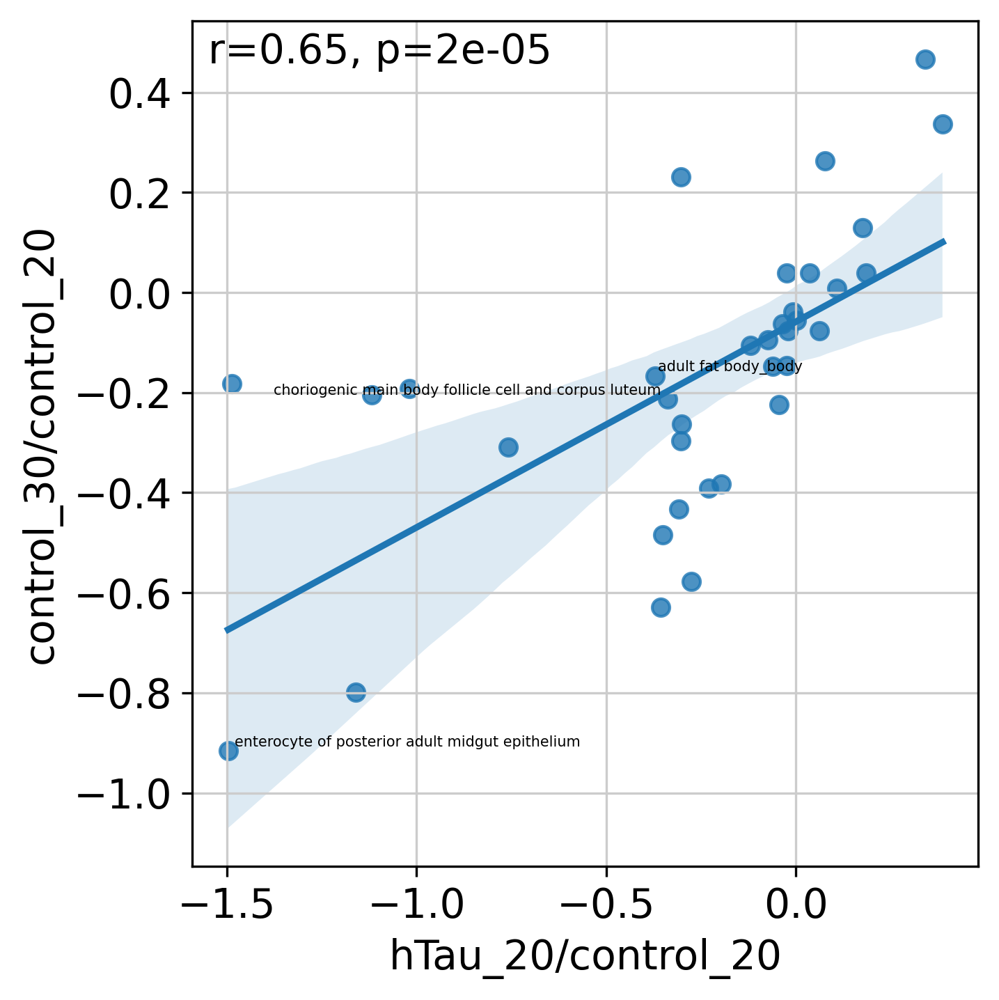

In [81]:
### body geneN with three annotations
with rc_context({'figure.figsize': (5, 5)}):
    g = sns.regplot(x="hTau_20/control_20", y="control_30/control_20", data=geneN_mtx_body)
    # g = sns.lmplot(x="hTau_20/control_20", y="control_30/control_20", data=geneN_mtx_body)
    r, p = stats.pearsonr(geneN_mtx_body["hTau_20/control_20"], geneN_mtx_body['control_30/control_20'])

    g.text(.02, .95, f'r={r:.2f}, p={p:.2g}', transform=g.transAxes) #  
    # g.text(.02, .95, f'r2={r ** 2:.2f}, p={p:.2g}', transform=g.transAxes) # 


    texts = [plt.text(x=geneN_mtx_body['hTau_20/control_20'][n], y=geneN_mtx_body['control_30/control_20'][n], s=geneN_mtx_body.index[n], fontsize=5) 
             for n, cellType in enumerate(geneN_mtx_body.index) 
             if cellType in ['enterocyte of posterior adult midgut epithelium', 'choriogenic main body follicle cell and corpus luteum', 'adult fat body_body']]
    adjust_text(texts, )
    plt.tight_layout()
    plt.savefig(f'{figure4PicFolder}/regression_geneN_mtx_body_correlation.pdf', bbox_inches='tight')

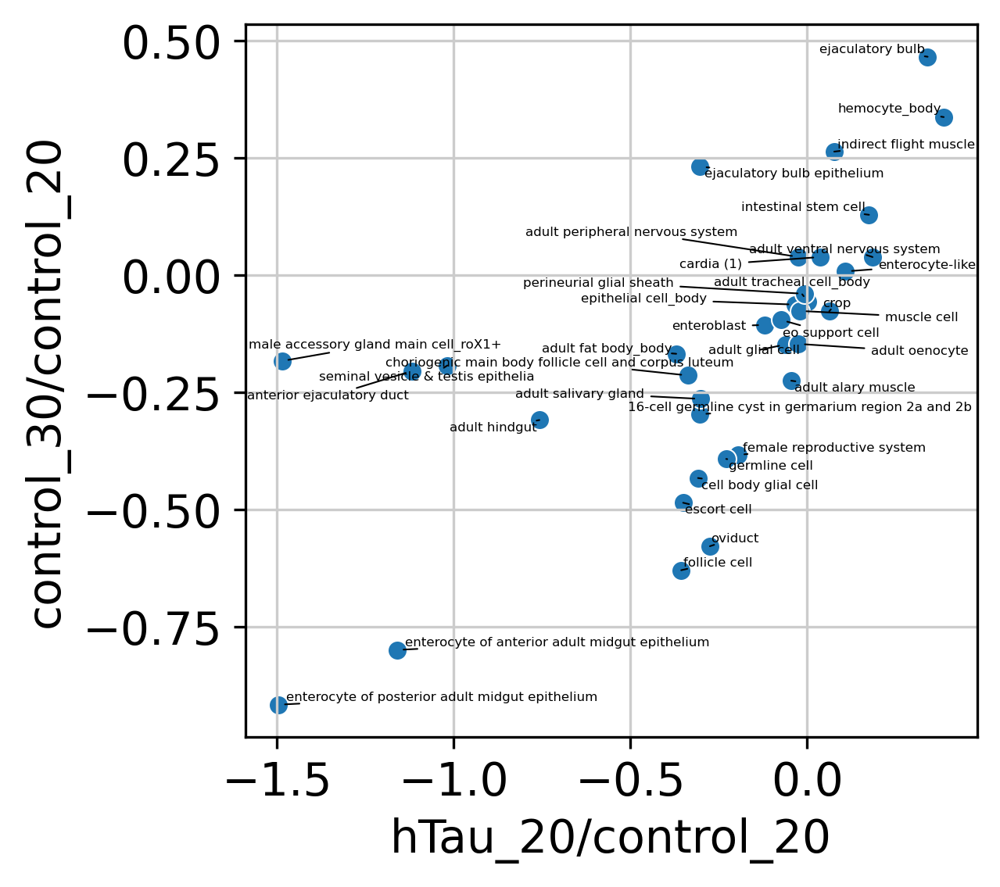

In [82]:
sns.scatterplot(data=geneN_mtx_body, x="hTau_20/control_20", y="control_30/control_20")
texts = [plt.text(x=geneN_mtx_body['hTau_20/control_20'][n], y=geneN_mtx_body['control_30/control_20'][n], s=geneN_mtx_body.index[n], fontsize=4) 
         for n, cellType in enumerate(geneN_mtx_body.index)]
adjust_text(texts, arrowprops=dict(arrowstyle="-", color='k', lw=0.5) ) # arrowprops=dict(arrowstyle='->', color='red') # arrowprops=dict(arrowstyle="-", color='k', lw=0.5)
plt.show()

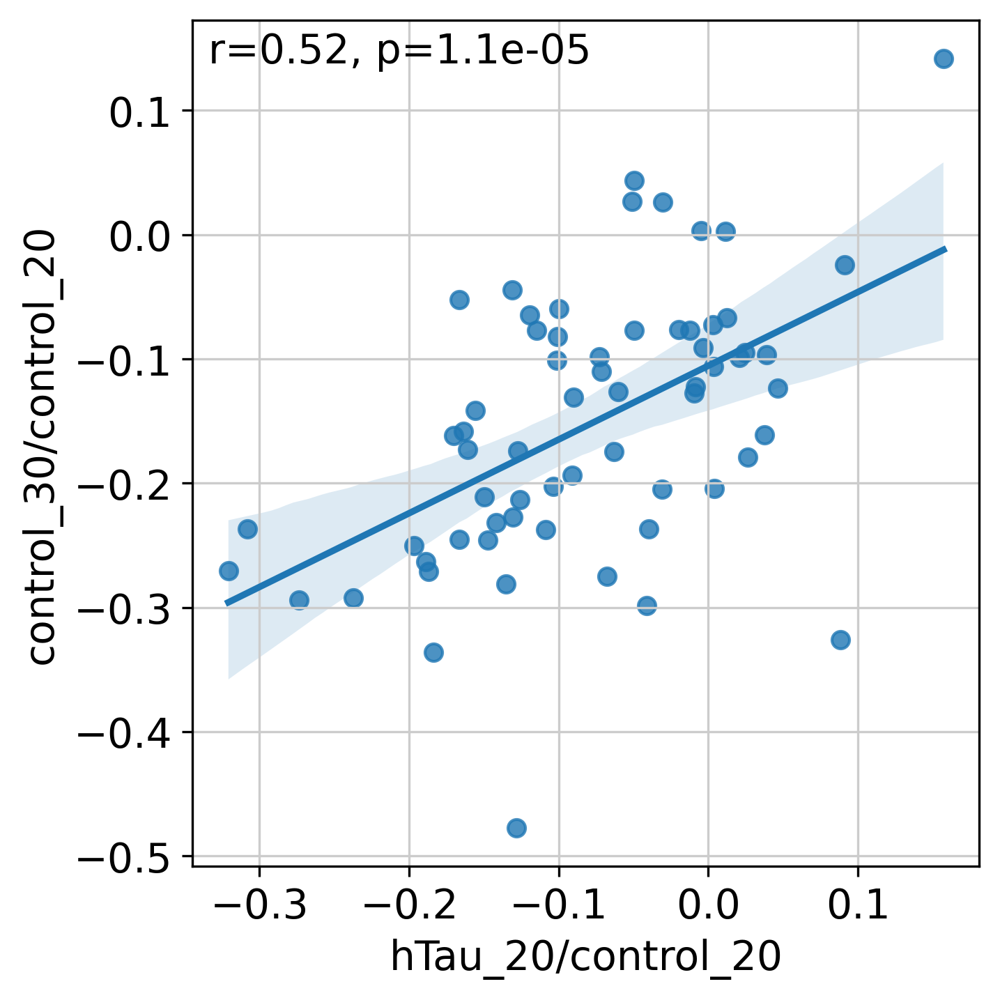

In [83]:
### head correlation

with rc_context({'figure.figsize': (5, 5)}):
    g = sns.regplot(x="hTau_20/control_20", y="control_30/control_20", data=geneN_mtx_head)
    # g = sns.lmplot(x="hTau_20/control_20", y="control_30/control_20", data=geneN_mtx_head)
    r, p = stats.pearsonr(geneN_mtx_head["hTau_20/control_20"], geneN_mtx_head['control_30/control_20'])

    g.text(.02, .95, f'r={r:.2f}, p={p:.2g}', transform=g.transAxes) #  

    # texts = [plt.text(x=geneN_mtx_head['hTau_20/control_20'][n], y=geneN_mtx_head['control_30/control_20'][n], s=geneN_mtx_head.index[n], fontsize=5) 
    #          for n, cellType in enumerate(geneN_mtx_head.index) 
    #          if cellType in ['enterocyte of posterior adult midgut epithelium', 'choriogenic main body follicle cell and corpus luteum', 'adult fat body_body']]
    # adjust_text(texts, )
    plt.tight_layout()
    plt.savefig(f'{figure4PicFolder}/regression_geneN_mtx_head_correlation_noLabel.pdf', bbox_inches='tight')

# Fig 5C: UMI#/gene# correlation

### geneN correlation

In [45]:
geneN_Df = pd.read_csv(f'{geneNumFolder}/geneNum_genoAgeCompareName.csv')
geneN_sort_Df = pd.read_csv(f'{geneNumFolder}/geneN_sort_Df_genoAgeCompare_wilcoxon.csv')
geneN_sort_Df

,genoAgeCompare,annotation,ratioType,log2Ratio,ranksumsTwoSides_stat,ranksumsTwoSides_pvalue,ranksumsGreater_stat,ranksumsGreater_pvalue,ranksumsLess_stat,ranksumsLess_pvalue
0,hTau_20/control_20,hemocyte_body,genenLog2Ratio,0.386481,13.802174,2.472802e-43,13.802174,1.236401e-43,13.802174,1.000000e+00
1,hTau_20/control_20,ejaculatory bulb,genenLog2Ratio,0.340979,6.727306,1.728336e-11,6.727306,8.641681e-12,6.727306,1.000000e+00
2,hTau_20/control_20,adult ventral nervous system,genenLog2Ratio,0.185075,9.276021,1.759253e-20,9.276021,8.796264e-21,9.276021,1.000000e+00
3,hTau_20/control_20,intestinal stem cell,genenLog2Ratio,0.175012,5.037615,4.713694e-07,5.037615,2.356847e-07,5.037615,9.999998e-01
4,hTau_20/control_20,hemocyte_head,genenLog2Ratio,0.157135,8.031052,9.664037e-16,8.031052,4.832019e-16,8.031052,1.000000e+00
...,...,...,...,...,...,...,...,...,...,...
1219,control_20/control_10,seminal vesicle & testis epithelia,umiLog2Ratio,-0.066939,-1.419655,1.557081e-01,-1.419655,9.221460e-01,-1.419655,7.785404e-02
1220,control_20/control_10,anterior ejaculatory duct,umiLog2Ratio,-0.596953,-8.198830,2.427389e-16,-8.198830,1.000000e+00,-8.198830,1.213694e-16
1221,control_20/control_10,enterocyte of anterior adult midgut epithelium,umiLog2Ratio,-0.256904,-0.884019,3.766860e-01,-0.884019,8.116570e-01,-0.884019,1.883430e-01
1222,control_20/control_10,male accessory gland main cell_roX1+,umiLog2Ratio,-0.012971,-0.489433,6.245353e-01,-0.489433,6.877324e-01,-0.489433,3.122676e-01


In [46]:
geneN_sort_Df.head()

,genoAgeCompare,annotation,ratioType,log2Ratio,ranksumsTwoSides_stat,ranksumsTwoSides_pvalue,ranksumsGreater_stat,ranksumsGreater_pvalue,ranksumsLess_stat,ranksumsLess_pvalue
0,hTau_20/control_20,hemocyte_body,genenLog2Ratio,0.386481,13.802174,2.472802e-43,13.802174,1.236401e-43,13.802174,1.0
1,hTau_20/control_20,ejaculatory bulb,genenLog2Ratio,0.340979,6.727306,1.728336e-11,6.727306,8.641681e-12,6.727306,1.0
2,hTau_20/control_20,adult ventral nervous system,genenLog2Ratio,0.185075,9.276021,1.759253e-20,9.276021,8.796264e-21,9.276021,1.0
3,hTau_20/control_20,intestinal stem cell,genenLog2Ratio,0.175012,5.037615,4.713694e-07,5.037615,2.356847e-07,5.037615,1.0
4,hTau_20/control_20,hemocyte_head,genenLog2Ratio,0.157135,8.031052,9.664037e-16,8.031052,4.832019e-16,8.031052,1.0


In [47]:
geneN_mtx = geneN_sort_Df[geneN_sort_Df.ratioType == 'genenLog2Ratio'].loc[:,['genoAgeCompare','annotation','log2Ratio']].pivot(index='annotation', columns='genoAgeCompare') #
geneN_mtx.index.name = None
geneN_mtx.columns = [colIndex[1] for colIndex in geneN_mtx.columns.to_list()]
geneN_mtx

,AB42_10/control_10,AB42_20/control_20,control_20/control_10,control_30/control_20,hTau_20/control_20,hTau_30/control_30
16-cell germline cyst in germarium region 2a and 2b,-0.113751,0.069348,0.065684,-0.296201,-0.303770,-0.102534
ABeta42-specific cluster,0.447278,0.470179,-0.200819,-0.015699,-0.070389,-0.094583
T neuron T2,0.032892,-0.080806,0.028451,-0.275244,-0.232809,0.003584
T neuron T2a,0.022276,0.000000,0.017848,-0.263626,-0.189270,-0.008900
T neuron T3,0.083861,0.051963,0.028499,-0.241329,-0.186109,0.049188
...,...,...,...,...,...,...
transmedullary neuron Tm2,0.131128,0.265590,-0.189572,-0.069162,0.003066,-0.016192
transmedullary neuron Tm20,0.116758,-0.035785,0.052348,-0.141687,-0.154147,-0.046833
transmedullary neuron Tm3a,0.097297,0.025509,-0.053494,-0.208082,-0.100293,0.049842
transmedullary neuron Tm4,0.057257,0.037243,-0.047500,-0.172946,-0.162775,-0.039670


In [48]:
geneN_mtx_head = geneN_mtx[geneN_mtx.index.isin(adata_head.obs.adfca_annotation.cat.categories)]
geneN_mtx_body = geneN_mtx[geneN_mtx.index.isin(adata_body.obs.adfca_annotation.cat.categories)]

In [49]:
geneN_mtx_head.to_csv(f'{geneNumFolder}/geneN_mtx_head.csv')
geneN_mtx_body.to_csv(f'{geneNumFolder}/geneN_mtx_body.csv')

In [50]:
### body geneN correlation
corr = geneN_mtx_body.corr(method = 'spearman').round(2)
corr

,AB42_10/control_10,AB42_20/control_20,control_20/control_10,control_30/control_20,hTau_20/control_20,hTau_30/control_30
AB42_10/control_10,1.00,0.08,0.15,0.50,0.13,-0.31
AB42_20/control_20,0.08,1.00,-0.10,0.27,0.28,-0.02
control_20/control_10,0.15,-0.10,1.00,-0.02,-0.04,0.27
control_30/control_20,0.50,0.27,-0.02,1.00,0.79,0.07
hTau_20/control_20,0.13,0.28,-0.04,0.79,1.00,0.35
hTau_30/control_30,-0.31,-0.02,0.27,0.07,0.35,1.00


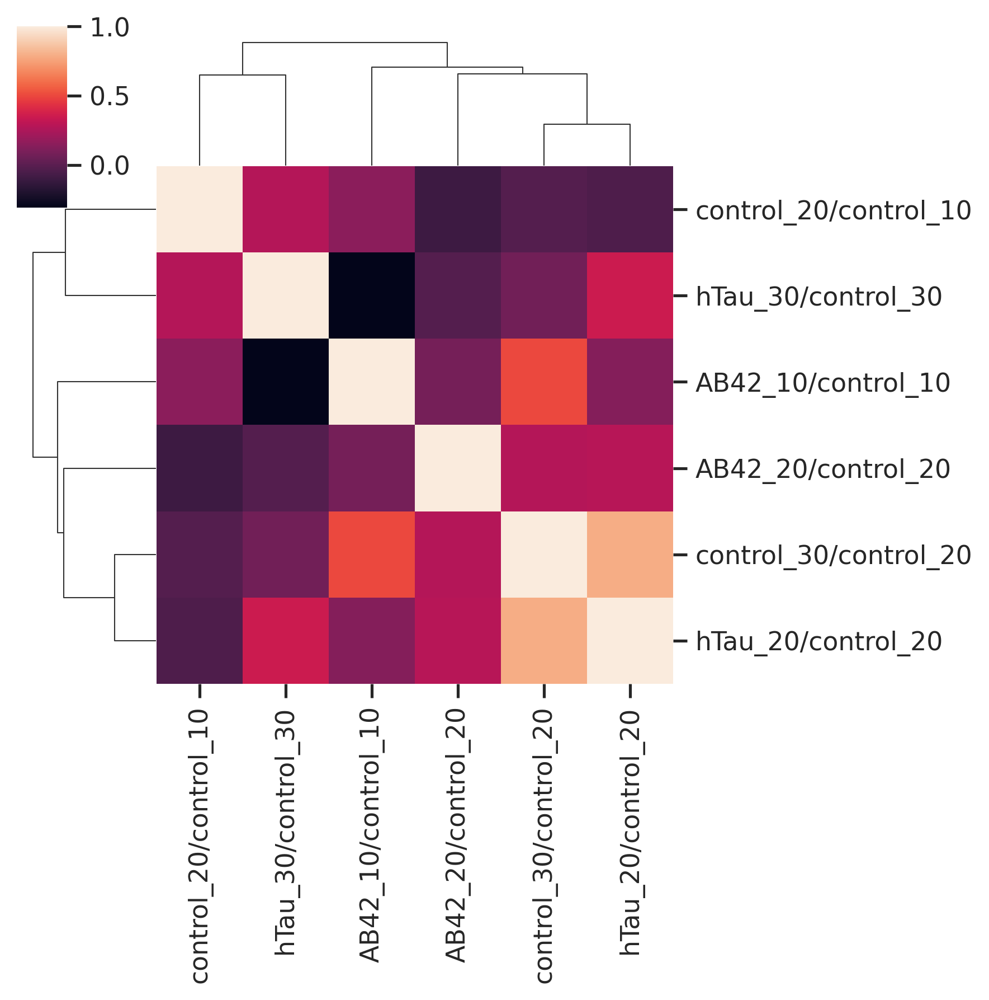

In [51]:
sns.clustermap(corr, figsize=(6, 6), annot=False)
plt.savefig(f'{figure4PicFolder}/heatmap_geneN_mtx_body_geneN.pdf', bbox_inches='tight')
plt.show()

In [52]:
### geneN_mtx_head correlation
corr = geneN_mtx_head.corr(method = 'spearman').round(2)
corr

,AB42_10/control_10,AB42_20/control_20,control_20/control_10,control_30/control_20,hTau_20/control_20,hTau_30/control_30
AB42_10/control_10,1.00,0.33,0.10,0.05,-0.04,-0.09
AB42_20/control_20,0.33,1.00,-0.60,0.31,0.64,0.15
control_20/control_10,0.10,-0.60,1.00,-0.05,-0.60,-0.24
control_30/control_20,0.05,0.31,-0.05,1.00,0.52,-0.36
hTau_20/control_20,-0.04,0.64,-0.60,0.52,1.00,0.17
hTau_30/control_30,-0.09,0.15,-0.24,-0.36,0.17,1.00


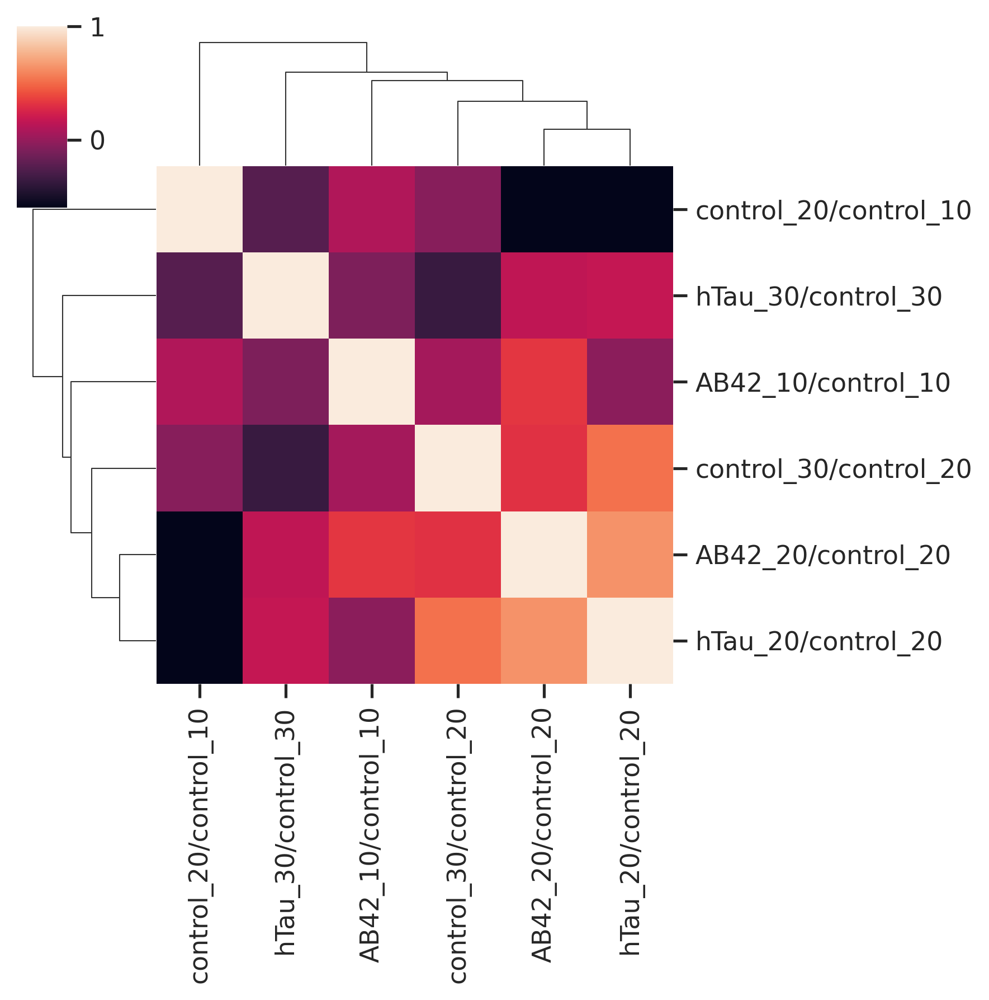

In [53]:
sns.clustermap(corr, figsize=(6, 6), annot=False)
plt.savefig(f'{figure4PicFolder}/heatmap_geneN_mtx_head_geneN.pdf', bbox_inches='tight')
plt.show()

### umi# correlation

In [54]:
geneN_Df = pd.read_csv(f'{geneNumFolder}/geneNum_genoAgeCompareName.csv')
geneN_sort_Df = pd.read_csv(f'{geneNumFolder}/geneN_sort_Df_genoAgeCompare_wilcoxon.csv')
geneN_sort_Df

,genoAgeCompare,annotation,ratioType,log2Ratio,ranksumsTwoSides_stat,ranksumsTwoSides_pvalue,ranksumsGreater_stat,ranksumsGreater_pvalue,ranksumsLess_stat,ranksumsLess_pvalue
0,hTau_20/control_20,hemocyte_body,genenLog2Ratio,0.386481,13.802174,2.472802e-43,13.802174,1.236401e-43,13.802174,1.000000e+00
1,hTau_20/control_20,ejaculatory bulb,genenLog2Ratio,0.340979,6.727306,1.728336e-11,6.727306,8.641681e-12,6.727306,1.000000e+00
2,hTau_20/control_20,adult ventral nervous system,genenLog2Ratio,0.185075,9.276021,1.759253e-20,9.276021,8.796264e-21,9.276021,1.000000e+00
3,hTau_20/control_20,intestinal stem cell,genenLog2Ratio,0.175012,5.037615,4.713694e-07,5.037615,2.356847e-07,5.037615,9.999998e-01
4,hTau_20/control_20,hemocyte_head,genenLog2Ratio,0.157135,8.031052,9.664037e-16,8.031052,4.832019e-16,8.031052,1.000000e+00
...,...,...,...,...,...,...,...,...,...,...
1219,control_20/control_10,seminal vesicle & testis epithelia,umiLog2Ratio,-0.066939,-1.419655,1.557081e-01,-1.419655,9.221460e-01,-1.419655,7.785404e-02
1220,control_20/control_10,anterior ejaculatory duct,umiLog2Ratio,-0.596953,-8.198830,2.427389e-16,-8.198830,1.000000e+00,-8.198830,1.213694e-16
1221,control_20/control_10,enterocyte of anterior adult midgut epithelium,umiLog2Ratio,-0.256904,-0.884019,3.766860e-01,-0.884019,8.116570e-01,-0.884019,1.883430e-01
1222,control_20/control_10,male accessory gland main cell_roX1+,umiLog2Ratio,-0.012971,-0.489433,6.245353e-01,-0.489433,6.877324e-01,-0.489433,3.122676e-01


In [55]:
geneN_Df

,genoAgeCompare,annotation,medGeneNum_exp,medGeneNum_ref,medUmiNum_exp,medUmiNum_ref,genenRatio,genenLog2Ratio,umiRatio,umiLog2Ratio
0,hTau_20/control_20,16-cell germline cyst in germarium region 2a a...,855.5,1056.0,1624.5,2300.0,0.810133,-0.303770,0.706304,-0.501638
1,hTau_20/control_20,ABeta42-specific cluster,440.0,462.0,731.0,782.5,0.952381,-0.070389,0.934185,-0.098219
2,hTau_20/control_20,T neuron T2,414.0,486.5,731.0,883.5,0.850976,-0.232809,0.827391,-0.273359
3,hTau_20/control_20,T neuron T2a,428.0,488.0,730.5,818.0,0.877049,-0.189270,0.893032,-0.163217
4,hTau_20/control_20,T neuron T3,359.5,409.0,632.0,742.0,0.878973,-0.186109,0.851752,-0.231495
...,...,...,...,...,...,...,...,...,...,...
607,control_20/control_10,transmedullary neuron Tm2,470.0,536.0,827.0,1017.0,0.876866,-0.189572,0.813176,-0.298360
608,control_20/control_10,transmedullary neuron Tm20,449.0,433.0,737.0,706.0,1.036952,0.052348,1.043909,0.061996
609,control_20/control_10,transmedullary neuron Tm3a,476.5,494.5,819.0,898.0,0.963600,-0.053494,0.912027,-0.132852
610,control_20/control_10,transmedullary neuron Tm4,478.0,494.0,819.0,887.0,0.967611,-0.047500,0.923337,-0.115071


In [56]:
umiN_mtx = geneN_sort_Df[geneN_sort_Df.ratioType == 'umiLog2Ratio'].loc[:,['genoAgeCompare','annotation','log2Ratio']].pivot(index='annotation', columns='genoAgeCompare') #
umiN_mtx.index.name = None
umiN_mtx.columns = [colIndex[1] for colIndex in umiN_mtx.columns.to_list()]
umiN_mtx

,AB42_10/control_10,AB42_20/control_20,control_20/control_10,control_30/control_20,hTau_20/control_20,hTau_30/control_30
16-cell germline cyst in germarium region 2a and 2b,-0.171390,0.171875,0.093277,-0.549951,-0.501638,-0.006443
ABeta42-specific cluster,0.568474,0.669983,-0.306916,-0.030746,-0.098219,-0.099401
T neuron T2,0.031467,0.044221,-0.037872,-0.325607,-0.273359,-0.010268
T neuron T2a,0.091527,0.163247,-0.063824,-0.254944,-0.163217,0.012573
T neuron T3,0.144576,0.142444,0.003894,-0.269660,-0.231495,0.012834
...,...,...,...,...,...,...
transmedullary neuron Tm2,0.159643,0.401014,-0.298360,-0.118096,0.025933,-0.003792
transmedullary neuron Tm20,0.175816,0.042435,0.061996,-0.172374,-0.189014,-0.057378
transmedullary neuron Tm3a,0.117206,0.111814,-0.132852,-0.227539,-0.069465,0.033636
transmedullary neuron Tm4,0.098993,0.144851,-0.115071,-0.183864,-0.191890,-0.066543


In [57]:
umiN_mtx_head = umiN_mtx[umiN_mtx.index.isin(adata_head.obs.adfca_annotation.cat.categories)]
umiN_mtx_body = umiN_mtx[umiN_mtx.index.isin(adata_body.obs.adfca_annotation.cat.categories)]

In [58]:
umiN_mtx_head.to_csv(f'{geneNumFolder}/umiN_mtx_head.csv')
umiN_mtx_body.to_csv(f'{geneNumFolder}/umiN_mtx_body.csv')

In [59]:
### body correlation
corr = umiN_mtx_body.corr(method = 'spearman').round(2)
corr

,AB42_10/control_10,AB42_20/control_20,control_20/control_10,control_30/control_20,hTau_20/control_20,hTau_30/control_30
AB42_10/control_10,1.00,0.20,-0.01,0.52,0.26,-0.25
AB42_20/control_20,0.20,1.00,0.08,0.27,0.31,0.01
control_20/control_10,-0.01,0.08,1.00,-0.10,0.04,0.38
control_30/control_20,0.52,0.27,-0.10,1.00,0.86,0.00
hTau_20/control_20,0.26,0.31,0.04,0.86,1.00,0.30
hTau_30/control_30,-0.25,0.01,0.38,0.00,0.30,1.00


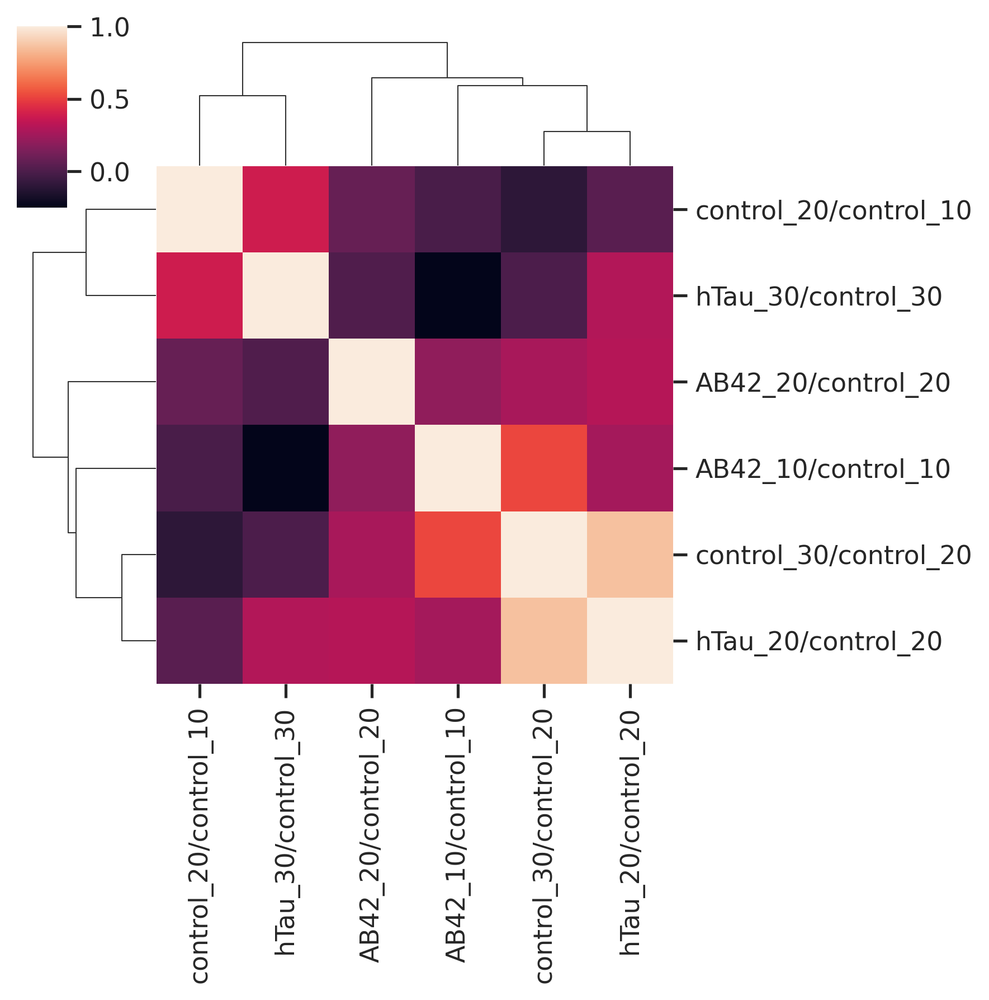

In [60]:
sns.clustermap(corr, figsize=(6, 6), annot=False)
# plt.tight_layout()
plt.savefig(f'{figure4PicFolder}/heatmap_umiN_mtx_body_correlation.pdf', bbox_inches='tight')
plt.show()

In [61]:
### head correlation
corr = umiN_mtx_head.corr(method = 'spearman').round(2)
corr

,AB42_10/control_10,AB42_20/control_20,control_20/control_10,control_30/control_20,hTau_20/control_20,hTau_30/control_30
AB42_10/control_10,1.00,0.36,-0.01,-0.08,-0.08,-0.10
AB42_20/control_20,0.36,1.00,-0.55,0.05,0.59,0.22
control_20/control_10,-0.01,-0.55,1.00,0.16,-0.54,-0.31
control_30/control_20,-0.08,0.05,0.16,1.00,0.36,-0.38
hTau_20/control_20,-0.08,0.59,-0.54,0.36,1.00,0.32
hTau_30/control_30,-0.10,0.22,-0.31,-0.38,0.32,1.00


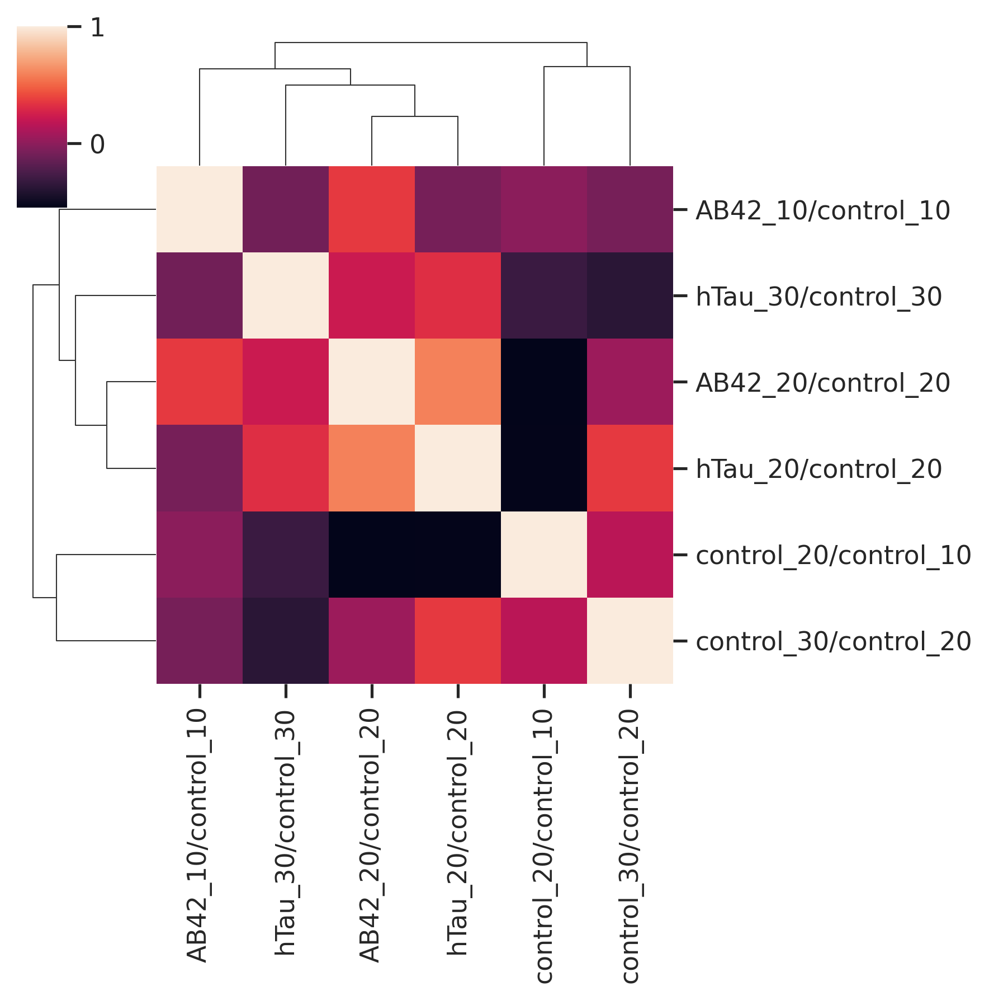

In [62]:
sns.clustermap(corr, figsize=(6, 6), annot=False)
plt.savefig(f'{figure4PicFolder}/heatmap_umiN_mtx_head_correlation.pdf', bbox_inches='tight')
plt.show()

# Fig 5D: correlation of Cell composition (compare between different genoAge groups)

## Load data

In [63]:
cellN_Df_head = pd.read_csv(f'{figure2Folder}/cellN/head_cellN_genotypeGroup.csv', index_col=0)
cellN_Df_body = pd.read_csv(f'{figure4Folder}/cellN/body_cellN_genotypeGroup.csv', index_col=0)

cellN_Df_body

,TotalCellN,control_10_CellN,control_20_CellN,control_30_CellN,AB42_10_CellN,AB42_20_CellN,hTau_20_CellN,hTau_30_CellN
follicle cell,39540,6925,6241,2511.0,9785.0,4314.0,7022,2742.0
adult fat body_body,36353,8340,7409,2536.0,10596.0,4514.0,1448,1510.0
muscle cell,26905,3942,2554,3162.0,3955.0,2145.0,8174,2973.0
epithelial cell_body,24734,3087,1743,3650.0,3254.0,1742.0,7841,3417.0
indirect flight muscle,20334,3260,2974,2151.0,3064.0,3387.0,4606,892.0
...,...,...,...,...,...,...,...,...
prefollicle cell/stalk follicle cell,59,5,8,5.0,8.0,3.0,21,9.0
adult Malpighian tubule principal cell of lower ureter,49,7,12,1.0,21.0,6.0,2,0.0
adult heart ventral longitudinal muscle,34,10,1,3.0,10.0,3.0,6,1.0
"cardiomyocyte, working adult heart muscle (non-ostia)",25,5,6,1.0,8.0,4.0,1,0.0


In [64]:
genoCompare_D = dict(zip(genoCompare_Df.expSet, genoCompare_Df.controlSet))
genoCompare_D

{'AB42': 'control_inAB42', 'hTau': 'control_inTau'}

In [30]:
# ageCompare_Df

,expSet,controlSet
0,control_20,control_10
1,control_30,control_20
2,AB42_20,AB42_10
3,hTau_30,hTau_20


In [66]:
genoCompare_Df

,expSet,controlSet,age
0,AB42,control_inAB42,"10,20"
1,hTau,control_inTau,"20,30"


In [70]:
genoAge_L[:2]

['control_10', 'control_20']

In [71]:
genoAge_ctlAge_Df = pd.DataFrame(columns=genoCompare_Df.columns[:2])
for n, expSet in enumerate(genoCompare_Df.expSet):
    age_L = genoCompare_Df.age[n].split(',')
    
    for age in age_L:
        genoAge_ctlAge_Df.loc[len(genoAge_ctlAge_Df)] = [f'{expSet}_{age}', f'control_{age}']

for n, genoAge in enumerate(genoAge_L[:2]):
    genoAge_ctlAge_Df.loc[len(genoAge_ctlAge_Df)] = [genoAge_L[n+1], f'{genoAge}']
genoAge_ctlAge_Df

,expSet,controlSet
0,AB42_10,control_10
1,AB42_20,control_20
2,hTau_20,control_20
3,hTau_30,control_30
4,control_20,control_10
5,control_30,control_20


In [72]:
genoAge_ctlAge_D = dict(zip(genoAge_ctlAge_Df.expSet, genoAge_ctlAge_Df.controlSet))
genoAge_ctlAge_D

{'AB42_10': 'control_10',
 'AB42_20': 'control_20',
 'hTau_20': 'control_20',
 'hTau_30': 'control_30',
 'control_20': 'control_10',
 'control_30': 'control_20'}

## Ratio (separated by genoAge)
Filter cell types with cellN <700

In [73]:
tissueCellN_D = {'head':cellN_Df_head, 'body': cellN_Df_body}
tissueRatio_D = {}

for tissue in tissueCellN_D.keys():
    print(f'tissue: {tissue}')

    ratioDf=pd.DataFrame(index=tissueCellN_D[tissue].index.to_list(), columns=[genoAge + '_ratio' for genoAge in genoAge_L])
    for genoAge in genoAge_L:
        print(genoAge)
        ratioDf[f'{genoAge}_ratio'] = ( tissueCellN_D[tissue][f'{genoAge}_CellN']/sum(tissueCellN_D[tissue][f'{genoAge}_CellN']) )
    ratioDf = ratioDf.sort_values(by=[f'{genoAge_L[0]}_ratio'])
    
    tissueRatio_D[tissue] = ratioDf
    print()

tissue: head
control_10
control_20
control_30
AB42_10
AB42_20
hTau_20
hTau_30

tissue: body
control_10
control_20
control_30
AB42_10
AB42_20
hTau_20
hTau_30



In [76]:
tissueRatio_D['body']

,control_10_ratio,control_20_ratio,control_30_ratio,AB42_10_ratio,AB42_20_ratio,hTau_20_ratio,hTau_30_ratio
adult differentiating enterocyte,0.000067,0.000505,0.000325,0.000208,0.000133,0.000235,0.000749
adult midgut enterocyte,0.000089,0.000319,0.000831,0.000113,0.000166,0.000320,0.000416
prefollicle cell/stalk follicle cell,0.000111,0.000213,0.000181,0.000151,0.000099,0.000448,0.000374
"cardiomyocyte, working adult heart muscle (non-ostia)",0.000111,0.000159,0.000036,0.000151,0.000133,0.000021,0.000000
adult Malpighian tubule principal cell of lower ureter,0.000155,0.000319,0.000036,0.000397,0.000199,0.000043,0.000000
...,...,...,...,...,...,...,...
epithelial cell_body,0.068527,0.046305,0.131869,0.061457,0.057713,0.167282,0.142091
indirect flight muscle,0.072367,0.079007,0.077712,0.057868,0.112212,0.098266,0.037092
muscle cell,0.087507,0.067850,0.114238,0.074696,0.071064,0.174386,0.123628
follicle cell,0.153725,0.165799,0.090719,0.184804,0.142923,0.149809,0.114022


## Relative ratio (normalize to control, separated by genoAge)
Filter cell types with cellN <700

### Summarize normalized ratio

In [78]:
tissueNorRatio_D = {}
tissueNorRatioNoLog2_D = {}
tissueNorRatio_long_D = {}

for tissue in tissueRatio_D.keys():
    print(f'tissue: {tissue}')

    normalRatio_Df=tissueRatio_D[tissue][:]
    # normalRatio_Df=normalRatio_Df.drop(['unannotated', 'uncharacterized CNS neuron'], axis=0)
    normalRatio_Df=normalRatio_Df[~normalRatio_Df.index.isin(['unannotated', 'uncharacterized CNS neuron'])]
    normalRatio_Df=normalRatio_Df[normalRatio_Df.index.isin(celltypeN700_L)]


    for expSet in genoAge_ctlAge_Df.expSet:
        controlSet = genoAge_ctlAge_D[expSet]
        normalRatio_Df[f'{expSet}/{controlSet}_ratio']=normalRatio_Df[f'{expSet}_ratio']/normalRatio_Df[f'{controlSet}_ratio']

    normalRatio_Df=normalRatio_Df.iloc[:,7:]
    normalRatioNoLog2_Df=normalRatio_Df[:]
    normalRatio_Df=np.log2(normalRatio_Df)

    normalRatioNoLog2_Df=normalRatioNoLog2_Df.sort_values(by=f'{genoAge_ctlAge_Df.iloc[0,0]}/{genoAge_ctlAge_Df.iloc[0,1]}_ratio', ascending=False)
    normalRatio_Df=normalRatio_Df.sort_values(by=f'{genoAge_ctlAge_Df.iloc[0,0]}/{genoAge_ctlAge_Df.iloc[0,1]}_ratio', ascending=False)

    normalRatio_Df.replace([np.inf, -np.inf], np.nan, inplace=True)
    normalRatioNoLog2_Df.replace([np.inf, -np.inf], np.nan, inplace=True)
    
    normalRatio_Df.insert(0, 'annotation', normalRatio_Df.index.to_list())
    normalRatio_longDf=normalRatio_Df.melt(id_vars=['annotation'], var_name='genoAgeCompare', value_name='log2ratio')
    normalRatio_longDf

    tissueNorRatio_D[tissue]  = normalRatio_Df
    tissueNorRatioNoLog2_D[tissue]  = normalRatioNoLog2_Df
    tissueNorRatio_long_D[tissue]  = normalRatio_longDf
    
    normalRatio_Df.to_csv(f'{cellnFig5Folder}/{tissue}_normalRatio_Df.csv')
    normalRatio_longDf.to_csv(f'{cellnFig5Folder}/{tissue}_normalRatio_longDf.csv')
    normalRatioNoLog2_Df.to_csv(f'{cellnFig5Folder}/{tissue}_normalRatioNoLog2_Df.csv')

tissue: head
tissue: body


In [79]:
tissueNorRatio_long_D['head']

,annotation,genoAgeCompare,log2ratio
0,ABeta42-specific cluster,AB42_10/control_10_ratio,5.611472
1,alpha'/beta' Kenyon cell,AB42_10/control_10_ratio,0.439646
2,adult reticular neuropil associated glial cell...,AB42_10/control_10_ratio,0.334667
3,lamina monopolar neuron L4,AB42_10/control_10_ratio,0.320298
4,adult fat body_head,AB42_10/control_10_ratio,0.243655
...,...,...,...
397,lamina monopolar neuron L1,control_30/control_20_ratio,-0.447042
398,lamina intrinsic neuron,control_30/control_20_ratio,0.023007
399,transmedullary neuron Tm3a,control_30/control_20_ratio,0.110129
400,T neuron T2,control_30/control_20_ratio,-0.379262


In [80]:
tissueCellN_D['head']

,TotalCellN,control_10_CellN,control_20_CellN,control_30_CellN,AB42_10_CellN,AB42_20_CellN,hTau_20_CellN,hTau_30_CellN
uncharacterized CNS neuron,90979,13540,15102,13353,11023,9525,15912,12524
unannotated,28928,5212,4731,2984,4659,4114,4124,3104
outer photoreceptor cell,26996,3879,5563,3864,3225,3111,3341,4013
cone cell,24409,3206,4572,3421,2844,3013,4431,2922
epithelial cell_head,21390,3208,3142,2696,3076,2879,3504,2885
...,...,...,...,...,...,...,...,...
proximal medullary amacrine neuron Pm3*,182,30,25,30,16,19,35,27
distal medullary amacrine neuron Dm1,152,27,25,15,20,13,33,19
neuron 16,135,13,16,21,19,23,24,19
octopaminergic/tyraminergic neuron,112,20,13,11,17,8,21,22


In [81]:
tissueCellN_D[tissue].columns.to_list()[-4:] + tissueCellN_D[tissue].columns.to_list()[2:4]

['AB42_10_CellN',
 'AB42_20_CellN',
 'hTau_20_CellN',
 'hTau_30_CellN',
 'control_20_CellN',
 'control_30_CellN']

In [82]:
tissue_dfAll_D = {}

for tissue in tissueNorRatio_D.keys():
    # dfAll=pd.concat([tissueNorRatio_D[tissue],
    #            tissueCellN_D[tissue].loc[tissueNorRatio_D[tissue].index.to_list(),:].drop(tissueCellN_D[tissue].columns[:4].to_list(), axis=1)], 
    #           axis=1)
    
    dfAll=pd.concat([tissueNorRatio_D[tissue],
               tissueCellN_D[tissue].loc[tissueNorRatio_D[tissue].index.to_list(), tissueCellN_D[tissue].columns.to_list()[-4:] + tissueCellN_D[tissue].columns.to_list()[2:4] ]], 
              axis=1)
    
    tissue_dfAll_D[tissue] = dfAll

In [83]:
tissue_dfAll_D['head']

,annotation,AB42_10/control_10_ratio,AB42_20/control_20_ratio,hTau_20/control_20_ratio,hTau_30/control_30_ratio,control_20/control_10_ratio,control_30/control_20_ratio,AB42_10_CellN,AB42_20_CellN,hTau_20_CellN,hTau_30_CellN,control_20_CellN,control_30_CellN
ABeta42-specific cluster,ABeta42-specific cluster,5.611472,4.194436,-0.288576,-0.805456,2.393760,2.286898,962,1777,105,277,128,493
alpha'/beta' Kenyon cell,alpha'/beta' Kenyon cell,0.439646,0.545429,0.871647,0.246444,0.112717,0.667224,152,166,275,219,150,188
adult reticular neuropil associated glial cell_head,adult reticular neuropil associated glial cell...,0.334667,0.155282,0.066040,-0.031663,0.259428,-0.219662,383,380,472,293,450,305
lamina monopolar neuron L4,lamina monopolar neuron L4,0.320298,0.340314,0.188511,-0.025906,-0.023785,-0.360954,282,264,314,163,275,169
adult fat body_head,adult fat body_head,0.243655,-0.520490,0.011678,0.341002,0.049492,0.630961,549,314,600,903,594,726
...,...,...,...,...,...,...,...,...,...,...,...,...,...
lamina monopolar neuron L1,lamina monopolar neuron L1,-0.376695,-0.118326,0.323242,-0.078837,0.028491,-0.447042,255,292,524,225,418,242
lamina intrinsic neuron,lamina intrinsic neuron,-0.383280,-0.316999,0.149181,-0.119975,0.071650,0.023007,122,126,230,150,207,166
transmedullary neuron Tm3a,transmedullary neuron Tm3a,-0.495883,-0.126861,0.315540,0.077592,-0.556610,0.110129,273,225,404,286,324,276
T neuron T2,T neuron T2,-0.505137,0.070260,0.310678,0.355082,-0.561085,-0.379262,173,164,256,157,206,125


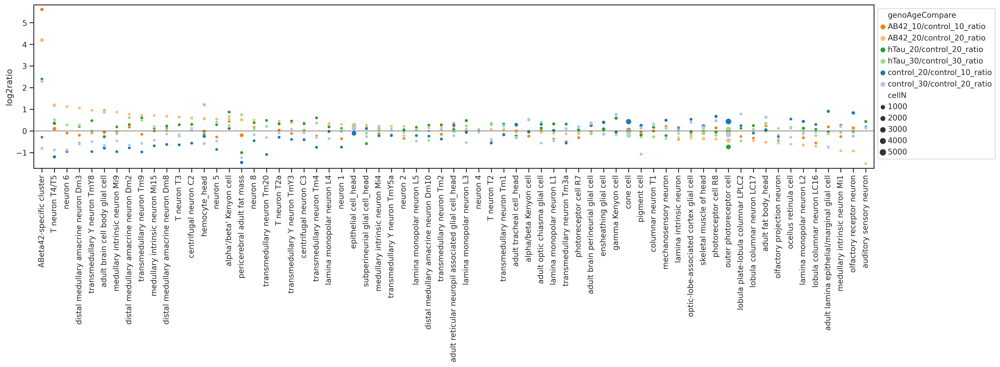

In [84]:
### head dotplot

# Load dotplot data
tissue = 'head'
tissue_dfAll_D[tissue].sort_values(by=['AB42_20/control_20_ratio'], ascending=False, inplace=True)

dotplot_Df=tissue_dfAll_D[tissue].melt(id_vars=['annotation'], value_vars=list(tissue_dfAll_D[tissue].columns[1:7]), 
                      var_name='genoAgeCompare', value_name='log2ratio')
# dotplot_Df

dotplot_Df=pd.concat([dotplot_Df, 
           tissue_dfAll_D[tissue].melt(id_vars=['annotation'], value_vars=list(tissue_dfAll_D[tissue].columns[7:]), 
                      var_name='genoAgeCompare', value_name='cellN').iloc[:,2] ], 
          axis=1) #

# plot
with rc_context({'figure.figsize': (20, 7.5)}):
    ax=sns.scatterplot(data=dotplot_Df, 
                       x="annotation", y="log2ratio", hue="genoAgeCompare", size='cellN', palette=sns.color_palette("tab20")[2:6]+sns.color_palette("tab20")[:2]) # palette=set2Color_L # palette='Set2', 
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    plt.tight_layout()
    ax.margins(0.01, 0.03)
    plt.savefig(f'{figure5PicFolder}/{tissue}_dotplot_cellRatio_normalizeToControl_genoAge.pdf')
    plt.show()

In [85]:
dotplot_Df.to_csv(f'{figure5Folder}/dotplot_Df_{tissue}_genoAge_ctlAge.csv', index=False)

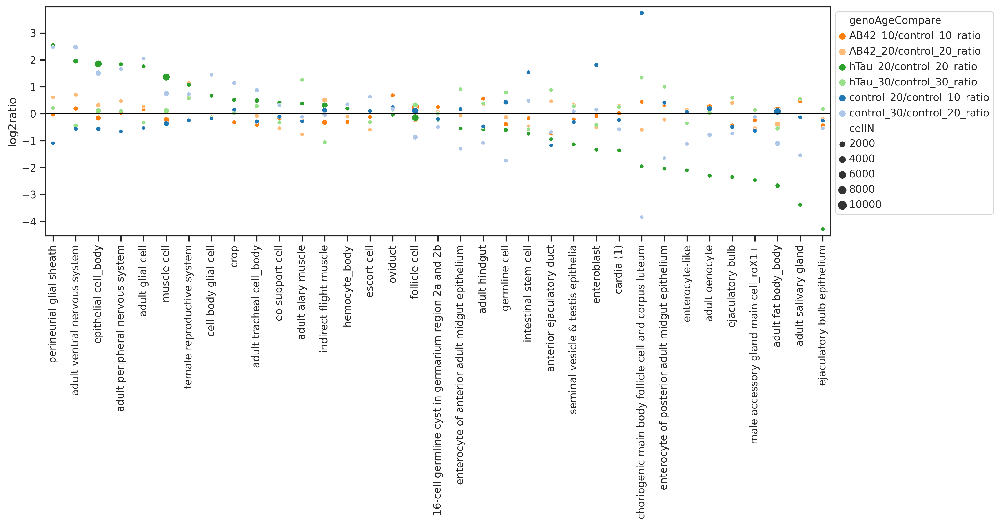

In [86]:
### body dotplot

# Load dotplot data
tissue = 'body'
tissue_dfAll_D[tissue].sort_values(by=['hTau_20/control_20_ratio'], ascending=False, inplace=True)

dotplot_Df=tissue_dfAll_D[tissue].melt(id_vars=['annotation'], value_vars=list(tissue_dfAll_D[tissue].columns[1:7]), 
                      var_name='genoAgeCompare', value_name='log2ratio')
# dotplot_Df

dotplot_Df=pd.concat([dotplot_Df, 
           tissue_dfAll_D[tissue].melt(id_vars=['annotation'], value_vars=list(tissue_dfAll_D[tissue].columns[7:]), 
                      var_name='genoAgeCompare', value_name='cellN').iloc[:,2] ], 
          axis=1) #

# plot
with rc_context({'figure.figsize': (15, 8)}):
    ax=sns.scatterplot(data=dotplot_Df, 
                       x="annotation", y="log2ratio", hue="genoAgeCompare", size='cellN', palette=sns.color_palette("tab20")[2:6]+sns.color_palette("tab20")[:2]) # palette=set2Color_L # palette='Set2', 
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    plt.tight_layout()
    ax.margins(0.01, 0.03)
    plt.savefig(f'{figure5PicFolder}/{tissue}_dotplot_cellRatio_normalizeToControl_genoAge.pdf')
    plt.show()

In [87]:
dotplot_Df.to_csv(f'{figure5Folder}/dotplot_Df_{tissue}_genoAge_ctlAge.csv', index=False)

### Plot pairwise correlation

In [88]:
from scipy.stats import pearsonr
from scipy import stats

In [89]:
dotplot_Df_head = pd.read_csv(f'{figure5Folder}/dotplot_Df_head_genoAge_ctlAge.csv')
dotplot_Df_body = pd.read_csv(f'{figure5Folder}/dotplot_Df_body_genoAge_ctlAge.csv')
dotplot_Df_head

,annotation,genoAgeCompare,log2ratio,cellN
0,ABeta42-specific cluster,AB42_10/control_10_ratio,5.611472,962
1,T neuron T4/T5,AB42_10/control_10_ratio,0.101016,1369
2,neuron 6,AB42_10/control_10_ratio,-0.100345,162
3,distal medullary amacrine neuron Dm3,AB42_10/control_10_ratio,-0.201559,154
4,transmedullary Y neuron TmY8,AB42_10/control_10_ratio,-0.085788,158
...,...,...,...,...
397,lobula columnar neuron LC16,control_30/control_20_ratio,-0.041015,112
398,adult lamina epithelial/marginal glial cell,control_30/control_20_ratio,-0.757086,290
399,medullary intrinsic neuron Mi1,control_30/control_20_ratio,0.197750,401
400,olfactory receptor neuron,control_30/control_20_ratio,-0.240132,713


In [90]:
normalRatio_Df_head = pd.read_csv(f'{figure5Folder}/cellN/head_normalRatio_Df.csv', index_col=0)
normalRatio_Df_body = pd.read_csv(f'{figure5Folder}/cellN/body_normalRatio_Df.csv', index_col=0)
normalRatio_Df_body

,annotation,AB42_10/control_10_ratio,AB42_20/control_20_ratio,hTau_20/control_20_ratio,hTau_30/control_30_ratio,control_20/control_10_ratio,control_30/control_20_ratio
oviduct,oviduct,0.683198,0.172170,-0.037299,0.145885,0.242344,0.175446
female reproductive system,female reproductive system,0.589201,1.145883,1.077578,0.571875,-0.247514,0.722624
adult hindgut,adult hindgut,0.557710,0.347706,-0.582396,0.382199,-0.474899,-1.083696
adult salivary gland,adult salivary gland,0.468731,0.557414,-3.386004,0.553061,-0.133768,-1.544509
choriogenic main body follicle cell and corpus luteum,choriogenic main body follicle cell and corpus...,0.437579,-0.598099,-1.955164,1.338034,3.738488,-3.843171
enterocyte of posterior adult midgut epithelium,enterocyte of posterior adult midgut epithelium,0.326583,-0.219861,-2.043279,1.001962,0.412250,-1.650685
follicle cell,follicle cell,0.265645,-0.214192,-0.146309,0.329841,0.109083,-0.869964
adult oenocyte,adult oenocyte,0.249436,0.115590,-2.302881,0.027788,0.187412,-0.782202
16-cell germline cyst in germarium region 2a and 2b,16-cell germline cyst in germarium region 2a a...,0.247708,0.078647,-0.219291,0.005838,-0.198484,-0.489700
adult ventral nervous system,adult ventral nervous system,0.193525,0.704248,1.952984,-0.445540,-0.559930,2.474397


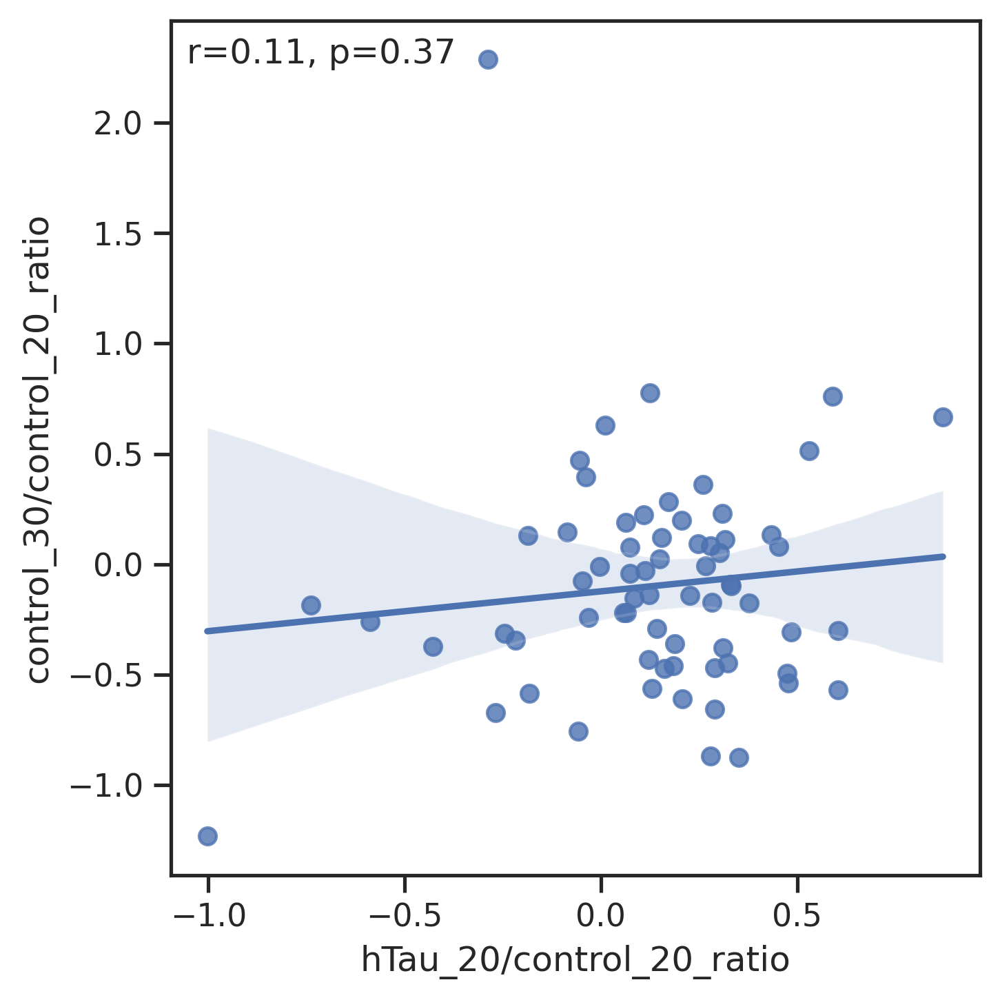

In [91]:
with rc_context({'figure.figsize': (5, 5)}):
    g = sns.regplot(x="hTau_20/control_20_ratio", y="control_30/control_20_ratio", data=normalRatio_Df_head)
    # g = sns.lmplot(x="hTau_20/control_20", y="control_30/control_20", data=umiN_mtx_body)
    r, p = stats.pearsonr(normalRatio_Df_head["hTau_20/control_20_ratio"], normalRatio_Df_head['control_30/control_20_ratio'])
    g.text(.02, .95, f'r={r:.2f}, p={p:.2g}', transform=g.transAxes) #  
    
    plt.tight_layout()
    plt.savefig(f'{figure5PicFolder}/regression_normalRatio_Df_head_correlation_noLabel.pdf', bbox_inches='tight')

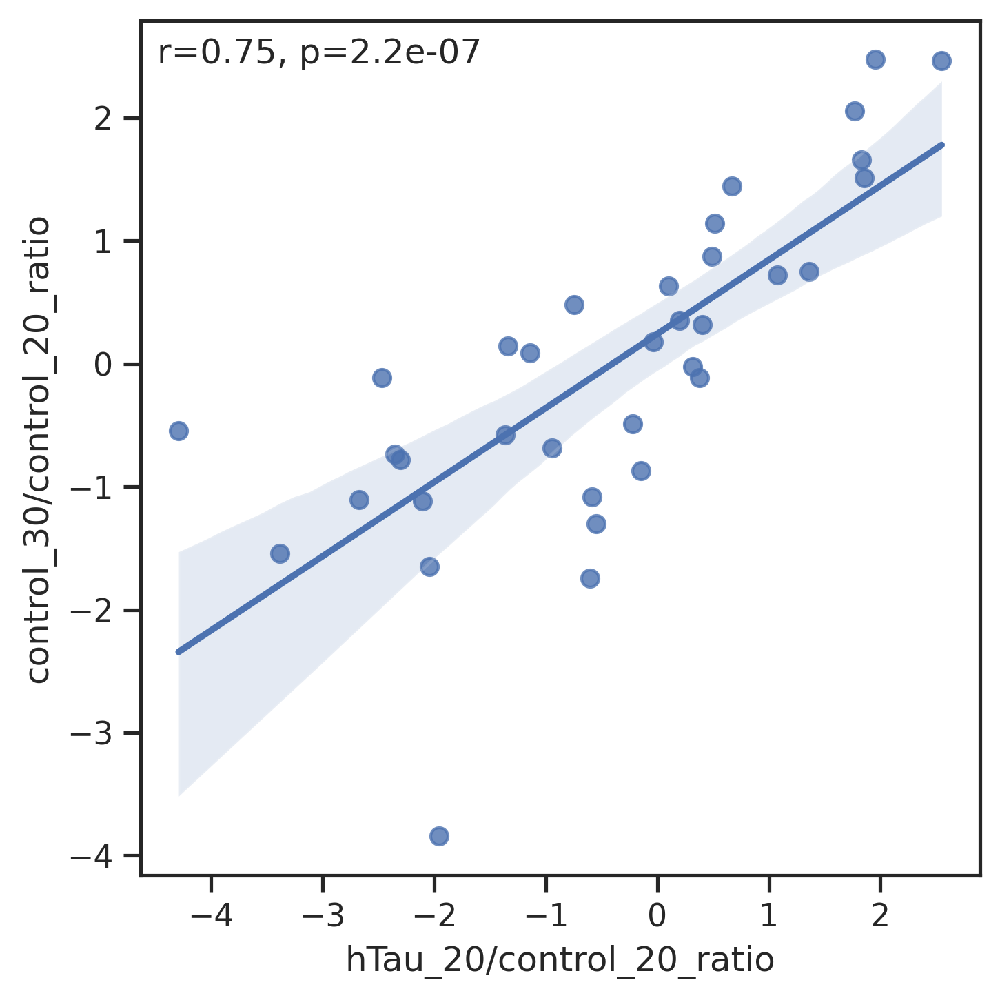

In [92]:
with rc_context({'figure.figsize': (5, 5)}):
    g = sns.regplot(x="hTau_20/control_20_ratio", y="control_30/control_20_ratio", data=normalRatio_Df_body)
    # g = sns.lmplot(x="hTau_20/control_20", y="control_30/control_20", data=umiN_mtx_body)
    r, p = stats.pearsonr(normalRatio_Df_body["hTau_20/control_20_ratio"], normalRatio_Df_body['control_30/control_20_ratio'])
    g.text(.02, .95, f'r={r:.2f}, p={p:.2g}', transform=g.transAxes) #  

    plt.tight_layout()
    plt.savefig(f'{figure5PicFolder}/regression_normalRatio_Df_body_correlation_noLabel.pdf', bbox_inches='tight')

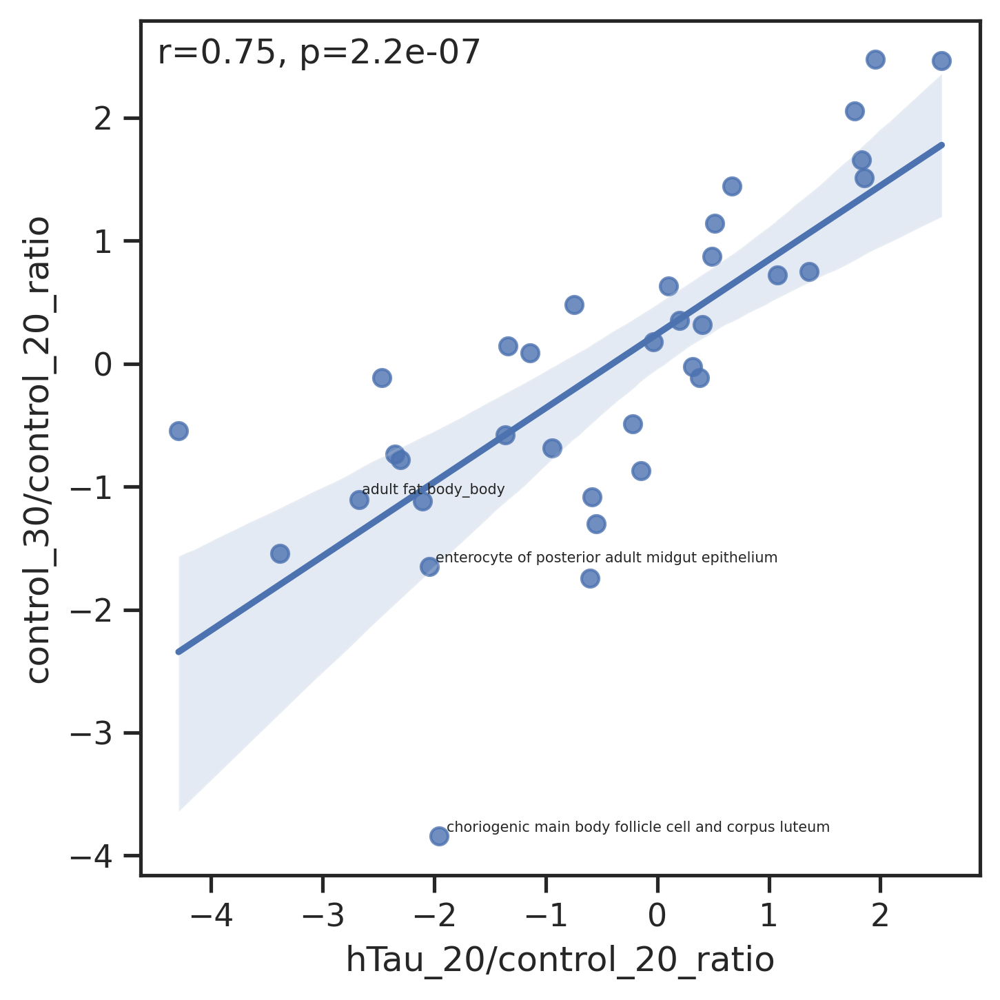

In [93]:
with rc_context({'figure.figsize': (5, 5)}):
    g = sns.regplot(x="hTau_20/control_20_ratio", y="control_30/control_20_ratio", data=normalRatio_Df_body)
    # g = sns.lmplot(x="hTau_20/control_20", y="control_30/control_20", data=umiN_mtx_body)
    r, p = stats.pearsonr(normalRatio_Df_body["hTau_20/control_20_ratio"], normalRatio_Df_body['control_30/control_20_ratio'])

    g.text(.02, .95, f'r={r:.2f}, p={p:.2g}', transform=g.transAxes) #  


    texts = [plt.text(x=normalRatio_Df_body['hTau_20/control_20_ratio'][n], y=normalRatio_Df_body['control_30/control_20_ratio'][n], s=normalRatio_Df_body.index[n], fontsize=5) 
             for n, cellType in enumerate(normalRatio_Df_body.index) 
             if cellType in ['enterocyte of posterior adult midgut epithelium', 'choriogenic main body follicle cell and corpus luteum', 'adult fat body_body']]
    adjust_text(texts, )
    plt.tight_layout()
    plt.savefig(f'{figure5PicFolder}/regression_normalRatio_Df_body_correlation.pdf', bbox_inches='tight')

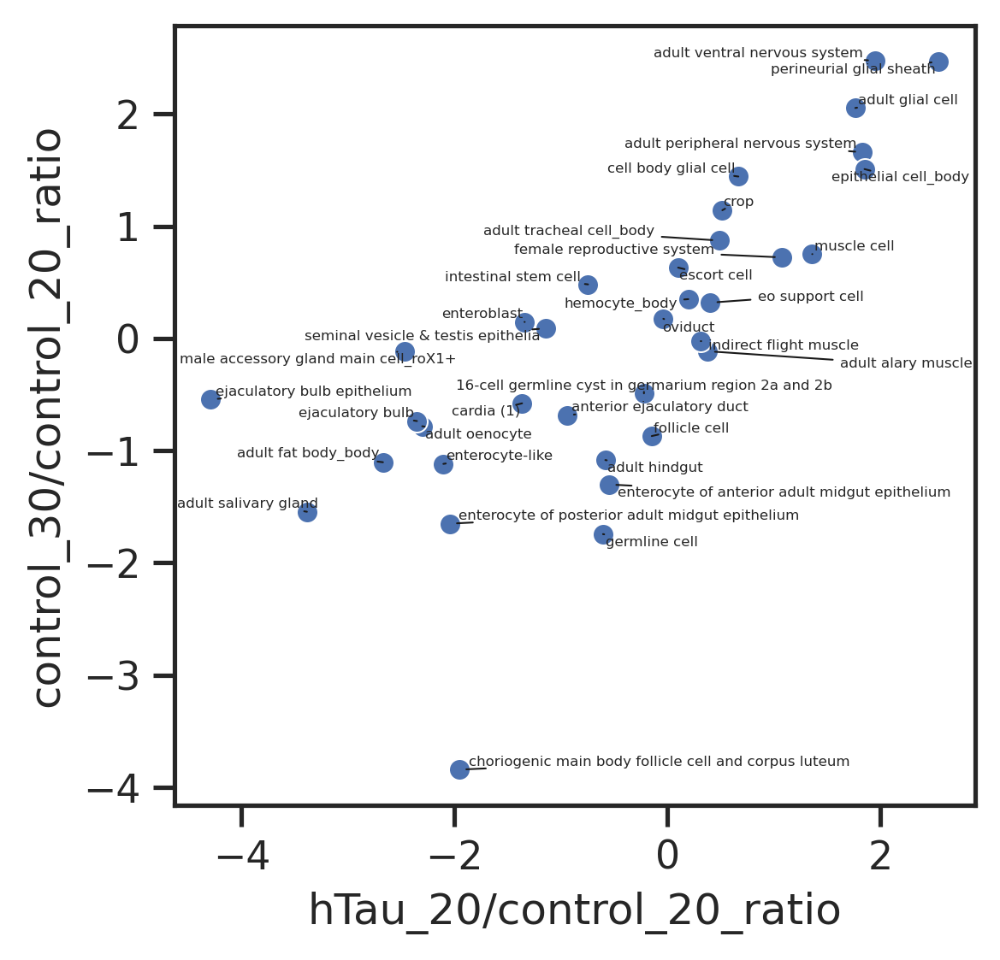

In [94]:
sns.scatterplot(data=normalRatio_Df_body, x="hTau_20/control_20_ratio", y="control_30/control_20_ratio")
texts = [plt.text(x=normalRatio_Df_body['hTau_20/control_20_ratio'][n], y=normalRatio_Df_body['control_30/control_20_ratio'][n], s=normalRatio_Df_body.index[n], fontsize=4) 
         for n, cellType in enumerate(normalRatio_Df_body.index)]
adjust_text(texts, arrowprops=dict(arrowstyle="-", color='k', lw=0.5) ) # arrowprops=dict(arrowstyle='->', color='red') # arrowprops=dict(arrowstyle="-", color='k', lw=0.5)
plt.show()

### correlation heatmap

In [95]:
normalRatio_Df_head = pd.read_csv(f'{figure5Folder}/cellN/head_normalRatio_Df.csv', index_col=0).iloc[:,1:]
normalRatio_Df_body = pd.read_csv(f'{figure5Folder}/cellN/body_normalRatio_Df.csv', index_col=0).iloc[:,1:]
# normalRatio_Df_body

In [96]:
### body correlation
corr = normalRatio_Df_body.corr(method = 'spearman').round(2)
corr

,AB42_10/control_10_ratio,AB42_20/control_20_ratio,hTau_20/control_20_ratio,hTau_30/control_30_ratio,control_20/control_10_ratio,control_30/control_20_ratio
AB42_10/control_10_ratio,1.00,0.15,-0.02,0.02,0.21,-0.19
AB42_20/control_20_ratio,0.15,1.00,0.29,0.01,-0.50,0.25
hTau_20/control_20_ratio,-0.02,0.29,1.00,-0.19,-0.33,0.81
hTau_30/control_30_ratio,0.02,0.01,-0.19,1.00,-0.03,-0.47
control_20/control_10_ratio,0.21,-0.50,-0.33,-0.03,1.00,-0.44
control_30/control_20_ratio,-0.19,0.25,0.81,-0.47,-0.44,1.00


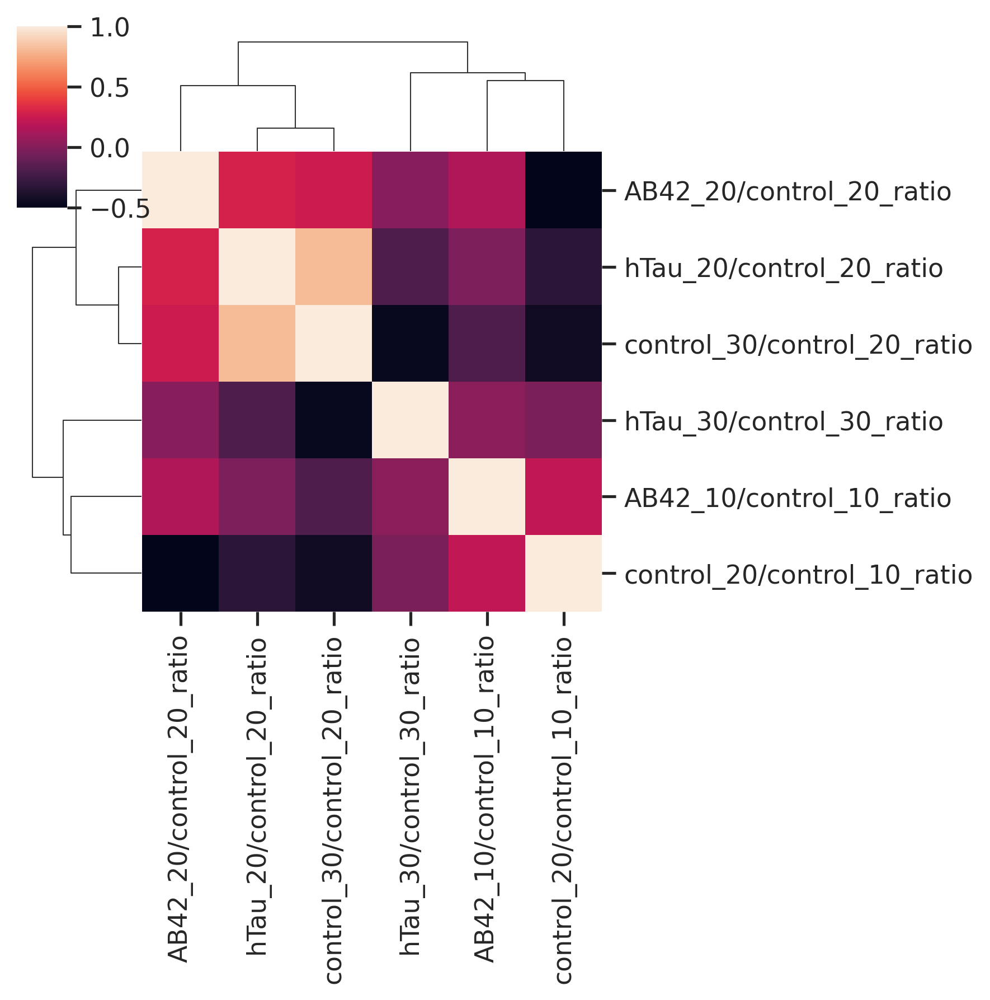

In [97]:
sns.clustermap(corr, figsize=(6, 6), annot=False)
plt.savefig(f'{figure5PicFolder}/heatmap_nucleiRatio_normalRatio_Df_body.pdf', bbox_inches='tight')
plt.show()

In [98]:
### head correlation
corr = normalRatio_Df_head.corr(method = 'spearman').round(2)
corr

,AB42_10/control_10_ratio,AB42_20/control_20_ratio,hTau_20/control_20_ratio,hTau_30/control_30_ratio,control_20/control_10_ratio,control_30/control_20_ratio
AB42_10/control_10_ratio,1.00,0.10,-0.17,0.04,0.29,-0.01
AB42_20/control_20_ratio,0.10,1.00,0.31,0.37,-0.75,-0.42
hTau_20/control_20_ratio,-0.17,0.31,1.00,0.20,-0.48,0.02
hTau_30/control_30_ratio,0.04,0.37,0.20,1.00,-0.49,-0.56
control_20/control_10_ratio,0.29,-0.75,-0.48,-0.49,1.00,0.44
control_30/control_20_ratio,-0.01,-0.42,0.02,-0.56,0.44,1.00


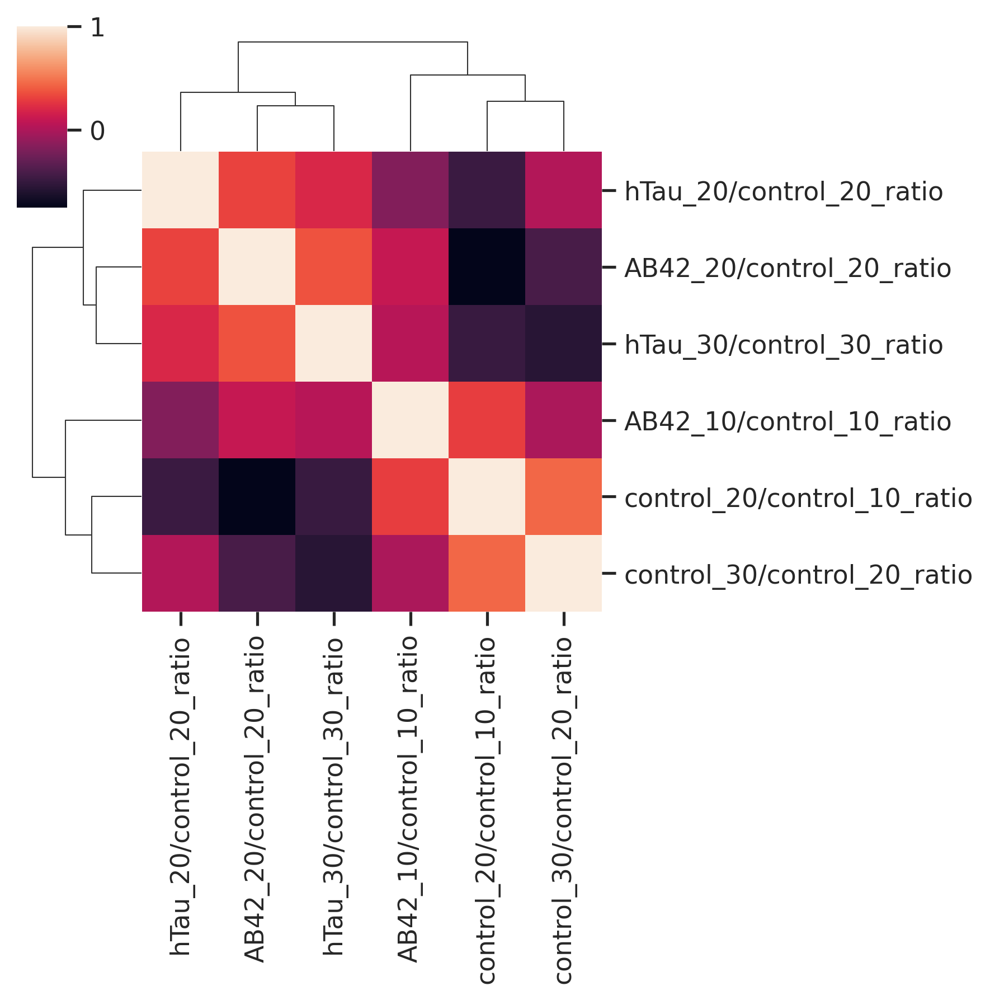

In [99]:
sns.clustermap(corr, figsize=(6, 6), annot=False)
plt.savefig(f'{figure5PicFolder}/heatmap_nucleiRatio_normalRatio_Df_head.pdf', bbox_inches='tight')
plt.show()

# Finish

# Correlation of Cell composition in head cells (compare between different genoAge groups)

## Load files

In [28]:
adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_head_v0.6_woHarmony_raw.h5ad')
adata_body = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.6/adfca_body_v0.6_woHarmony_raw.h5ad')

In [29]:
adata_headBody = adata_head.concatenate(adata_body, join='outer')
adata_headBody

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


AnnData object with n_obs × n_vars = 624458 × 3285
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_group2'
    var: 'gene_ids-0', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'mean-0', 'std-0', 'gene_ids-1', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1', 'mean-1', 'std-1'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'

In [31]:
adfcaTissue = 'head'

### Ratio (separated by genoAge)
Filter cell types with cellN <700

In [32]:
annotationDf_head = pd.read_csv(f'{figure2Folder}/cellN/head_cellN.csv', index_col=0)
annotationDf_body = pd.read_csv(f'{figure3Folder}/cellN/body_cellN.csv', index_col=0)
annotationDf_body

,TotalCellN,control_10_CellN,control_20_CellN,control_30_CellN,AB42_10_CellN,AB42_20_CellN,hTau_20_CellN,hTau_30_CellN
follicle cell,39540,6925,6241,2511.0,9785.0,4314.0,7022,2742.0
adult fat body_body,36353,8340,7409,2536.0,10596.0,4514.0,1448,1510.0
muscle cell,26905,3942,2554,3162.0,3955.0,2145.0,8174,2973.0
epithelial cell_body,24734,3087,1743,3650.0,3254.0,1742.0,7841,3417.0
indirect flight muscle,20334,3260,2974,2151.0,3064.0,3387.0,4606,892.0
...,...,...,...,...,...,...,...,...
prefollicle cell/stalk follicle cell,59,5,8,5.0,8.0,3.0,21,9.0
adult Malpighian tubule principal cell of lower ureter,49,7,12,1.0,21.0,6.0,2,0.0
adult heart ventral longitudinal muscle,34,10,1,3.0,10.0,3.0,6,1.0
"cardiomyocyte, working adult heart muscle (non-ostia)",25,5,6,1.0,8.0,4.0,1,0.0


In [33]:
ratioDf=pd.DataFrame(index=annotationDf_head.index.to_list(), columns=[genoAge + '_ratio' for genoAge in genoAge_L])
for genoAge in genoAge_L:
    print(genoAge)
    ratioDf[f'{genoAge}_ratio'] = ( annotationDf_head[f'{genoAge}_CellN']/sum(annotationDf_head[f'{genoAge}_CellN']) )
ratioDf = ratioDf.sort_values(by=[f'{genoAge_L[0]}_ratio'])
ratioDf

control_10
control_20
control_30
AB42_10
AB42_20
hTau_20
hTau_30


,control_10_ratio,control_20_ratio,control_30_ratio,AB42_10_ratio,AB42_20_ratio,hTau_20_ratio,hTau_30_ratio
lobula columnar neuron LC12,0.000071,0.000084,0.000064,0.000042,0.000067,0.000118,0.000022
octopaminergic/tyraminergic neuron,0.000357,0.000219,0.000235,0.000355,0.000178,0.000354,0.000479
ABeta42-specific cluster,0.000447,0.002329,0.011398,0.020579,0.040377,0.001920,0.006511
neuron 16,0.000465,0.000641,0.000727,0.000710,0.000712,0.000792,0.000653
crystal cell_head,0.000483,0.000186,0.000128,0.000397,0.000334,0.000101,0.000131
...,...,...,...,...,...,...,...
cone cell,0.057302,0.077166,0.073158,0.059417,0.067064,0.074640,0.063634
epithelial cell_head,0.057338,0.053030,0.057654,0.064264,0.064082,0.059025,0.062828
outer photoreceptor cell,0.069331,0.093892,0.082631,0.067377,0.069246,0.056279,0.087393
unannotated,0.093156,0.079849,0.063812,0.097336,0.091571,0.069469,0.067597


### Relative ratio (normalize to control, separated by genoAge)
Filter cell types with cellN <700

In [34]:
expCompare_D = dict(zip(expCompare_Df.expSet, expCompare_Df.controlSet))
expCompare_D

{'AB42_10': 'control_10',
 'AB42_20': 'control_20',
 'hTau_20': 'control_20',
 'hTau_30': 'control_30'}

In [35]:
expCompare_Df

,expSet,controlSet
0,AB42_10,control_10
1,AB42_20,control_20
2,hTau_20,control_20
3,hTau_30,control_30


In [36]:
expCompare_Df.iloc[0,1]

'control_10'

In [37]:
normalRatio_Df=ratioDf[:]
normalRatio_Df=normalRatio_Df.drop(['unannotated', 'uncharacterized CNS neuron'], axis=0)
normalRatio_Df=normalRatio_Df[normalRatio_Df.index.isin(celltypeN700_L)]

# for i in range(1,3):
#     genotype=genotype_L[i]
#     # print(genotype)    
#     normalRatio_Df[f'{genotype}/control_ratio']=normalRatio_Df[f'{genotype}_ratio']/normalRatio_Df[f'control_ratio']
    
for expSet in expCompare_Df.expSet:
    controlSet = expCompare_D[expSet]
    normalRatio_Df[f'{expSet}/{controlSet}_ratio']=normalRatio_Df[f'{expSet}_ratio']/normalRatio_Df[f'{controlSet}_ratio']

normalRatio_Df=normalRatio_Df.iloc[:,7:]
normalRatioNoLog2_Df=normalRatio_Df[:]
normalRatio_Df=np.log2(normalRatio_Df)

normalRatioNoLog2_Df=normalRatioNoLog2_Df.sort_values(by=f'{expCompare_Df.iloc[0,0]}/{expCompare_Df.iloc[0,1]}_ratio', ascending=False)
normalRatio_Df=normalRatio_Df.sort_values(by=f'{expCompare_Df.iloc[0,0]}/{expCompare_Df.iloc[0,1]}_ratio', ascending=False)

normalRatio_Df.replace([np.inf, -np.inf], np.nan, inplace=True)
normalRatioNoLog2_Df.replace([np.inf, -np.inf], np.nan, inplace=True)

normalRatio_Df

,AB42_10/control_10_ratio,AB42_20/control_20_ratio,hTau_20/control_20_ratio,hTau_30/control_30_ratio
ABeta42-specific cluster,5.525265,4.115642,-0.278456,-0.807745
alpha'/beta' Kenyon cell,0.428675,0.545429,0.876884,0.223604
adult reticular neuropil associated glial cell_head,0.334667,0.155282,0.066040,-0.031663
lamina monopolar neuron L4,0.309410,0.329860,0.187217,-0.017082
adult fat body_head,0.243655,-0.520490,0.011678,0.341002
...,...,...,...,...
neuron 1,-0.377309,0.332537,0.147319,0.038023
lamina monopolar neuron L1,-0.380418,-0.118326,0.328738,-0.084786
lamina intrinsic neuron,-0.398710,-0.333206,0.146444,-0.144741
transmedullary neuron Tm3a,-0.489702,-0.124909,0.335877,0.101013


In [38]:
normalRatio_Df.insert(0, 'annotation', normalRatio_Df.index.to_list())
normalRatio_longDf=normalRatio_Df.melt(id_vars=['annotation'], var_name='genoAgeCompare', value_name='log2ratio')
normalRatio_longDf

,annotation,genoAgeCompare,log2ratio
0,ABeta42-specific cluster,AB42_10/control_10_ratio,5.525265
1,alpha'/beta' Kenyon cell,AB42_10/control_10_ratio,0.428675
2,adult reticular neuropil associated glial cell...,AB42_10/control_10_ratio,0.334667
3,lamina monopolar neuron L4,AB42_10/control_10_ratio,0.309410
4,adult fat body_head,AB42_10/control_10_ratio,0.243655
...,...,...,...
251,neuron 1,hTau_30/control_30_ratio,0.038023
252,lamina monopolar neuron L1,hTau_30/control_30_ratio,-0.084786
253,lamina intrinsic neuron,hTau_30/control_30_ratio,-0.144741
254,transmedullary neuron Tm3a,hTau_30/control_30_ratio,0.101013


In [39]:
dfAll=pd.concat([normalRatio_Df, 
           annotationDf_head.loc[normalRatio_Df.index.to_list(),:].drop(annotationDf_head.columns[:4].to_list(), axis=1)], 
          axis=1)
# dfAll

In [40]:
dfAll

,annotation,AB42_10/control_10_ratio,AB42_20/control_20_ratio,hTau_20/control_20_ratio,hTau_30/control_30_ratio,AB42_10_CellN,AB42_20_CellN,hTau_20_CellN,hTau_30_CellN
ABeta42-specific cluster,ABeta42-specific cluster,5.525265,4.115642,-0.278456,-0.807745,985,1814,114,299
alpha'/beta' Kenyon cell,alpha'/beta' Kenyon cell,0.428675,0.545429,0.876884,0.223604,152,166,276,219
adult reticular neuropil associated glial cell_head,adult reticular neuropil associated glial cell...,0.334667,0.155282,0.066040,-0.031663,383,380,472,293
lamina monopolar neuron L4,lamina monopolar neuron L4,0.309410,0.329860,0.187217,-0.017082,282,264,316,164
adult fat body_head,adult fat body_head,0.243655,-0.520490,0.011678,0.341002,549,314,600,903
...,...,...,...,...,...,...,...,...,...
neuron 1,neuron 1,-0.377309,0.332537,0.147319,0.038023,164,148,172,123
lamina monopolar neuron L1,lamina monopolar neuron L1,-0.380418,-0.118326,0.328738,-0.084786,255,292,526,225
lamina intrinsic neuron,lamina intrinsic neuron,-0.398710,-0.333206,0.146444,-0.144741,122,127,234,151
transmedullary neuron Tm3a,transmedullary neuron Tm3a,-0.489702,-0.124909,0.335877,0.101013,276,226,411,297


In [41]:
dfAll.sort_values(by=['AB42_20/control_20_ratio'], ascending=False, inplace=True)

In [42]:
dotplot_Df=dfAll.melt(id_vars=['annotation'], value_vars=list(dfAll.columns[1:5]), 
                      var_name='genoAgeCompare', value_name='log2ratio')
# dotplot_Df

dotplot_Df=pd.concat([dotplot_Df, 
           dfAll.melt(id_vars=['annotation'], value_vars=list(dfAll.columns[5:]), 
                      var_name='genoAgeCompare', value_name='cellN').iloc[:,2] ], 
          axis=1) # 

In [43]:
dotplot_Df

,annotation,genoAgeCompare,log2ratio,cellN
0,ABeta42-specific cluster,AB42_10/control_10_ratio,5.525265,985
1,T neuron T4/T5,AB42_10/control_10_ratio,0.099260,1371
2,neuron 6,AB42_10/control_10_ratio,-0.091467,163
3,distal medullary amacrine neuron Dm3,AB42_10/control_10_ratio,-0.208512,154
4,neuron 7,AB42_10/control_10_ratio,-0.005864,167
...,...,...,...,...
251,lamina monopolar neuron L2,hTau_30/control_30_ratio,-0.057950,416
252,adult lamina epithelial/marginal glial cell,hTau_30/control_30_ratio,-0.136855,259
253,medullary intrinsic neuron Mi1,hTau_30/control_30_ratio,-0.077912,374
254,olfactory receptor neuron,hTau_30/control_30_ratio,0.003814,702


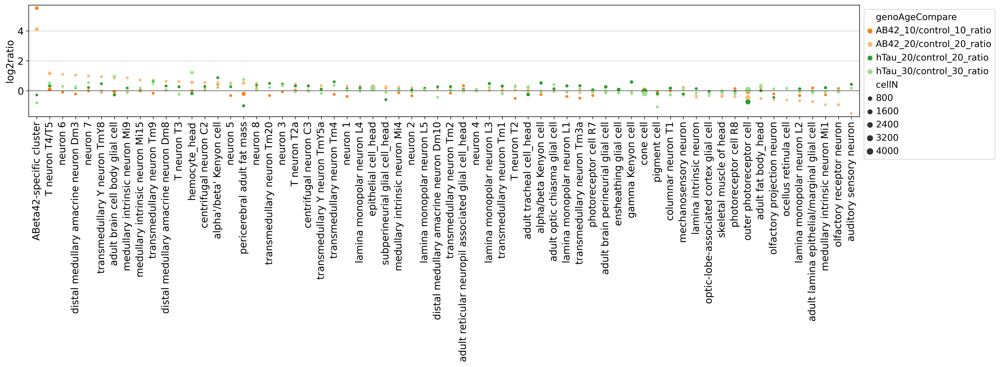

In [44]:
with rc_context({'figure.figsize': (20, 7.5)}):
    ax=sns.scatterplot(data=dotplot_Df, 
                       x="annotation", y="log2ratio", hue="genoAgeCompare", size='cellN', palette=sns.color_palette("tab20")[2:6]) # palette=set2Color_L # palette='Set2', 
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    plt.tight_layout()
    ax.margins(0.01, 0.03)
    plt.savefig(f'{figure4PicFolder}/{adfcaTissue}_dotplot_cellRatio_normalizeToControl_genoAgeCompare.pdf')
    plt.show()

# for x in os.listdir('figures/'): 
#     os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

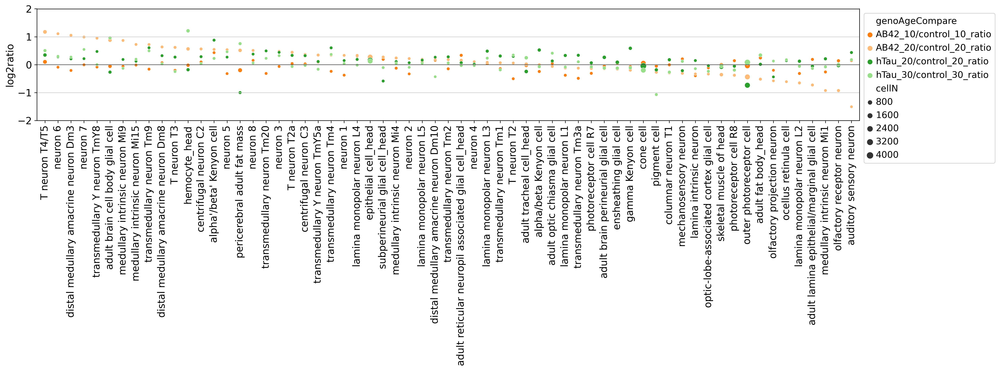

In [45]:
with rc_context({'figure.figsize': (20, 7.5)}):
    ax=sns.scatterplot(data=dotplot_Df[dotplot_Df.annotation != 'ABeta42-specific cluster'], 
                       x="annotation", y="log2ratio", hue="genoAgeCompare", size='cellN', palette=sns.color_palette("tab20")[2:6]) # palette=set2Color_L # palette='Set2', 
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    plt.tight_layout()
    ax.margins(0.01, 0.03)
    plt.ylim(-2, 2)
    plt.savefig(f'{figure2PicFolder}/{adfcaTissue}_dotplot_cellRatio_normalizeToControl_genoAgeCompare_noABcluster.pdf')
    plt.show()

# for x in os.listdir('figures/'): 
#     os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

In [46]:
dotplotHead_Df_genotype=pd.read_csv(f'{figure2Folder}/cellN/head_ratioDf_dotplot_Df_genotypeGroup.csv', index_col=0)
dotplotHead_Df_genotype.sort_values(by='log2ratio', inplace=True)
dotplotHead_Df_genotype

,annotation,genotypeCompare,log2ratio,cellN
62,ABeta42-specific cluster,hTau/control_inTau_ratio,-0.690243,1084
24,medullary intrinsic neuron Mi1,AB42/control_inAB42_ratio,-0.583114,1224
63,pigment cell,hTau/control_inTau_ratio,-0.527989,2420
21,lamina monopolar neuron L2,AB42/control_inAB42_ratio,-0.509909,1633
51,auditory sensory neuron,AB42/control_inAB42_ratio,-0.483339,662
...,...,...,...,...
121,transmedullary neuron Tm4,hTau/control_inTau_ratio,0.517269,678
56,T neuron T4/T5,AB42/control_inAB42_ratio,0.536971,4756
122,alpha'/beta' Kenyon cell,hTau/control_inTau_ratio,0.547585,836
123,transmedullary neuron Tm9,hTau/control_inTau_ratio,0.570144,485


In [47]:
ct_L = dotplotHead_Df_genotype[dotplotHead_Df_genotype.genotypeCompare == 'AB42/control_inAB42_ratio'].annotation.to_list()[:10]
ct_L

['medullary intrinsic neuron Mi1',
 'lamina monopolar neuron L2',
 'auditory sensory neuron',
 'olfactory receptor neuron',
 'lamina intrinsic neuron',
 'adult lamina epithelial/marginal glial cell',
 'olfactory projection neuron',
 'transmedullary neuron Tm3a',
 'outer photoreceptor cell',
 'ocellus retinula cell']

In [48]:
ct_L = ['auditory sensory neuron', 'olfactory receptor neuron', 'olfactory projection neuron',
        'medullary intrinsic neuron Mi1', 'lamina monopolar neuron L2', 'lamina intrinsic neuron',  'transmedullary neuron Tm3a', 'outer photoreceptor cell', 'ocellus retinula cell', 
        'adult lamina epithelial/marginal glial cell']

In [49]:
dotplot_Df

,annotation,genoAgeCompare,log2ratio,cellN
0,ABeta42-specific cluster,AB42_10/control_10_ratio,5.525265,985
1,T neuron T4/T5,AB42_10/control_10_ratio,0.099260,1371
2,neuron 6,AB42_10/control_10_ratio,-0.091467,163
3,distal medullary amacrine neuron Dm3,AB42_10/control_10_ratio,-0.208512,154
4,neuron 7,AB42_10/control_10_ratio,-0.005864,167
...,...,...,...,...
251,lamina monopolar neuron L2,hTau_30/control_30_ratio,-0.057950,416
252,adult lamina epithelial/marginal glial cell,hTau_30/control_30_ratio,-0.136855,259
253,medullary intrinsic neuron Mi1,hTau_30/control_30_ratio,-0.077912,374
254,olfactory receptor neuron,hTau_30/control_30_ratio,0.003814,702


In [50]:
barPlot_Df = dotplot_Df[dotplot_Df.annotation.isin(ct_L)].sort_values(by='log2ratio', ascending=False)
barPlot_Df.annotation = pd.Categorical(barPlot_Df.annotation, categories=ct_L)
# barPlot_Df.genoAgeCompare = pd.Categorical(barPlot_Df.genoAgeCompare, categories=['AB42_10/control_10_ratio', 'AB42_20/control_20_ratio', 'hTau_20/control_20_ratio', 'hTau_30/control_30_ratio'])
barPlot_Df

,annotation,genoAgeCompare,log2ratio,cellN
191,auditory sensory neuron,hTau_20/control_20_ratio,0.434099,310
170,transmedullary neuron Tm3a,hTau_20/control_20_ratio,0.335877,411
189,medullary intrinsic neuron Mi1,hTau_20/control_20_ratio,0.208387,514
60,adult lamina epithelial/marginal glial cell,AB42_10/control_10_ratio,0.187788,305
255,auditory sensory neuron,hTau_30/control_30_ratio,0.178249,220
250,ocellus retinula cell,hTau_30/control_30_ratio,0.176662,101
63,auditory sensory neuron,AB42_10/control_10_ratio,0.147558,181
179,lamina intrinsic neuron,hTau_20/control_20_ratio,0.146444,234
58,ocellus retinula cell,AB42_10/control_10_ratio,0.143611,86
186,ocellus retinula cell,hTau_20/control_20_ratio,0.143029,156


/tmp/ipykernel_163799/1858780596.py:6: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


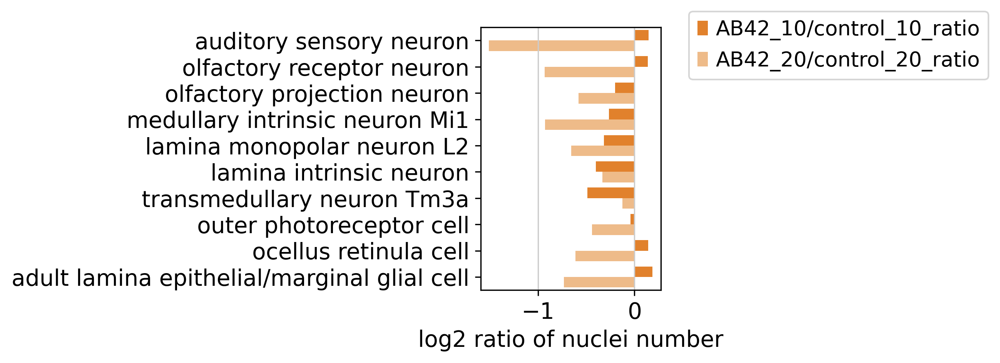

In [51]:
fig, ax = plt.subplots(figsize=(2, 3))
sns.barplot(x='log2ratio', y='annotation', hue='genoAgeCompare', data=barPlot_Df[barPlot_Df.genoAgeCompare.isin(['AB42_10/control_10_ratio', 'AB42_20/control_20_ratio'])], 
            palette=sns.color_palette("tab20")[2:6], ax=ax,)
plt.legend(bbox_to_anchor=(1.1, 1.1))
# plt.xlim(-1.6, 1.6)
plt.tight_layout()
plt.xlabel('log2 ratio of nuclei number')
plt.ylabel('')
plt.savefig(f'{figure4PicFolder}/{adfcaTissue}_barplot_cellRatio_normalizeToControl_lowestAB42_10celltypes_noTau.pdf', bbox_inches='tight')

In [78]:
cellnFolder

'Analysis/Figure/Figure2/cellN'

### Output cell# and ratios

In [80]:
ratioDf.to_csv(f'{cellnFig4Folder}/{adfcaTissue}_ratioDf.csv')
dotplot_Df.to_csv(f'{cellnFig4Folder}/{adfcaTissue}_ratioDf_dotplot_Df.csv')

In [81]:
normalRatio_Df.to_csv(f'{cellnFig4Folder}/{adfcaTissue}_normalRatioDf_normalizeToControl.csv')
normalRatioNoLog2_Df.to_csv(f'{cellnFig4Folder}/{adfcaTissue}_normalRatioNoLog2_Df_normalizeToControl.csv')
normalRatio_longDf.to_csv(f'{cellnFig4Folder}/{adfcaTissue}_normalRatio_longDf_normalizeToControl.csv')

### Relative ratio (normalize to control, separated by genoAge, focus on the aging differences between the same genotype)
Filter cell types with cellN <700

In [85]:
ageCompare_D = dict(zip(ageCompare_Df.expSet, ageCompare_Df.controlSet))
ageCompare_D

{'control_20': 'control_10',
 'control_30': 'control_20',
 'AB42_20': 'AB42_10',
 'hTau_30': 'hTau_20'}

In [83]:
ageCompare_Df.iloc[0,1]

'control_10'

In [86]:
normalRatio_Df=ratioDf[:]
normalRatio_Df=normalRatio_Df.drop(['unannotated', 'uncharacterized CNS neuron'], axis=0)
normalRatio_Df=normalRatio_Df[normalRatio_Df.index.isin(celltypeN700_L)]

# for i in range(1,3):
#     genotype=genotype_L[i]
#     # print(genotype)    
#     normalRatio_Df[f'{genotype}/control_ratio']=normalRatio_Df[f'{genotype}_ratio']/normalRatio_Df[f'control_ratio']
    
for expSet in ageCompare_Df.expSet:
    controlSet = ageCompare_D[expSet]
    normalRatio_Df[f'{expSet}/{controlSet}_ratio']=normalRatio_Df[f'{expSet}_ratio']/normalRatio_Df[f'{controlSet}_ratio']

normalRatio_Df=normalRatio_Df.iloc[:,7:]
normalRatioNoLog2_Df=normalRatio_Df[:]
normalRatio_Df=np.log2(normalRatio_Df)

normalRatioNoLog2_Df=normalRatioNoLog2_Df.sort_values(by=f'{ageCompare_Df.iloc[0,0]}/{ageCompare_Df.iloc[0,1]}_ratio', ascending=False)
normalRatio_Df=normalRatio_Df.sort_values(by=f'{ageCompare_Df.iloc[0,0]}/{ageCompare_Df.iloc[0,1]}_ratio', ascending=False)

normalRatio_Df.replace([np.inf, -np.inf], np.nan, inplace=True)
normalRatioNoLog2_Df.replace([np.inf, -np.inf], np.nan, inplace=True)

normalRatio_Df

,control_20/control_10_ratio,control_30/control_20_ratio,AB42_20/AB42_10_ratio,hTau_30/hTau_20_ratio
ABeta42-specific cluster,2.381990,2.290921,0.972367,1.761633
adult lamina epithelial/marginal glial cell,0.905752,-0.757086,-0.011530,-0.836672
olfactory receptor neuron,0.832008,-0.240132,-0.235284,-0.204819
photoreceptor cell R8,0.670464,0.470157,0.149193,0.330481
ocellus retinula cell,0.549078,-0.290303,-0.205593,-0.256669
...,...,...,...,...
medullary intrinsic neuron Mi9,-0.958288,-0.437947,-0.030357,-0.756011
transmedullary neuron Tm9,-0.977496,-0.571083,-0.094478,-0.682220
transmedullary neuron Tm20,-1.110802,-0.307381,-0.307529,-0.574136
T neuron T4/T5,-1.184558,-0.869941,-0.110456,-0.711462


In [87]:
normalRatio_Df.insert(0, 'annotation', normalRatio_Df.index.to_list())
normalRatio_longDf=normalRatio_Df.melt(id_vars=['annotation'], var_name='genoAgeCompare', value_name='log2ratio')
normalRatio_longDf

,annotation,genoAgeCompare,log2ratio
0,ABeta42-specific cluster,control_20/control_10_ratio,2.381990
1,adult lamina epithelial/marginal glial cell,control_20/control_10_ratio,0.905752
2,olfactory receptor neuron,control_20/control_10_ratio,0.832008
3,photoreceptor cell R8,control_20/control_10_ratio,0.670464
4,ocellus retinula cell,control_20/control_10_ratio,0.549078
...,...,...,...
251,medullary intrinsic neuron Mi9,hTau_30/hTau_20_ratio,-0.756011
252,transmedullary neuron Tm9,hTau_30/hTau_20_ratio,-0.682220
253,transmedullary neuron Tm20,hTau_30/hTau_20_ratio,-0.574136
254,T neuron T4/T5,hTau_30/hTau_20_ratio,-0.711462


In [88]:
dfAll=pd.concat([normalRatio_Df, 
           annotationDf_head.loc[normalRatio_Df.index.to_list(),:].drop(annotationDf_head.columns[:4].to_list(), axis=1)], 
          axis=1)
# dfAll

In [89]:
dfAll

,annotation,control_20/control_10_ratio,control_30/control_20_ratio,AB42_20/AB42_10_ratio,hTau_30/hTau_20_ratio,AB42_10_CellN,AB42_20_CellN,hTau_20_CellN,hTau_30_CellN
ABeta42-specific cluster,ABeta42-specific cluster,2.381990,2.290921,0.972367,1.761633,985,1814,114,299
adult lamina epithelial/marginal glial cell,adult lamina epithelial/marginal glial cell,0.905752,-0.757086,-0.011530,-0.836672,305,284,598,259
olfactory receptor neuron,olfactory receptor neuron,0.832008,-0.240132,-0.235284,-0.204819,533,425,1046,702
photoreceptor cell R8,photoreceptor cell R8,0.670464,0.470157,0.149193,0.330481,318,331,548,533
ocellus retinula cell,ocellus retinula cell,0.549078,-0.290303,-0.205593,-0.256669,86,70,156,101
...,...,...,...,...,...,...,...,...,...
medullary intrinsic neuron Mi9,medullary intrinsic neuron Mi9,-0.958288,-0.437947,-0.030357,-0.756011,173,159,131,60
transmedullary neuron Tm9,transmedullary neuron Tm9,-0.977496,-0.571083,-0.094478,-0.682220,182,160,195,94
transmedullary neuron Tm20,transmedullary neuron Tm20,-1.110802,-0.307381,-0.307529,-0.574136,178,135,179,93
T neuron T4/T5,T neuron T4/T5,-1.184558,-0.869941,-0.110456,-0.711462,1371,1192,887,419


In [97]:
dfAll.sort_values(by=['control_30/control_20_ratio'], ascending=False, inplace=True)

In [98]:
dotplot_Df=dfAll.melt(id_vars=['annotation'], value_vars=list(dfAll.columns[1:5]), 
                      var_name='genoAgeCompare', value_name='log2ratio')
# dotplot_Df

dotplot_Df=pd.concat([dotplot_Df, 
           dfAll.melt(id_vars=['annotation'], value_vars=list(dfAll.columns[5:]), 
                      var_name='genoAgeCompare', value_name='cellN').iloc[:,2] ], 
          axis=1) # 

In [99]:
dotplot_Df

,annotation,genoAgeCompare,log2ratio,cellN
0,ABeta42-specific cluster,control_20/control_10_ratio,2.381990,985
1,gamma Kenyon cell,control_20/control_10_ratio,-0.047345,393
2,alpha'/beta' Kenyon cell,control_20/control_10_ratio,0.101746,152
3,adult fat body_head,control_20/control_10_ratio,0.049492,549
4,alpha/beta Kenyon cell,control_20/control_10_ratio,-0.041623,350
...,...,...,...,...
251,adult lamina epithelial/marginal glial cell,hTau_30/hTau_20_ratio,-0.836672,259
252,T neuron T4/T5,hTau_30/hTau_20_ratio,-0.711462,419
253,neuron 6,hTau_30/hTau_20_ratio,-0.858960,58
254,pericerebral adult fat mass,hTau_30/hTau_20_ratio,0.522524,450


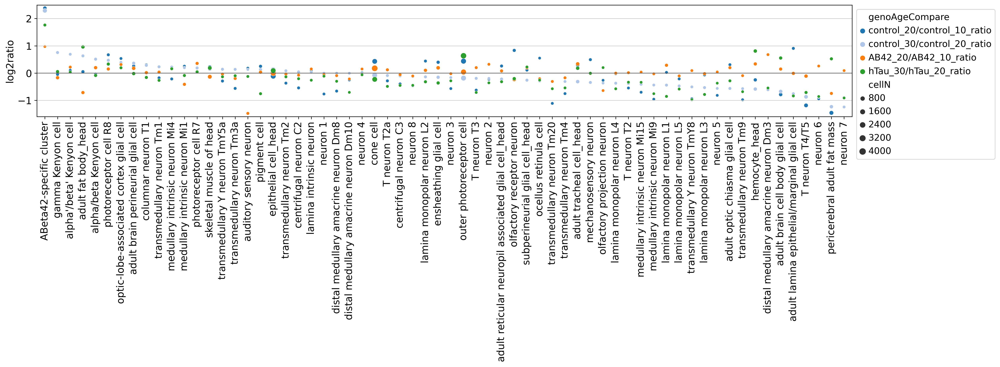

In [100]:
with rc_context({'figure.figsize': (20, 7.5)}):
    ax=sns.scatterplot(data=dotplot_Df, 
                       x="annotation", y="log2ratio", hue="genoAgeCompare", size='cellN', palette=sns.color_palette("tab20")[:2]+sns.color_palette("tab10")[1:3]) # palette=set2Color_L # palette='Set2', 
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    plt.tight_layout()
    ax.margins(0.01, 0.03)
    plt.savefig(f'{figure4PicFolder}/{adfcaTissue}_dotplot_cellRatio_normalizeToControl_genoAgeCompare_sameGenoGroup.pdf')
    plt.show()

# for x in os.listdir('figures/'): 
#     os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

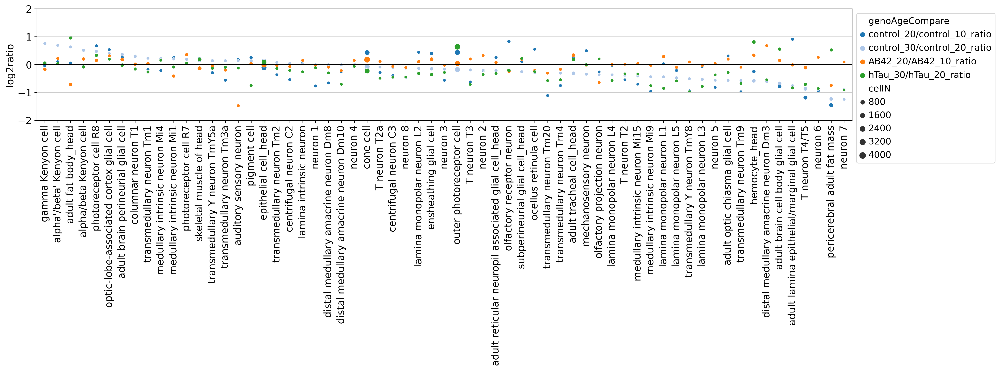

In [104]:
with rc_context({'figure.figsize': (20, 7.5)}):
    ax=sns.scatterplot(data=dotplot_Df[dotplot_Df.annotation != 'ABeta42-specific cluster'], 
                       x="annotation", y="log2ratio", hue="genoAgeCompare", size='cellN', palette=sns.color_palette("tab20")[:2]+sns.color_palette("tab10")[1:3]) # palette=set2Color_L # palette='Set2', 
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    plt.tight_layout()
    ax.margins(0.01, 0.03)
    plt.ylim(-2, 2)
    plt.savefig(f'{figure4PicFolder}/{adfcaTissue}_dotplot_cellRatio_normalizeToControl_genoAgeCompare_noABcluster_sameGenoGroup.pdf')
    plt.show()

# for x in os.listdir('figures/'): 
#     os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

In [60]:
dotplotHead_Df_genotype=pd.read_csv(f'{figure2Folder}/cellN/head_ratioDf_dotplot_Df_genotypeGroup.csv', index_col=0)
dotplotHead_Df_genotype.sort_values(by='log2ratio', inplace=True)
dotplotHead_Df_genotype

,annotation,genotypeCompare,log2ratio,cellN
62,ABeta42-specific cluster,hTau/control_inTau_ratio,-0.690243,1084
24,medullary intrinsic neuron Mi1,AB42/control_inAB42_ratio,-0.583114,1224
63,pigment cell,hTau/control_inTau_ratio,-0.527989,2420
21,lamina monopolar neuron L2,AB42/control_inAB42_ratio,-0.509909,1633
51,auditory sensory neuron,AB42/control_inAB42_ratio,-0.483339,662
...,...,...,...,...
121,transmedullary neuron Tm4,hTau/control_inTau_ratio,0.517269,678
56,T neuron T4/T5,AB42/control_inAB42_ratio,0.536971,4756
122,alpha'/beta' Kenyon cell,hTau/control_inTau_ratio,0.547585,836
123,transmedullary neuron Tm9,hTau/control_inTau_ratio,0.570144,485


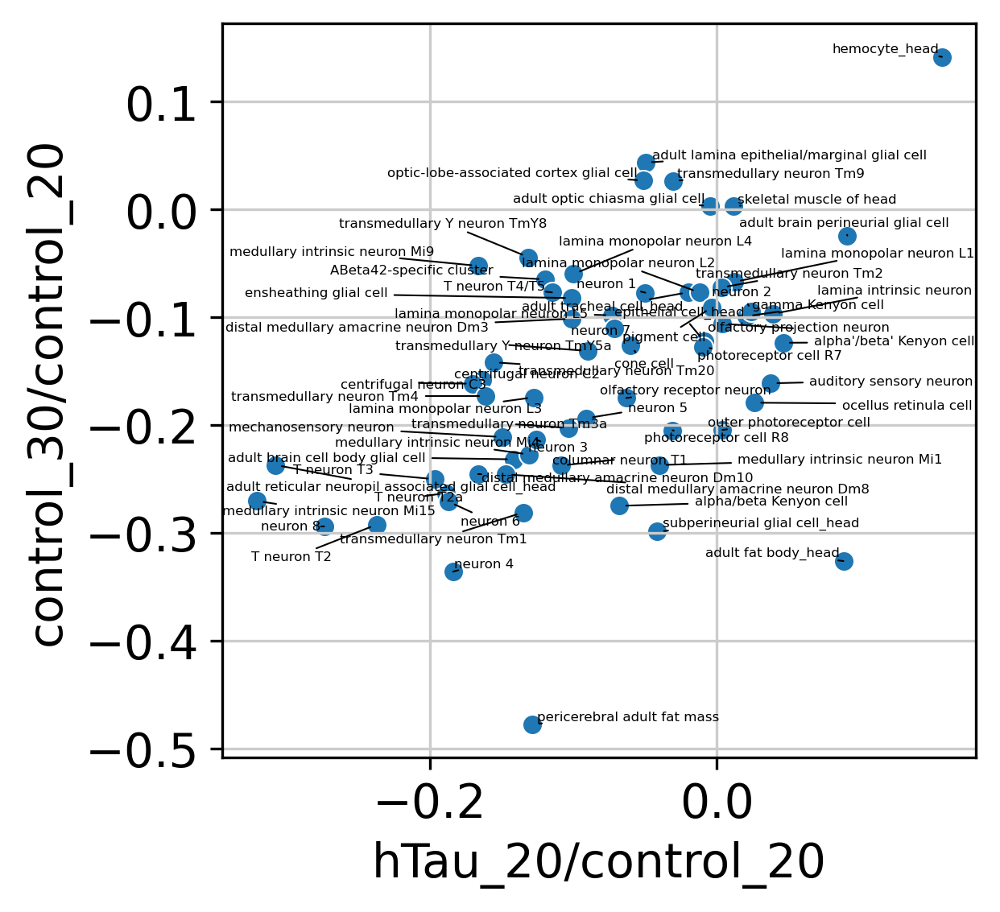

In [84]:
sns.scatterplot(data=geneN_mtx_head, x="hTau_20/control_20", y="control_30/control_20")
texts = [plt.text(x=geneN_mtx_head['hTau_20/control_20'][n], y=geneN_mtx_head['control_30/control_20'][n], s=geneN_mtx_head.index[n], fontsize=4) 
         for n, cellType in enumerate(geneN_mtx_head.index)]
adjust_text(texts, arrowprops=dict(arrowstyle="-", color='k', lw=0.5) ) # arrowprops=dict(arrowstyle='->', color='red') # arrowprops=dict(arrowstyle="-", color='k', lw=0.5)
plt.show()

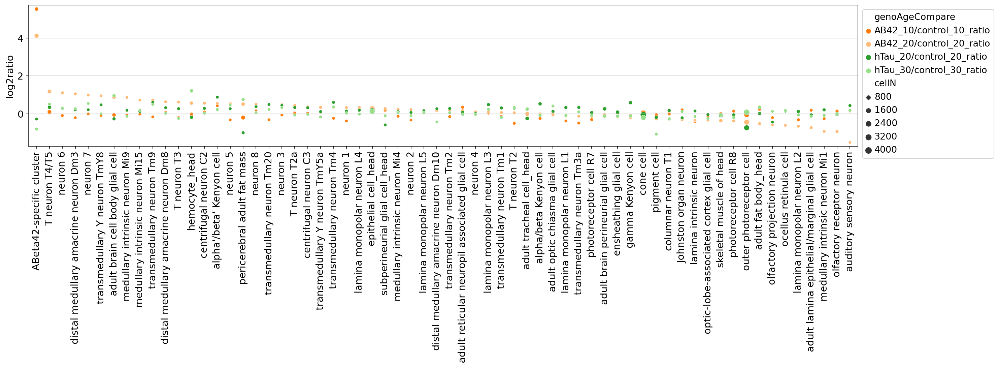

In [56]:
with rc_context({'figure.figsize': (20, 7.5)}):
    ax=sns.scatterplot(data=dotplot_Df, 
                       x="annotation", y="log2ratio", hue="genoAgeCompare", size='cellN', palette=sns.color_palette("tab20")[2:6]) # palette=set2Color_L # palette='Set2', 
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    plt.tight_layout()
    ax.margins(0.01, 0.03)
    plt.savefig(f'{figure2PicFolder}/{adfcaTissue}_dotplot_cellRatio_normalizeToControl.pdf')
    plt.show()

# for x in os.listdir('figures/'): 
#     os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

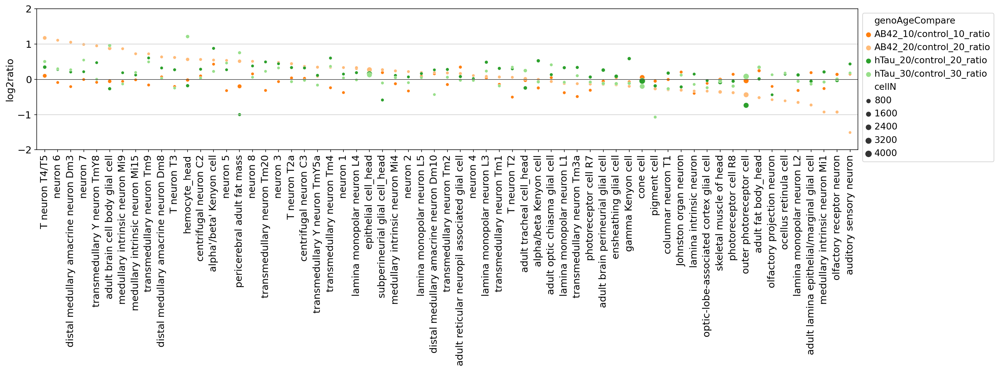

In [57]:
with rc_context({'figure.figsize': (20, 7.5)}):
    ax=sns.scatterplot(data=dotplot_Df[dotplot_Df.annotation != 'ABeta42-specific cluster'], 
                       x="annotation", y="log2ratio", hue="genoAgeCompare", size='cellN', palette=sns.color_palette("tab20")[2:6]) # palette=set2Color_L # palette='Set2', 
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    plt.tight_layout()
    ax.margins(0.01, 0.03)
    plt.ylim(-2, 2)
    plt.savefig(f'{figure2PicFolder}/{adfcaTissue}_dotplot_cellRatio_normalizeToControl_noABcluster.pdf')
    plt.show()

# for x in os.listdir('figures/'): 
#     os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

In [68]:
ct_L = dotplot_Df[ (dotplot_Df.genoAgeCompare == 'AB42_20/control_20_ratio')].sort_values(by='log2ratio').annotation[:8].to_list()
ct_L

barPlot_Df = dotplot_Df[dotplot_Df.annotation.isin(ct_L)].sort_values(by='log2ratio', ascending=False)
barPlot_Df.annotation = pd.Categorical(barPlot_Df.annotation, categories=ct_L)
barPlot_Df.genoAgeCompare = pd.Categorical(barPlot_Df.genoAgeCompare, categories=['AB42_10/control_10_ratio', 'AB42_20/control_20_ratio', 'hTau_20/control_20_ratio', 'hTau_30/control_30_ratio'])
barPlot_Df.head()

,annotation,genoAgeCompare,log2ratio,cellN
191,auditory sensory neuron,hTau_20/control_20_ratio,0.434099,310
248,adult fat body_head,hTau_30/control_30_ratio,0.341002,903
56,adult fat body_head,AB42_10/control_10_ratio,0.243655,549
189,medullary intrinsic neuron Mi1,hTau_20/control_20_ratio,0.208387,514
60,adult lamina epithelial/marginal glial cell,AB42_10/control_10_ratio,0.187788,305


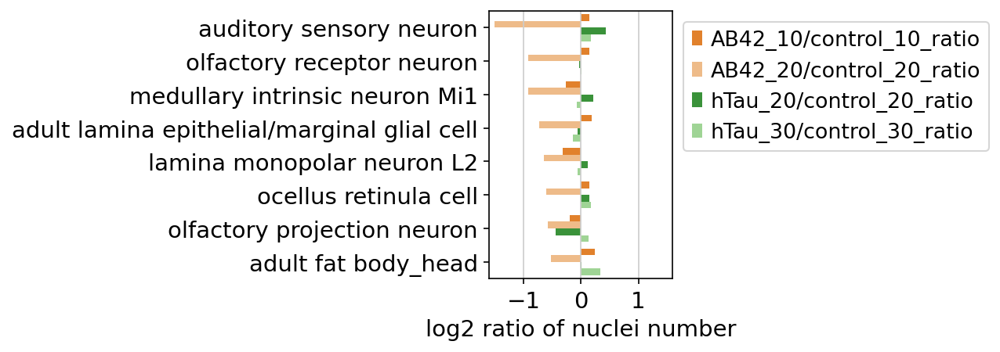

In [69]:
fig, ax = plt.subplots(figsize=(2, 3))
sns.barplot(x='log2ratio', y='annotation', hue='genoAgeCompare', data=barPlot_Df, palette=sns.color_palette("tab20")[2:6], ax=ax)
plt.legend(bbox_to_anchor=(1.0, 1.0))
plt.xlim(-1.6, 1.6)
plt.xlabel('log2 ratio of nuclei number')
plt.ylabel('')
plt.savefig(f'{figure2PicFolder}/{adfcaTissue}_barplot_cellRatio_normalizeToControl_lowestAB42_8celltypes.pdf', bbox_inches='tight')

In [70]:
ct_L = dotplot_Df[ (dotplot_Df.genoAgeCompare == 'AB42_20/control_20_ratio')].sort_values(by='log2ratio').annotation[:5].to_list()
ct_L

barPlot_Df = dotplot_Df[dotplot_Df.annotation.isin(ct_L)].sort_values(by='log2ratio', ascending=False)
barPlot_Df.annotation = pd.Categorical(barPlot_Df.annotation, categories=ct_L)
barPlot_Df.genoAgeCompare = pd.Categorical(barPlot_Df.genoAgeCompare, categories=['AB42_10/control_10_ratio', 'AB42_20/control_20_ratio', 'hTau_20/control_20_ratio', 'hTau_30/control_30_ratio'])
barPlot_Df.head()

,annotation,genoAgeCompare,log2ratio,cellN
191,auditory sensory neuron,hTau_20/control_20_ratio,0.434099,310
189,medullary intrinsic neuron Mi1,hTau_20/control_20_ratio,0.208387,514
60,adult lamina epithelial/marginal glial cell,AB42_10/control_10_ratio,0.187788,305
255,auditory sensory neuron,hTau_30/control_30_ratio,0.178249,220
63,auditory sensory neuron,AB42_10/control_10_ratio,0.147558,181


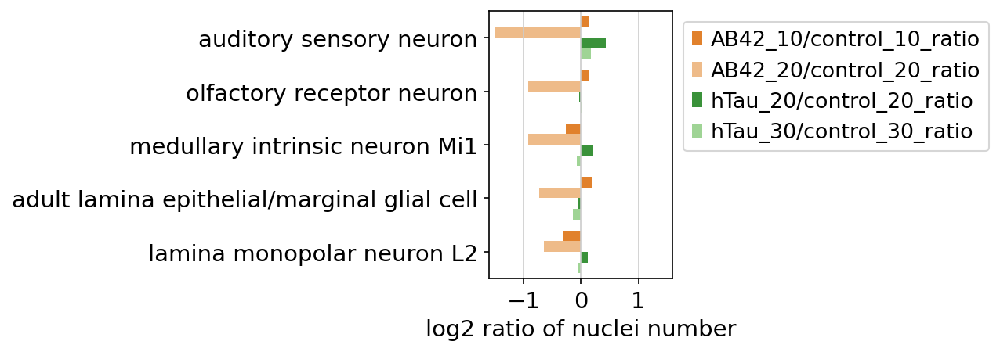

In [72]:
fig, ax = plt.subplots(figsize=(2, 3))
sns.barplot(x='log2ratio', y='annotation', hue='genoAgeCompare', data=barPlot_Df, palette=sns.color_palette("tab20")[2:6], ax=ax)
plt.legend(bbox_to_anchor=(1.0, 1.0))
plt.xlim(-1.6, 1.6)
plt.xlabel('log2 ratio of nuclei number')
plt.ylabel('')
plt.savefig(f'{figure2PicFolder}/{adfcaTissue}_barplot_cellRatio_normalizeToControl_lowestAB42.pdf', bbox_inches='tight')

In [73]:
annotationDf.to_csv(f'{cellnFolder}/{adfcaTissue}_cellN.csv')

In [74]:
ratioDf.to_csv(f'{cellnFolder}/{adfcaTissue}_ratioDf.csv')
dotplot_Df.to_csv(f'{cellnFolder}/{adfcaTissue}_ratioDf_dotplot_Df.csv')

In [75]:
normalRatio_Df.to_csv(f'{cellnFolder}/{adfcaTissue}_normalRatioDf_normalizeToControl.csv')
normalRatioNoLog2_Df.to_csv(f'{cellnFolder}/{adfcaTissue}_normalRatioNoLog2_Df_normalizeToControl.csv')
normalRatio_longDf.to_csv(f'{cellnFolder}/{adfcaTissue}_normalRatio_longDf_normalizeToControl.csv')

In [60]:
normalRatio_Df_head = pd.read_csv(f'{figure2Folder}/cellN/head_normalRatioDf_normalizeToControl.csv', index_col=0)
normalRatio_Df_body = pd.read_csv(f'{figure3Folder}/cellN/body_normalRatioDf_normalizeToControl.csv', index_col=0)
normalRatio_Df_body

FileNotFoundError: [Errno 2] No such file or directory: 'Analysis/Figure/Figure3/cellN/body_normalRatioDf_normalizeToControl.csv'

In [52]:
headRatio_Df = pd.read_csv(f'{figure2Folder}/cellN/head_ratioDf.csv', index_col=0)
bodyRatio_Df = pd.read_csv(f'{figure3Folder}/cellN/body_ratioDf.csv', index_col=0)
headRatio_Df

FileNotFoundError: [Errno 2] No such file or directory: 'Analysis/Figure/Figure3/cellN/body_ratioDf.csv'

In [ ]:
mergeRatio_Df = pd.concat([headRatio_Df, bodyRatio_Df], axis=0)
mergeRatio_Df

,control_10_ratio,control_20_ratio,control_30_ratio,AB42_10_ratio,AB42_20_ratio,hTau_20_ratio,hTau_30_ratio
lobula columnar neuron LC12,0.000071,0.000084,0.000064,0.000042,0.000067,0.000118,0.000022
adult reticular neuropil associated glial cell_head,0.000161,0.000118,0.000086,0.000146,0.000089,0.000067,0.000065
octopaminergic/tyraminergic neuron,0.000357,0.000219,0.000235,0.000355,0.000178,0.000354,0.000479
Ldh-high neuron,0.000447,0.002329,0.011398,0.020579,0.040377,0.001920,0.006511
neuron 16,0.000465,0.000641,0.000727,0.000710,0.000712,0.000792,0.000653
...,...,...,...,...,...,...,...
epithelial cell_body,0.068527,0.046305,0.131869,0.061457,0.057713,0.167282,0.142091
indirect flight muscle,0.072367,0.079007,0.077712,0.057868,0.112212,0.098266,0.037092
muscle cell,0.087507,0.067850,0.114238,0.074696,0.071064,0.174386,0.123628
follicle cell,0.153725,0.165799,0.090719,0.184804,0.142923,0.149809,0.114022


In [ ]:
ageCompare_Df

,expSet,controlSet,compare1,compare2
0,control_20,control_10,control_20_control_10,control_20/control_10
1,control_30,control_20,control_30_control_20,control_30/control_20
2,AB42_20,AB42_10,AB42_20_AB42_10,AB42_20/AB42_10
3,hTau_30,hTau_20,hTau_30_hTau_20,hTau_30/hTau_20


In [ ]:
genoAgeCompare_L = [ f'{exp}/{ref}' for n, ref in enumerate(genoAge_L[:-1]) for exp in genoAge_L[n+1:] ]
genoAgeCompare_L

['control_20/control_10',
 'control_30/control_10',
 'AB42_10/control_10',
 'AB42_20/control_10',
 'hTau_20/control_10',
 'hTau_30/control_10',
 'control_30/control_20',
 'AB42_10/control_20',
 'AB42_20/control_20',
 'hTau_20/control_20',
 'hTau_30/control_20',
 'AB42_10/control_30',
 'AB42_20/control_30',
 'hTau_20/control_30',
 'hTau_30/control_30',
 'AB42_20/AB42_10',
 'hTau_20/AB42_10',
 'hTau_30/AB42_10',
 'hTau_20/AB42_20',
 'hTau_30/AB42_20',
 'hTau_30/hTau_20']

## compare between all age groups

In [34]:
normalRatio_Df = mergeRatio_Df[:]
normalRatio_Df=normalRatio_Df.drop(['unannotated', 'uncharacterized CNS neuron'], axis=0)
for genoAge in ageCompare_Df.compare2:
# for genoAge in expCompare_Df.compare2.to_list() + ageCompare_Df.compare2.to_list()[:2]:
    # print(genoAge)
    expCol, refCol = genoAge.split('/')
    print(expCol, refCol)
    normalRatio_Df[genoAge] = normalRatio_Df[f'{expCol}_ratio']/normalRatio_Df[f'{refCol}_ratio']
    
normalRatio_Df = normalRatio_Df.iloc[:,7:]
normalRatio_Df = np.log2(normalRatio_Df)
normalRatio_Df.replace([-np.inf], -5, inplace=True)
normalRatio_Df.replace([np.inf], 7, inplace=True)
dropNa_L = normalRatio_Df.isna().sum(axis=1)[normalRatio_Df.isna().sum(axis=1) != 0].index.to_list()
normalRatio_Df = normalRatio_Df.drop(dropNa_L, axis=0)
normalRatio_Df

control_20 control_10
control_30 control_20
AB42_20 AB42_10
hTau_30 hTau_20


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/pandas/core/internals/blocks.py:351: RuntimeWarning: divide by zero encountered in log2
  result = func(self.values, **kwargs)


,control_20/control_10,control_30/control_20,AB42_20/AB42_10,hTau_30/hTau_20
lobula columnar neuron LC12,0.239250,-0.395511,0.676351,-2.436834
adult reticular neuropil associated glial cell_head,-0.445249,-0.465901,-0.715967,-0.044516
octopaminergic/tyraminergic neuron,-0.704167,0.100446,-0.996074,0.437636
Ldh-high neuron,2.381990,2.290921,0.972367,1.761633
neuron 16,0.464809,0.180989,0.003926,-0.277177
...,...,...,...,...
epithelial cell_body,-0.565513,1.509875,-0.090677,-0.235467
indirect flight muscle,0.126652,-0.023846,0.955384,-1.405559
muscle cell,-0.367049,0.751630,-0.071908,-0.496283
follicle cell,0.109083,-0.869964,-0.370753,-0.393813


In [35]:
normalRatio_Df.isna().sum(axis=1)[normalRatio_Df.isna().sum(axis=1) != 0]

Series([], dtype: int64)

In [36]:
normalRatio_Df.max(axis=1).sort_values()

transmedullary neuron Tm20                              -0.307381
16-cell germline cyst in germarium region 2a and 2b     -0.198484
transmedullary neuron Tm4                               -0.173111
proximal medullary amacrine neuron Pm2                  -0.129221
adult hindgut                                           -0.119101
                                                           ...   
mechanosensory neuron of haltere                         2.993749
choriogenic main body follicle cell and corpus luteum    3.738488
ejaculatory bulb epithelium                              3.923670
male accessory gland main cell_roX1-                     4.062331
young germ cell                                          7.000000
Length: 166, dtype: float64

In [37]:
normalRatioN700_Df = normalRatio_Df[normalRatio_Df.index.isin(celltypeN700_L)]

In [38]:
normalRatioNeuron_Df = normalRatioN700_Df[normalRatioN700_Df.index.isin(neuronCellType_L)]
normalRatioNonNeuron_Df = normalRatioN700_Df[normalRatioN700_Df.index.isin(nonNeuronCellType_L)]

### heatmap

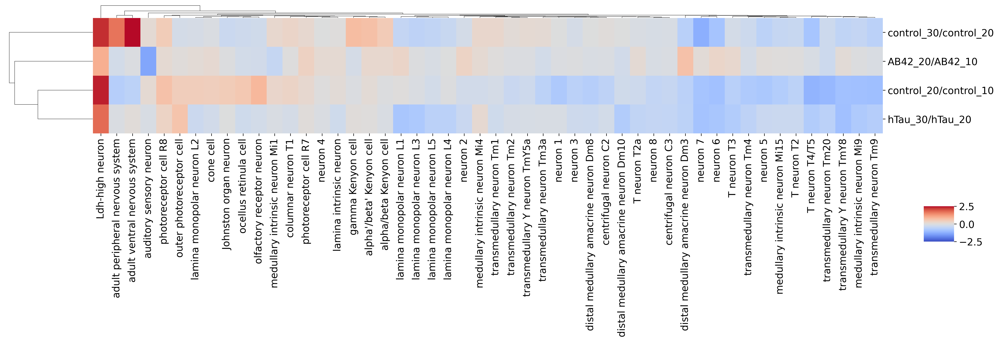

In [39]:
# neuronCell
ax = sns.clustermap(normalRatioNeuron_Df.T, figsize=(20, 7), xticklabels=True, cmap='coolwarm', dendrogram_ratio=0.1, vmax=2.5, vmin=-2.5, ) # 
ax.ax_cbar.set_position((0.92, .30, .03, .10))

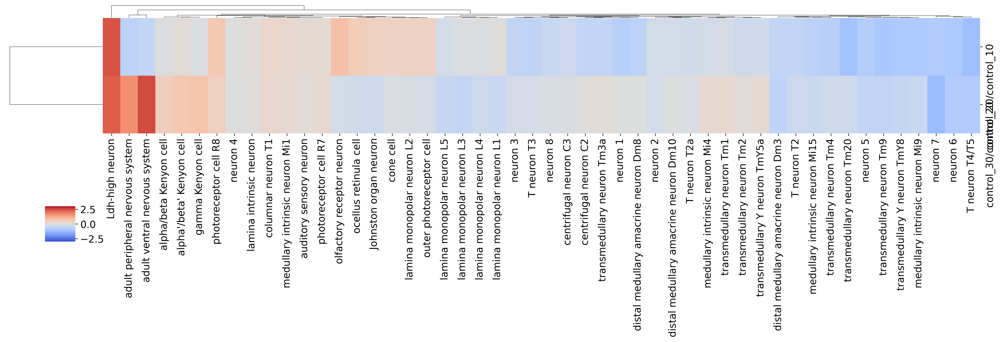

In [40]:
# neuronCell: only control samples
ax = sns.clustermap(normalRatioNeuron_Df.T.iloc[:2,:], figsize=(20, 7), xticklabels=True, cmap='coolwarm', dendrogram_ratio=0.1, vmax=3, vmin=-3, ) # 
ax.ax_cbar.set_position((0.05, .30, .03, .10))

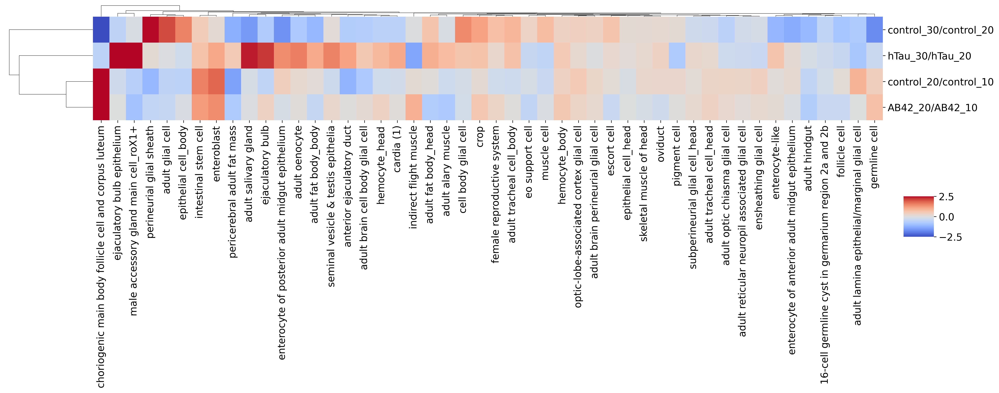

In [41]:
### non-neuronal cells
ax = sns.clustermap(normalRatioNonNeuron_Df.T, figsize=(20, 8), xticklabels=True, cmap='coolwarm', dendrogram_ratio=0.1,  vmax=2.5, vmin=-2.5,) #
ax.ax_cbar.set_position((0.90, .40, .03, .10))

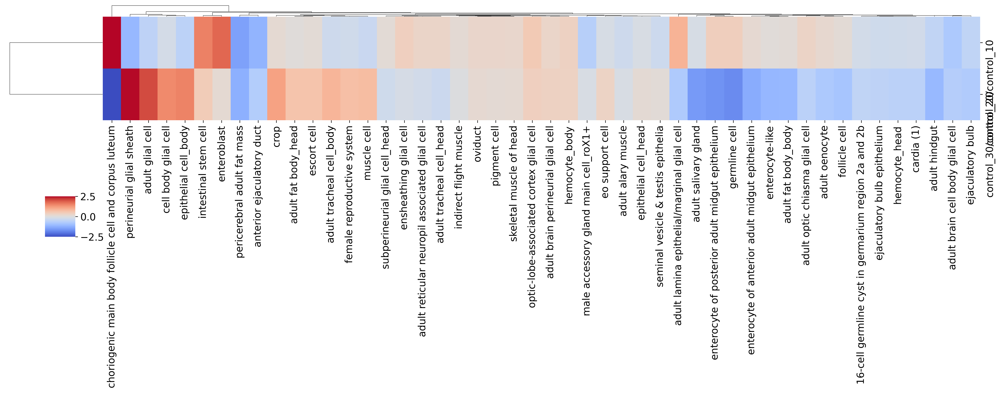

In [42]:
### non-neuronal cells: only control
ax = sns.clustermap(normalRatioNonNeuron_Df.iloc[:,:2].T, figsize=(20, 8), xticklabels=True, cmap='coolwarm', dendrogram_ratio=0.1,  vmax=2.5, vmin=-2.5,) #
ax.ax_cbar.set_position((0.05, .40, .03, .10))

### Dot plots - load data

In [43]:
annotationHeadDf = pd.read_csv(f'{cellnFolder}/head_cellN.csv')
annotationBodyDf = pd.read_csv(f'{cellnFolder}/body_cellN.csv')

In [44]:
annotationHeadDf.index = annotationHeadDf.adfca_annotation.to_list()
annotationBodyDf.index = annotationBodyDf.adfca_annotation.to_list()
annotationHeadDf

,adfca_annotation,TotalCellN,control_10_CellN,control_20_CellN,control_30_CellN,AB42_10_CellN,AB42_20_CellN,hTau_20_CellN,hTau_30_CellN
uncharacterized CNS neuron,uncharacterized CNS neuron,97699,14580,16171,14415,11777,10141,17150,13465
unannotated,unannotated,28960,5215,4732,2992,4666,4114,4133,3108
outer photoreceptor cell,outer photoreceptor cell,27001,3879,5563,3868,3225,3111,3342,4013
cone cell,cone cell,24412,3207,4573,3421,2844,3013,4432,2922
epithelial cell_head,epithelial cell_head,21395,3209,3143,2696,3077,2879,3505,2886
...,...,...,...,...,...,...,...,...,...
antennal lobe projection neuron,antennal lobe projection neuron,178,27,48,34,13,9,22,25
octopaminergic/tyraminergic neuron,octopaminergic/tyraminergic neuron,112,20,13,11,17,8,21,22
crystal cell_head,crystal cell_head,90,27,11,6,19,15,6,6
adult reticular neuropil associated glial cell_head,adult reticular neuropil associated glial cell...,38,9,7,4,7,4,4,3


In [45]:
annotationHeadDf.index = annotationHeadDf.adfca_annotation.to_list()
annotationBodyDf.index = annotationBodyDf.adfca_annotation.to_list()

In [46]:
annotationMergeDf = pd.concat([annotationHeadDf, annotationBodyDf], axis=0)
annotationMergeDf = annotationMergeDf.loc[ normalRatio_Df.index.to_list() ]
annotationMergeDf

,adfca_annotation,TotalCellN,control_10_CellN,control_20_CellN,control_30_CellN,AB42_10_CellN,AB42_20_CellN,hTau_20_CellN,hTau_30_CellN
lobula columnar neuron LC12,lobula columnar neuron LC12,25,4,5,3,2,3,7,1
adult reticular neuropil associated glial cell_head,adult reticular neuropil associated glial cell...,38,9,7,4,7,4,4,3
octopaminergic/tyraminergic neuron,octopaminergic/tyraminergic neuron,112,20,13,11,17,8,21,22
Ldh-high neuron,Ldh-high neuron,3908,25,138,533,985,1814,114,299
neuron 16,neuron 16,241,26,38,34,34,32,47,30
...,...,...,...,...,...,...,...,...,...
epithelial cell_body,epithelial cell_body,24734,3087,1743,3650,3254,1742,7841,3417
indirect flight muscle,indirect flight muscle,20334,3260,2974,2151,3064,3387,4606,892
muscle cell,muscle cell,26905,3942,2554,3162,3955,2145,8174,2973
follicle cell,follicle cell,39540,6925,6241,2511,9785,4314,7022,2742


In [47]:
# dfAll=pd.concat([normalRatio_Df, 
#            annotationMergeDf.loc[normalRatio_Df.index.to_list(),:].drop(annotationMergeDf.columns[:5].to_list(), axis=1)], 
#           axis=1)
dfAll=pd.concat([normalRatio_Df, 
           annotationMergeDf.loc[normalRatio_Df.index.to_list(),:].iloc[:, [3, 4, 6, 8] ]], axis=1)

dfAll.insert(0, 'annotation', dfAll.index.to_list())
# dfAll

In [49]:
dfAll#.columns.to_list()[:5] + ageCompare_Df.compare2.to_list()

,annotation,control_20/control_10,control_30/control_20,AB42_20/AB42_10,hTau_30/hTau_20,control_20_CellN,control_30_CellN,AB42_20_CellN,hTau_30_CellN
lobula columnar neuron LC12,lobula columnar neuron LC12,0.239250,-0.395511,0.676351,-2.436834,5,3,3,1
adult reticular neuropil associated glial cell_head,adult reticular neuropil associated glial cell...,-0.445249,-0.465901,-0.715967,-0.044516,7,4,4,3
octopaminergic/tyraminergic neuron,octopaminergic/tyraminergic neuron,-0.704167,0.100446,-0.996074,0.437636,13,11,8,22
Ldh-high neuron,Ldh-high neuron,2.381990,2.290921,0.972367,1.761633,138,533,1814,299
neuron 16,neuron 16,0.464809,0.180989,0.003926,-0.277177,38,34,32,30
...,...,...,...,...,...,...,...,...,...
epithelial cell_body,epithelial cell_body,-0.565513,1.509875,-0.090677,-0.235467,1743,3650,1742,3417
indirect flight muscle,indirect flight muscle,0.126652,-0.023846,0.955384,-1.405559,2974,2151,3387,892
muscle cell,muscle cell,-0.367049,0.751630,-0.071908,-0.496283,2554,3162,2145,2973
follicle cell,follicle cell,0.109083,-0.869964,-0.370753,-0.393813,6241,2511,4314,2742


### dotplot : Neuron

In [50]:
dfAllNeuron = dfAll[dfAll.index.isin(neuronCellType_L)]
dfAllNeuron.shape

(50, 9)

In [51]:
dfAllNeuron.sort_values(by=['control_30/control_20'], ascending=False, inplace=True)

/tmp/ipykernel_809779/1365541444.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfAllNeuron.sort_values(by=['control_30/control_20'], ascending=False, inplace=True)


In [52]:
dfAllNeuron.head()

,annotation,control_20/control_10,control_30/control_20,AB42_20/AB42_10,hTau_30/hTau_20,control_20_CellN,control_30_CellN,AB42_20_CellN,hTau_30_CellN
adult ventral nervous system,adult ventral nervous system,-0.559930,2.474397,-0.049207,0.075873,509,2080,665,1327
Ldh-high neuron,Ldh-high neuron,2.381990,2.290921,0.972367,1.761633,138,533,1814,299
adult peripheral nervous system,adult peripheral nervous system,-0.658969,1.660581,-0.210147,-0.064884,154,358,171,335
gamma Kenyon cell,gamma Kenyon cell,-0.047345,0.753580,-0.169445,0.053902,496,660,328,599
alpha'/beta' Kenyon cell,alpha'/beta' Kenyon cell,0.101746,0.690064,0.209040,0.036784,150,191,166,219


In [53]:
dotplotNeuron_Df=dfAllNeuron.melt(id_vars=['annotation'], value_vars=list(dfAllNeuron.columns[1:5]), 
                      var_name='ageCompare', value_name='log2ratio')
# dotplotNeuron_Df

dotplotNeuron_Df=pd.concat([dotplotNeuron_Df, 
           dfAllNeuron.melt(id_vars=['annotation'], value_vars=list(dfAllNeuron.columns[5:]), 
                      var_name='ageCompare', value_name='cellN').iloc[:,2] ], 
          axis=1) # 

In [54]:
dotplotNeuron_Df

,annotation,ageCompare,log2ratio,cellN
0,adult ventral nervous system,control_20/control_10,-0.559930,509
1,Ldh-high neuron,control_20/control_10,2.381990,138
2,adult peripheral nervous system,control_20/control_10,-0.658969,154
3,gamma Kenyon cell,control_20/control_10,-0.047345,496
4,alpha'/beta' Kenyon cell,control_20/control_10,0.101746,150
...,...,...,...,...
195,transmedullary neuron Tm9,hTau_30/hTau_20,-0.682220,94
196,distal medullary amacrine neuron Dm3,hTau_30/hTau_20,-0.547016,90
197,T neuron T4/T5,hTau_30/hTau_20,-0.708023,420
198,neuron 6,hTau_30/hTau_20,-0.858960,58


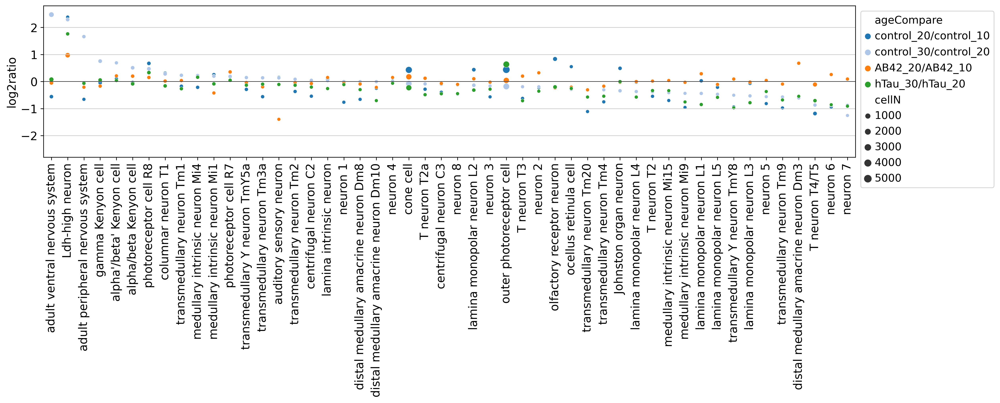

In [75]:
with rc_context({'figure.figsize': (17, 7)}):
    ax=sns.scatterplot(data=dotplotNeuron_Df, 
                       x="annotation", y="log2ratio", hue="ageCompare", size='cellN', palette= sns.color_palette("tab20")[:3] + sns.color_palette("tab20")[4:5]) # palette=set2Color_L
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    plt.tight_layout()
    ax.margins(0.01, 0.05)
    ax.set(ylim=(-2.8, 2.8))
    plt.savefig(f'{figure4PicFolder}/dotplot_neurons_cellRatio_ageCompare.pdf')
    plt.show()

# for x in os.listdir('figures/'): 
#     os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

In [57]:
dotplotNeuron_Df

,annotation,ageCompare,log2ratio,cellN
0,adult ventral nervous system,control_20/control_10,-0.559930,509
1,Ldh-high neuron,control_20/control_10,2.381990,138
2,adult peripheral nervous system,control_20/control_10,-0.658969,154
3,gamma Kenyon cell,control_20/control_10,-0.047345,496
4,alpha'/beta' Kenyon cell,control_20/control_10,0.101746,150
...,...,...,...,...
195,transmedullary neuron Tm9,hTau_30/hTau_20,-0.682220,94
196,distal medullary amacrine neuron Dm3,hTau_30/hTau_20,-0.547016,90
197,T neuron T4/T5,hTau_30/hTau_20,-0.708023,420
198,neuron 6,hTau_30/hTau_20,-0.858960,58


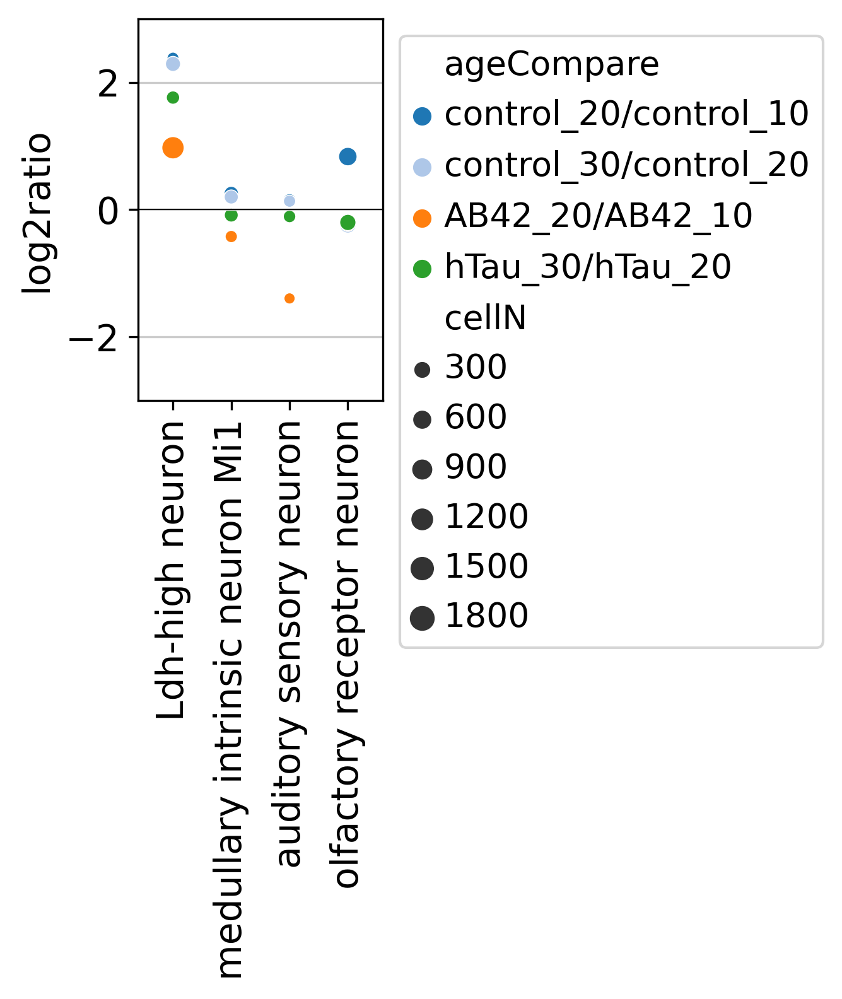

In [80]:
with rc_context({'figure.figsize': (4.5, 5.5)}):
    ax=sns.scatterplot(data=dotplotNeuron_Df[dotplotNeuron_Df.annotation.isin(['Ldh-high neuron', 'auditory sensory neuron', 'medullary intrinsic neuron Mi1', 'olfactory receptor neuron'])],  # 
                       x="annotation", y="log2ratio", hue="ageCompare", size='cellN', palette= sns.color_palette("tab20")[:3] + sns.color_palette("tab20")[4:5]) # palette=set2Color_L
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    plt.tight_layout()
    ax.margins(0.2, 0.05)
    ax.set(ylim=(-3, 3))
    plt.savefig(f'{figure4PicFolder}/dotplot_neurons_selected_cellRatio_ageCompare.pdf')
    plt.show()

# for x in os.listdir('figures/'): 
#     os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

/tmp/ipykernel_809779/475431726.py:2: UserWarning: The palette list has more values (4) than needed (2), which may not be intended.
  ax=sns.scatterplot(data=dotplotNeuron_Df[dotplotNeuron_Df.ageCompare.isin(['control_20/control_10', 'control_30/control_20'])],


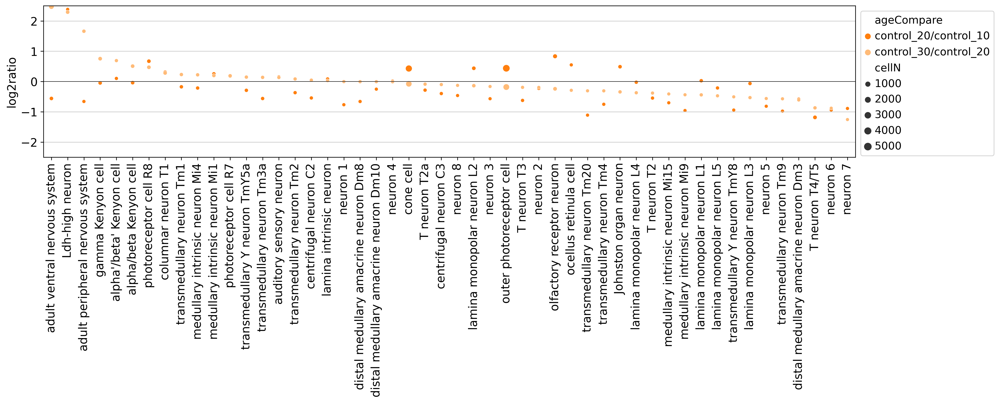

In [59]:
with rc_context({'figure.figsize': (17, 7)}):
    ax=sns.scatterplot(data=dotplotNeuron_Df[dotplotNeuron_Df.ageCompare.isin(['control_20/control_10', 'control_30/control_20'])], 
                       x="annotation", y="log2ratio", hue="ageCompare", size='cellN', palette= sns.color_palette("tab20")[2:4] + sns.color_palette("tab20")[4:6]) # palette=set2Color_L
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    plt.tight_layout()
    ax.margins(0.01, 0.03)
    ax.set(ylim=(-2.5, 2.5))
    # plt.savefig(f'{figure2PicFolder}/allNeurons_dotplot_cellRatio_normalizeToControl.pdf')
    plt.show()

# for x in os.listdir('figures/'): 
#     os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

### dotplot : Non-neuron

In [60]:
dfAllNonNeuron = dfAll[dfAll.index.isin(nonNeuronCellType_L)]
dfAllNonNeuron.shape

(48, 9)

In [61]:
dfAllNonNeuron.sort_values(by=['control_30/control_20'], ascending=False, inplace=True)

/tmp/ipykernel_809779/154828602.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfAllNonNeuron.sort_values(by=['control_30/control_20'], ascending=False, inplace=True)


In [62]:
dfAllNonNeuron.head()

,annotation,control_20/control_10,control_30/control_20,AB42_20/AB42_10,hTau_30/hTau_20,control_20_CellN,control_30_CellN,AB42_20_CellN,hTau_30_CellN
perineurial glial sheath,perineurial glial sheath,-1.096642,2.467799,-0.453911,0.127537,59,240,72,241
adult glial cell,adult glial cell,-0.529376,2.054509,-0.427072,-0.043365,55,168,53,116
epithelial cell_body,epithelial cell_body,-0.565513,1.509875,-0.090677,-0.235467,1743,3650,1742,3417
cell body glial cell,cell body glial cell,-0.179250,1.443551,-0.196403,0.618276,138,276,100,215
crop,crop,0.150491,1.143068,0.574514,0.662969,601,976,517,870


In [63]:
dotplotNonNeuron_Df=dfAllNonNeuron.melt(id_vars=['annotation'], value_vars=list(dfAllNonNeuron.columns[1:5]), 
                      var_name='ageCompare', value_name='log2ratio')
# dotplotNeuron_Df

dotplotNonNeuron_Df=pd.concat([dotplotNonNeuron_Df, 
           dfAllNonNeuron.melt(id_vars=['annotation'], value_vars=list(dfAllNonNeuron.columns[5:]), 
                      var_name='ageCompare', value_name='cellN').iloc[:,2] ], 
          axis=1) # 

In [64]:
dotplotNonNeuron_Df

,annotation,ageCompare,log2ratio,cellN
0,perineurial glial sheath,control_20/control_10,-1.096642,59
1,adult glial cell,control_20/control_10,-0.529376,55
2,epithelial cell_body,control_20/control_10,-0.565513,1743
3,cell body glial cell,control_20/control_10,-0.179250,138
4,crop,control_20/control_10,0.150491,601
...,...,...,...,...
187,enterocyte of anterior adult midgut epithelium,hTau_30/hTau_20,0.155485,116
188,adult salivary gland,hTau_30/hTau_20,2.394556,116
189,enterocyte of posterior adult midgut epithelium,hTau_30/hTau_20,1.394556,174
190,germline cell,hTau_30/hTau_20,-0.349065,520


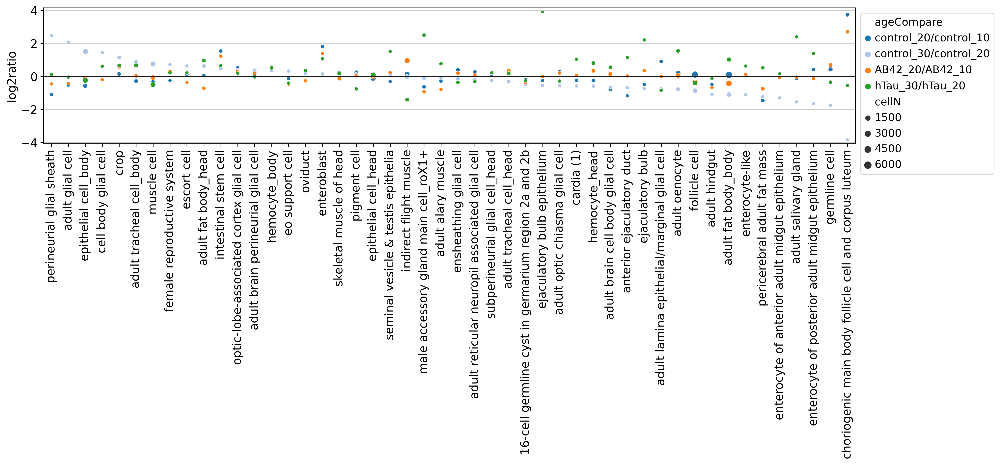

In [76]:
with rc_context({'figure.figsize': (17, 8)}):
    ax=sns.scatterplot(data=dotplotNonNeuron_Df, 
                       x="annotation", y="log2ratio", hue="ageCompare", size='cellN', palette= sns.color_palette("tab20")[:3] + sns.color_palette("tab20")[4:5]) # palette=set2Color_L
    ax.grid(axis='x',visible=False)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xticks(rotation=90)
    plt.xlabel('')
    plt.axhline(0, color='black', linewidth=0.5)
    # plt.tight_layout(w_pad=0.5)
    plt.subplots_adjust(bottom=0.6)
    plt.tight_layout()
    ax.margins(0.01, 0.03)
    plt.savefig(f'{figure4PicFolder}/dotplot_nonNeurons_cellRatio_ageCompare.pdf')
    plt.show()

# for x in os.listdir('figures/'): 
#     os.replace(f'figures/{x}', f'{figure3PicFolder}/{x}')

In [66]:
dfAllNonNeuron_genoAge = pd.read_csv(f'{compositionFolder}/dfAllNonNeuron_normalizeToControl.csv', index_col=0)
dfAllNonNeuron_genoAge.shape

(48, 9)

In [67]:
dfAllNonNeuron_genoAge[['hTau_20/control_20_ratio']].head()

,hTau_20/control_20_ratio
perineurial glial sheath,2.549136
epithelial cell_body,1.853051
adult glial cell,1.766413
muscle cell,1.361870
female reproductive system,1.077578


In [68]:
normalRatioNonNeuron_Df.head()

,control_20/control_10,control_30/control_20,AB42_20/AB42_10,hTau_30/hTau_20
optic-lobe-associated cortex glial cell,0.527116,0.394625,0.312415,0.193644
adult optic chiasma glial cell,0.306560,-0.566979,0.197430,-0.283704
adult lamina epithelial/marginal glial cell,0.905752,-0.757086,-0.011530,-0.841489
subperineurial glial cell_head,0.109967,-0.260515,0.189164,0.222270
adult reticular neuropil associated glial cell,0.273856,-0.216089,0.091388,-0.319934


In [69]:
mergeNormalize_Df = pd.concat([normalRatioNonNeuron_Df, dfAllNonNeuron_genoAge[['hTau_20/control_20_ratio']]], axis=1)
mergeNormalize_Df.rename(columns={'hTau_20/control_20_ratio': 'hTau_20/control_20'}, inplace=True)
mergeNormalize_Df.head()

,control_20/control_10,control_30/control_20,AB42_20/AB42_10,hTau_30/hTau_20,hTau_20/control_20
optic-lobe-associated cortex glial cell,0.527116,0.394625,0.312415,0.193644,-0.037707
adult optic chiasma glial cell,0.306560,-0.566979,0.197430,-0.283704,0.126813
adult lamina epithelial/marginal glial cell,0.905752,-0.757086,-0.011530,-0.841489,-0.052453
subperineurial glial cell_head,0.109967,-0.260515,0.189164,0.222270,-0.587784
adult reticular neuropil associated glial cell,0.273856,-0.216089,0.091388,-0.319934,0.076380


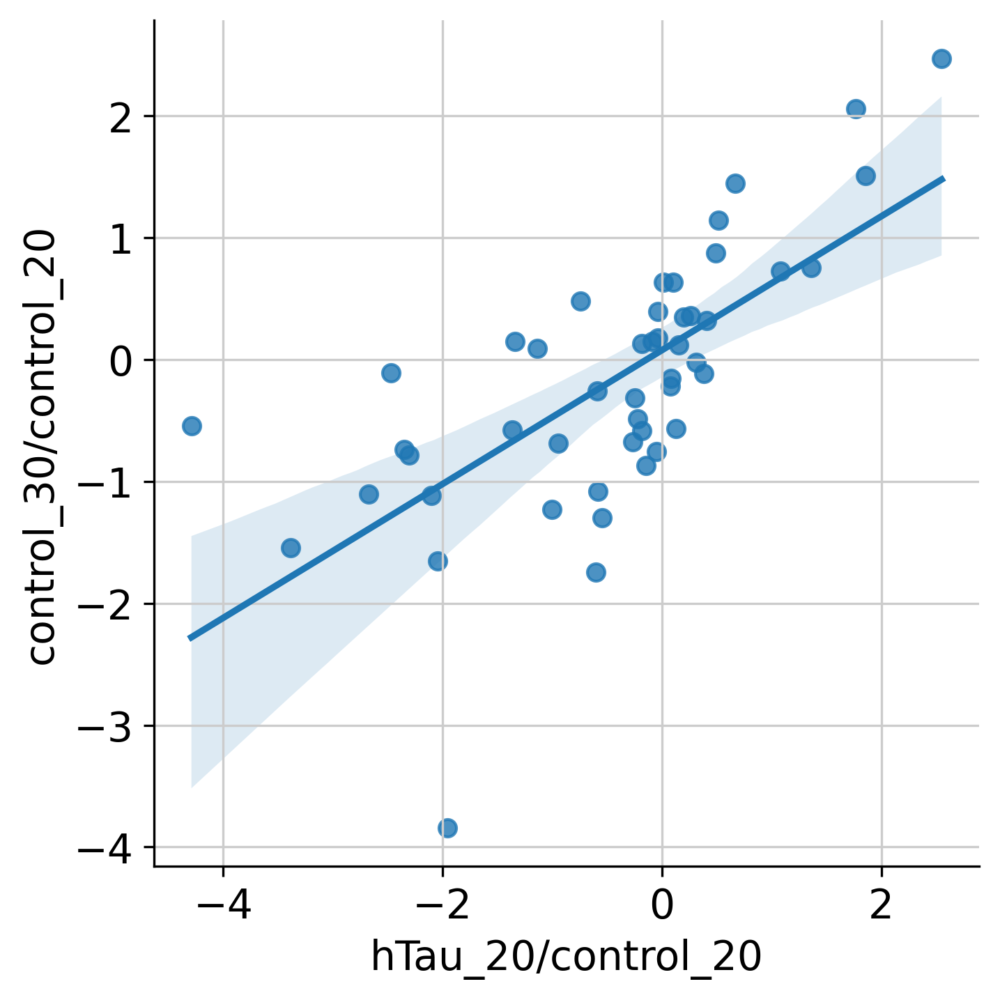

In [70]:
sns.lmplot(x="hTau_20/control_20", y="control_30/control_20", data=mergeNormalize_Df)

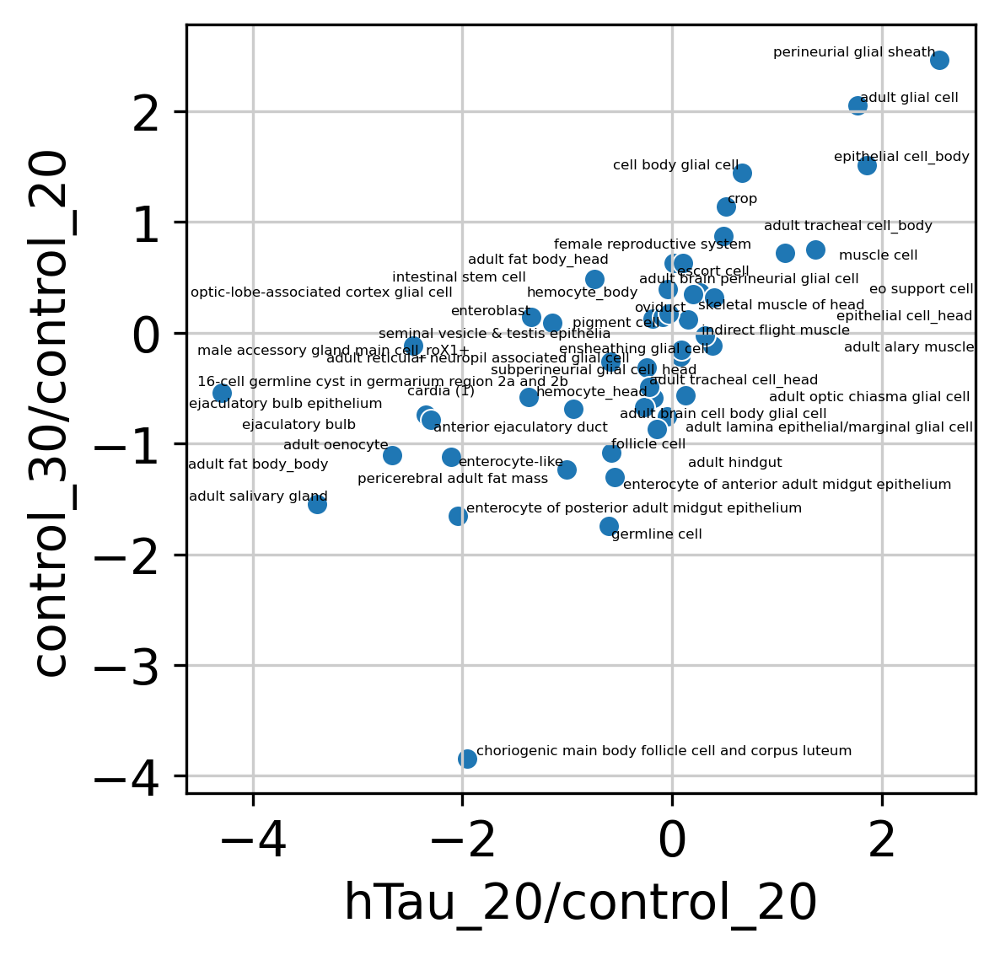

In [71]:
sns.scatterplot(data=mergeNormalize_Df, x="hTau_20/control_20", y="control_30/control_20")
texts = [plt.text(x=mergeNormalize_Df['hTau_20/control_20'][n], y=mergeNormalize_Df['control_30/control_20'][n], s=mergeNormalize_Df.index[n], fontsize=4) 
         for n, cellType in enumerate(mergeNormalize_Df.index)]
adjust_text(texts, ) # arrowprops=dict(arrowstyle='->', color='red') # arrowprops=dict(arrowstyle="-", color='k', lw=0.5)
plt.show()

# Fig 4B compare between all genoAge groups: proof of premature aging

## cell composition

In [27]:
headRatio_Df = pd.read_csv(f'{cellnFolder}/head_ratioDf.csv', index_col=0)
bodyRatio_Df = pd.read_csv(f'{cellnFolder}/body_ratioDf.csv', index_col=0)
# headRatio_Df

In [28]:
mergeRatio_Df = pd.concat([headRatio_Df, bodyRatio_Df], axis=0)
mergeRatio_Df

,control_10_ratio,control_20_ratio,control_30_ratio,AB42_10_ratio,AB42_20_ratio,hTau_20_ratio,hTau_30_ratio
lobula columnar neuron LC12,0.000071,0.000084,0.000064,0.000042,0.000067,0.000118,0.000022
adult reticular neuropil associated glial cell_head,0.000161,0.000118,0.000086,0.000146,0.000089,0.000067,0.000065
octopaminergic/tyraminergic neuron,0.000357,0.000219,0.000235,0.000355,0.000178,0.000354,0.000479
Ldh-high neuron,0.000447,0.002329,0.011398,0.020579,0.040377,0.001920,0.006511
neuron 16,0.000465,0.000641,0.000727,0.000710,0.000712,0.000792,0.000653
...,...,...,...,...,...,...,...
epithelial cell_body,0.068527,0.046305,0.131869,0.061457,0.057713,0.167282,0.142091
indirect flight muscle,0.072367,0.079007,0.077712,0.057868,0.112212,0.098266,0.037092
muscle cell,0.087507,0.067850,0.114238,0.074696,0.071064,0.174386,0.123628
follicle cell,0.153725,0.165799,0.090719,0.184804,0.142923,0.149809,0.114022


In [29]:
normalRatio_Df = mergeRatio_Df[:]
normalRatio_Df=normalRatio_Df.drop(['unannotated', 'uncharacterized CNS neuron'], axis=0)
for genoAge in genoAgeCompare_L:
# for genoAge in expCompare_Df.compare2.to_list() + ageCompare_Df.compare2.to_list()[:2]:
    # print(genoAge)
    expCol, refCol = genoAge.split('/')
    # print(expCol, refCol)
    normalRatio_Df[genoAge] = normalRatio_Df[f'{expCol}_ratio']/normalRatio_Df[f'{refCol}_ratio']
    
normalRatio_Df = normalRatio_Df.iloc[:,7:]
normalRatio_Df = np.log2(normalRatio_Df)
normalRatio_Df.replace([-np.inf], -5, inplace=True)
normalRatio_Df.replace([np.inf], 7, inplace=True)
dropNa_L = normalRatio_Df.isna().sum(axis=1)[normalRatio_Df.isna().sum(axis=1) != 0].index.to_list()
normalRatio_Df = normalRatio_Df.drop(dropNa_L, axis=0)
normalRatio_Df

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/pandas/core/internals/blocks.py:351: RuntimeWarning: divide by zero encountered in log2
  result = func(self.values, **kwargs)


,hTau_20/control_20,hTau_30/control_30,AB42_10/control_10,AB42_20/control_20,control_30/control_20,control_20/control_10
lobula columnar neuron LC12,0.482605,-1.558717,-0.774859,-0.337758,-0.395511,0.239250
adult reticular neuropil associated glial cell_head,-0.810177,-0.388792,-0.137429,-0.408147,-0.465901,-0.445249
octopaminergic/tyraminergic neuron,0.689056,1.026245,-0.009324,-0.301232,0.100446,-0.704167
Ldh-high neuron,-0.278456,-0.807745,5.525265,4.115642,2.290921,2.381990
neuron 16,0.303840,-0.154327,0.612164,0.151281,0.180989,0.464809
...,...,...,...,...,...,...
epithelial cell_body,1.853051,0.107709,-0.157104,0.317731,1.509875,-0.565513
indirect flight muscle,0.314696,-1.067017,-0.322569,0.506163,-0.023846,0.126652
muscle cell,1.361870,0.113957,-0.228363,0.066778,0.751630,-0.367049
follicle cell,-0.146309,0.329841,0.265645,-0.214192,-0.869964,0.109083


In [30]:
normalRatio_Df.isna().sum(axis=1)[normalRatio_Df.isna().sum(axis=1) != 0]

Series([], dtype: int64)

In [31]:
normalRatio_Df.max(axis=1).sort_values()

male accessory gland secondary cell                     -0.291895
adult reticular neuropil associated glial cell_head     -0.137429
crystal cell_body                                        0.030851
spermatocyte                                             0.086165
neuron 4                                                 0.105849
                                                           ...   
gustatory receptor neuron                                3.005514
visceral muscle of the crop                              3.372885
choriogenic main body follicle cell and corpus luteum    3.738488
Ldh-high neuron                                          5.525265
young germ cell                                          7.000000
Length: 166, dtype: float64

In [32]:
normalRatioN700_Df = normalRatio_Df[normalRatio_Df.index.isin(celltypeN700_L)]

In [33]:
normalRatio_Df

,hTau_20/control_20,hTau_30/control_30,AB42_10/control_10,AB42_20/control_20,control_30/control_20,control_20/control_10
lobula columnar neuron LC12,0.482605,-1.558717,-0.774859,-0.337758,-0.395511,0.239250
adult reticular neuropil associated glial cell_head,-0.810177,-0.388792,-0.137429,-0.408147,-0.465901,-0.445249
octopaminergic/tyraminergic neuron,0.689056,1.026245,-0.009324,-0.301232,0.100446,-0.704167
Ldh-high neuron,-0.278456,-0.807745,5.525265,4.115642,2.290921,2.381990
neuron 16,0.303840,-0.154327,0.612164,0.151281,0.180989,0.464809
...,...,...,...,...,...,...
epithelial cell_body,1.853051,0.107709,-0.157104,0.317731,1.509875,-0.565513
indirect flight muscle,0.314696,-1.067017,-0.322569,0.506163,-0.023846,0.126652
muscle cell,1.361870,0.113957,-0.228363,0.066778,0.751630,-0.367049
follicle cell,-0.146309,0.329841,0.265645,-0.214192,-0.869964,0.109083


In [35]:
normalRatio_Df.to_csv(f'{cellnFig4Folder}/normalRatio_Df_genoAge.csv')

In [36]:
normalRatioNeuron_Df = normalRatioN700_Df[normalRatioN700_Df.index.isin(neuronCellType_L)]
normalRatioNonNeuron_Df = normalRatioN700_Df[normalRatioN700_Df.index.isin(nonNeuronCellType_L)]

In [37]:
normalRatioNeuron_Df.to_csv(f'{cellnFig4Folder}/normalRatioNeuron_Df_genoAge.csv')
normalRatioNonNeuron_Df.to_csv(f'{cellnFig4Folder}/normalRatioNonNeuron_Df_genoAge.csv')

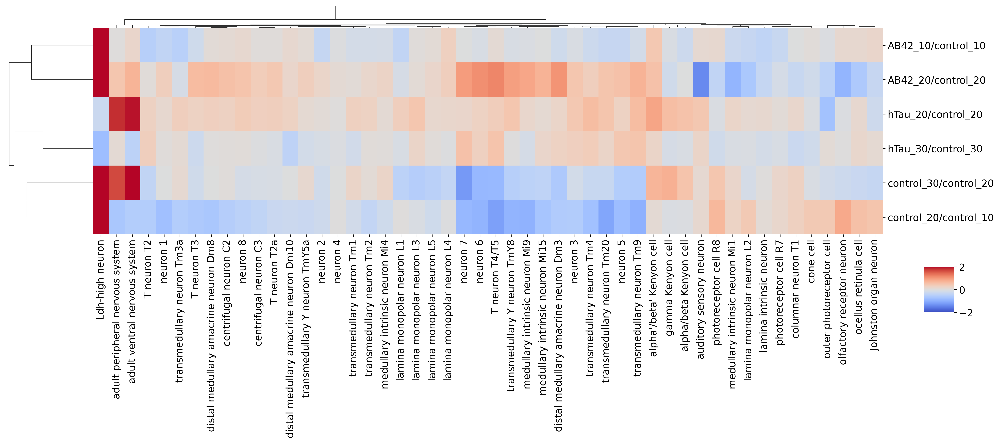

In [38]:
# neuronCell
ax = sns.clustermap(normalRatioNeuron_Df.T, vmax=2, vmin=-2, figsize=(20, 9), xticklabels=True, cmap='coolwarm', dendrogram_ratio=0.1)
ax.ax_cbar.set_position((0.92, .30, .03, .10))

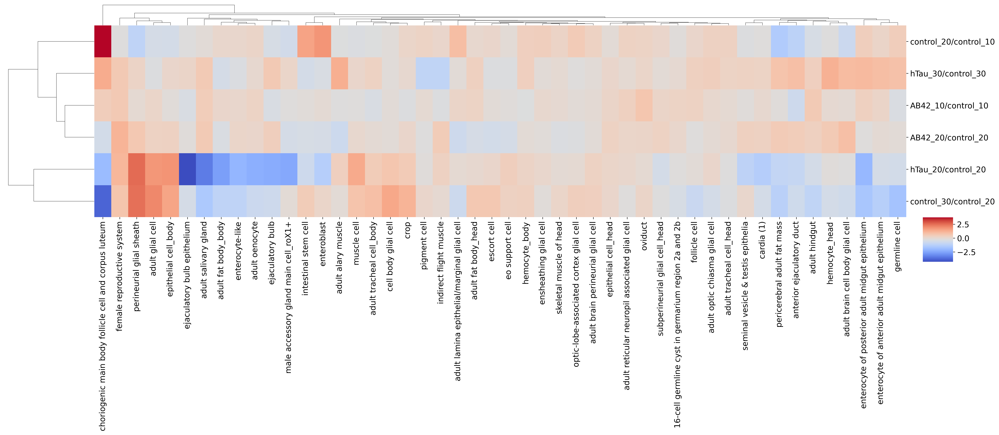

In [39]:
### # non-neuronCell
ax = sns.clustermap(normalRatioNonNeuron_Df.T, figsize=(25, 11), xticklabels=True, cmap='coolwarm', dendrogram_ratio=0.1, ) # vmax=2, vmin=-2,
ax.ax_cbar.set_position((0.92, .40, .03, .10))

In [41]:
corr = normalRatioNonNeuron_Df.corr(method = 'spearman').round(2)
corr

,hTau_20/control_20,hTau_30/control_30,AB42_10/control_10,AB42_20/control_20,control_30/control_20,control_20/control_10
hTau_20/control_20,1.00,-0.18,-0.10,0.05,0.76,-0.09
hTau_30/control_30,-0.18,1.00,0.04,0.29,-0.44,-0.28
AB42_10/control_10,-0.10,0.04,1.00,0.07,-0.28,0.27
AB42_20/control_20,0.05,0.29,0.07,1.00,-0.05,-0.54
control_30/control_20,0.76,-0.44,-0.28,-0.05,1.00,-0.14
control_20/control_10,-0.09,-0.28,0.27,-0.54,-0.14,1.00


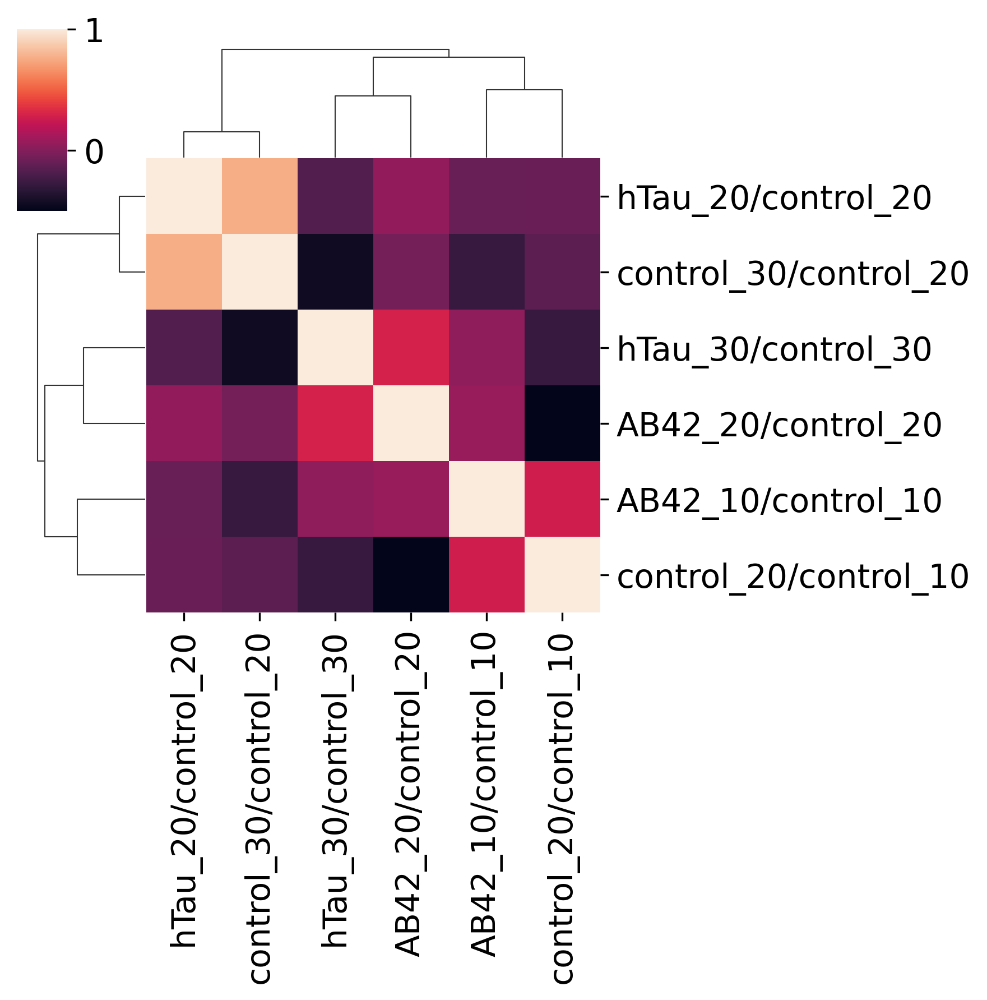

In [43]:
sns.clustermap(corr, figsize=(6, 6), annot=False, vmax =1 , vmin = -0.5)
plt.savefig(f'{figure4PicFolder}/heatmap_composition_correlation_NonNeuron_genoAgeCompare.pdf', bbox_inches='tight')
plt.show()

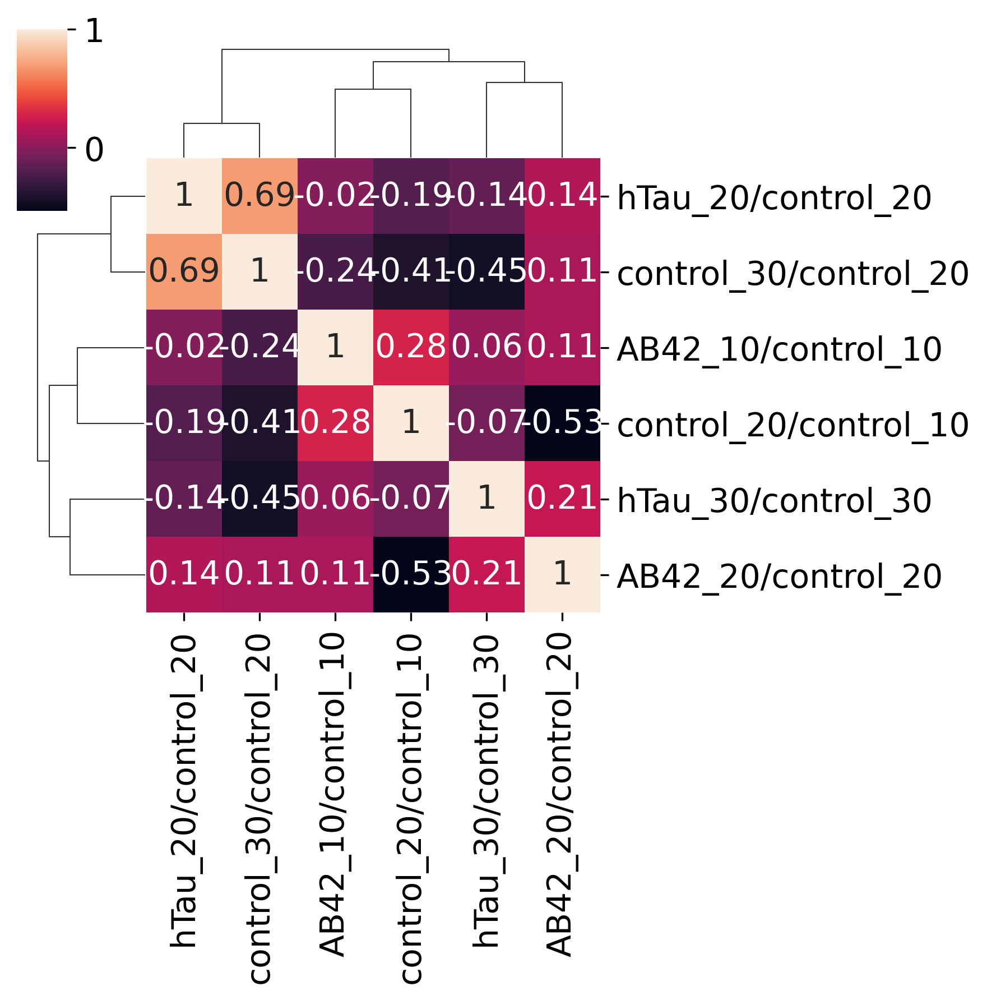

In [130]:
corr = normalRatioNonNeuron_Df2.corr(method = 'pearson').round(2)
sns.clustermap(corr, figsize=(6,6), annot=True)
# plt.savefig(f'{figure5PicFolder}/heatmap_agingFeature_correlation_noNoise_noClock.pdf', bbox_inches='tight')
plt.show()

## compare between all genotypes and compare age differences between control lines

In [77]:
normalRatio_Df = mergeRatio_Df[:]
normalRatio_Df=normalRatio_Df.drop(['unannotated', 'uncharacterized CNS neuron'], axis=0)
# for genoAge in genoAgeCompare_L:
for genoAge in expCompare_Df.compare2.to_list() + ageCompare_Df.compare2.to_list()[:2]:
    # print(genoAge)
    expCol, refCol = genoAge.split('/')
    # print(expCol, refCol)
    normalRatio_Df[genoAge] = normalRatio_Df[f'{expCol}_ratio']/normalRatio_Df[f'{refCol}_ratio']
    
normalRatio_Df = normalRatio_Df.iloc[:,7:]
normalRatio_Df = np.log2(normalRatio_Df)
normalRatio_Df.replace([-np.inf], -5, inplace=True)
normalRatio_Df.replace([np.inf], 7, inplace=True)
dropNa_L = normalRatio_Df.isna().sum(axis=1)[normalRatio_Df.isna().sum(axis=1) != 0].index.to_list()
normalRatio_Df = normalRatio_Df.drop(dropNa_L, axis=0)
normalRatio_Df

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/pandas/core/internals/blocks.py:351: RuntimeWarning: divide by zero encountered in log2
  result = func(self.values, **kwargs)


,AB42_10/control_10,AB42_20/control_20,hTau_20/control_20,hTau_30/control_30,control_20/control_10,control_30/control_20
lobula columnar neuron LC12,-0.774859,-0.337758,0.482605,-1.558717,0.239250,-0.395511
adult reticular neuropil associated glial cell_head,-0.137429,-0.408147,-0.810177,-0.388792,-0.445249,-0.465901
octopaminergic/tyraminergic neuron,-0.009324,-0.301232,0.689056,1.026245,-0.704167,0.100446
Ldh-high neuron,5.525265,4.115642,-0.278456,-0.807745,2.381990,2.290921
neuron 16,0.612164,0.151281,0.303840,-0.154327,0.464809,0.180989
...,...,...,...,...,...,...
epithelial cell_body,-0.157104,0.317731,1.853051,0.107709,-0.565513,1.509875
indirect flight muscle,-0.322569,0.506163,0.314696,-1.067017,0.126652,-0.023846
muscle cell,-0.228363,0.066778,1.361870,0.113957,-0.367049,0.751630
follicle cell,0.265645,-0.214192,-0.146309,0.329841,0.109083,-0.869964


In [78]:
normalRatio_Df.isna().sum(axis=1)[normalRatio_Df.isna().sum(axis=1) != 0]

Series([], dtype: int64)

In [79]:
normalRatio_Df.max(axis=1).sort_values()

male accessory gland secondary cell                     -0.291895
adult reticular neuropil associated glial cell_head     -0.137429
crystal cell_body                                        0.030851
spermatocyte                                             0.086165
neuron 4                                                 0.105849
                                                           ...   
gustatory receptor neuron                                3.005514
visceral muscle of the crop                              3.372885
choriogenic main body follicle cell and corpus luteum    3.738488
Ldh-high neuron                                          5.525265
young germ cell                                          7.000000
Length: 166, dtype: float64

In [80]:
normalRatioN700_Df = normalRatio_Df[normalRatio_Df.index.isin(celltypeN700_L)]

In [81]:
normalRatio_Df

,AB42_10/control_10,AB42_20/control_20,hTau_20/control_20,hTau_30/control_30,control_20/control_10,control_30/control_20
lobula columnar neuron LC12,-0.774859,-0.337758,0.482605,-1.558717,0.239250,-0.395511
adult reticular neuropil associated glial cell_head,-0.137429,-0.408147,-0.810177,-0.388792,-0.445249,-0.465901
octopaminergic/tyraminergic neuron,-0.009324,-0.301232,0.689056,1.026245,-0.704167,0.100446
Ldh-high neuron,5.525265,4.115642,-0.278456,-0.807745,2.381990,2.290921
neuron 16,0.612164,0.151281,0.303840,-0.154327,0.464809,0.180989
...,...,...,...,...,...,...
epithelial cell_body,-0.157104,0.317731,1.853051,0.107709,-0.565513,1.509875
indirect flight muscle,-0.322569,0.506163,0.314696,-1.067017,0.126652,-0.023846
muscle cell,-0.228363,0.066778,1.361870,0.113957,-0.367049,0.751630
follicle cell,0.265645,-0.214192,-0.146309,0.329841,0.109083,-0.869964


In [82]:
normalRatioNeuron_Df = normalRatioN700_Df[normalRatioN700_Df.index.isin(neuronCellType_L)]
normalRatioNonNeuron_Df = normalRatioN700_Df[normalRatioN700_Df.index.isin(nonNeuronCellType_L)]

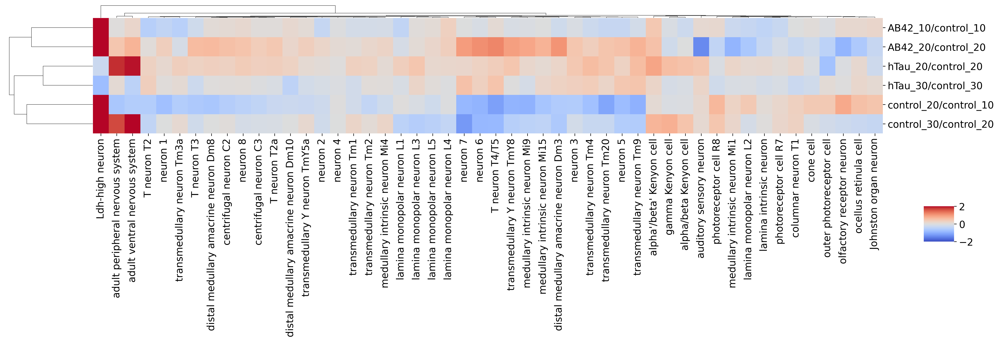

In [84]:
# neuronCell
ax = sns.clustermap(normalRatioNeuron_Df.T, vmax=2, vmin=-2, figsize=(20, 7), xticklabels=True, cmap='coolwarm', dendrogram_ratio=0.1)
ax.ax_cbar.set_position((0.92, .30, .03, .10))

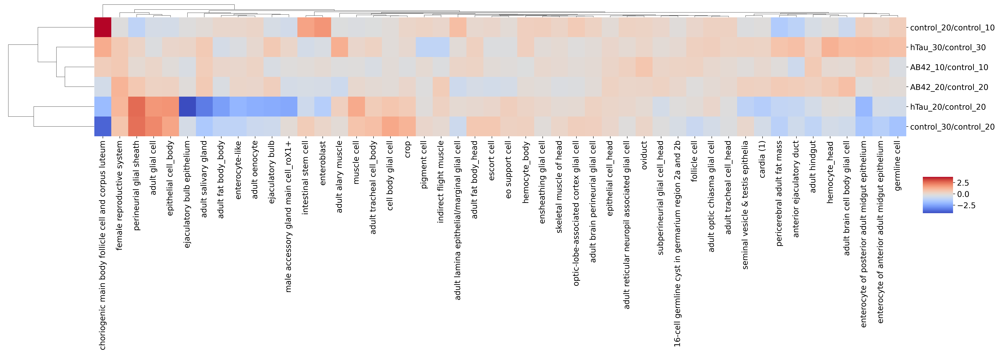

In [85]:
ax = sns.clustermap(normalRatioNonNeuron_Df.T, figsize=(25, 9), xticklabels=True, cmap='coolwarm', dendrogram_ratio=0.1, ) # vmax=2, vmin=-2,
ax.ax_cbar.set_position((0.92, .40, .03, .10))

# Figure 4C: other aging features in non-neuron cells

## a. DEG# comparison

### Load data

In [27]:
adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.1/adfca_head_v0.1_woHarmony.h5ad')
adata_body = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.1/adfca_body_v0.1_woHarmony.h5ad')

In [28]:
adata_headBody = adata_head.concatenate(adata_body, join='outer')
adata_headBody

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


AnnData object with n_obs × n_vars = 624458 × 3285
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad'
    var: 'gene_ids-0', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'mean-0', 'std-0', 'gene_ids-1', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1', 'mean-1', 'std-1'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'

In [29]:
adata_neuron = sc.read(f'{figure2Folder}/adata_neuron.h5ad')

### DEG dynamics: Summarize all genoAge pairs

**Summarize all DEG pairs**

In [30]:
def conv(val):
    if val == np.nan:
        return 0 # or whatever else you want to represent your NaN with
    return val

# df = pd.read_csv(file, converters={colWithNaN : conv}, dtypes=...)

In [31]:
genoAgeCompare_L

['hTau_20/control_20',
 'hTau_30/control_30',
 'AB42_10/control_10',
 'AB42_20/control_20',
 'control_30/control_20',
 'control_20/control_10']

In [32]:
for cellType in celltypeN700_L:
    csvFileName=cellType.replace('/', '_')
    
    degDf_L=[]
    # for n, genoAgeCompare in enumerate(expCompare_Df.compare2.to_list() + ageCompare_Df.compare2.to_list()[:2]):
    for n, genoAgeCompare in enumerate(genoAgeCompare_L):
        exp, ref = genoAgeCompare.split('/')
        
        csvFile=f'{degGenoAgeFolder}/{csvFileName}_{exp}_{ref}.csv'
        if os.path.exists(csvFile):
            degDf = pd.read_csv(csvFile, converters={f'{exp}_names': conv})
            degDf.columns = [exp + '/' + ref +col.split(exp)[-1] for col in degDf.columns]
            # print(degDf[degDf.iloc[:,0].isna()])
            degDf_L.append(degDf)
    
    if len(degDf_L) > 0:
        allDeg_Df=pd.concat(degDf_L, axis=1)
        allDeg_Df.to_csv(f'{degGenoAgeSummaryFolder}/{csvFileName}_compareGenoAge_allPairs.csv', index=False)

**Plot DEG#**

In [30]:
fdrCutOff=0.05

In [31]:
allGenename_L=adata_headBody.raw.var_names.to_list()
len(allGenename_L)

16219

In [48]:
importlib.reload(degSummary)

<module 'degSummary' from '/data/tcl/code/myPyLib/degSummary.py'>

In [32]:
### Summarize deg
degLongAllCellType_Df=pd.DataFrame()
allGeneLong_Df=pd.DataFrame()

for cellType in celltypeN700_L[:]:
    # print(cellType)
    
    csvFileName= cellType.replace('/', '_')
    csvFile=f"{degGenoAgeSummaryFolder}/{csvFileName}_compareGenoAge_allPairs.csv"

    if os.path.exists(csvFile):
        # geneSummaryDf, geneSummary_fdrDf = degSummary.degSummary(csvFile, cellType, genoAge_L[3:], allGenename_L, fdrCutOff, True)
        geneSummaryDf, geneSummary_fdrDf = degSummary.degSummary(csvFile, cellType, genoAgeCompare_L, allGenename_L, fdrCutOff, True)

        if len(degLongAllCellType_Df) == 0: 
            degLongAllCellType_Df=geneSummary_fdrDf
            allGeneLong_Df=geneSummaryDf
        else:
            degLongAllCellType_Df=pd.concat([degLongAllCellType_Df, geneSummary_fdrDf], axis=0)
            allGeneLong_Df=pd.concat([allGeneLong_Df, geneSummaryDf], axis=0)

degLongAllCellType_Df.reset_index(drop=True, inplace=True)
allGeneLong_Df.reset_index(drop=True, inplace=True)

In [33]:
allGeneLong_Df

,names,pvals,pvals_adj,logfoldchanges,annotation,group
0,mt:lrRNA,1.403622e-45,2.276535e-41,4.705659,16-cell germline cyst in germarium region 2a a...,AB42_10/control_10
1,Pde9,9.321786e-32,7.559502e-28,-1.259862,16-cell germline cyst in germarium region 2a a...,AB42_10/control_10
2,pre-rRNA:CR45845,1.046545e-28,1.697392e-24,1.166718,16-cell germline cyst in germarium region 2a a...,control_20/control_10
3,lncRNA:CR34335,1.428039e-24,2.316136e-20,-3.118993,16-cell germline cyst in germarium region 2a a...,control_30/control_20
4,pre-rRNA:CR45845,5.328981e-24,8.643074e-20,0.944138,16-cell germline cyst in germarium region 2a a...,AB42_20/control_20
...,...,...,...,...,...,...
9536767,CG8620,6.331941e-03,1.000000e+00,5.751985,transmedullary neuron Tm9,AB42_10/control_10
9536768,Myc,5.395854e-03,1.000000e+00,2.828967,transmedullary neuron Tm9,AB42_10/control_10
9536769,Mp,2.968292e-03,1.000000e+00,1.163482,transmedullary neuron Tm9,AB42_10/control_10
9536770,Stacl,1.019762e-02,1.000000e+00,0.790698,transmedullary neuron Tm9,AB42_10/control_10


In [34]:
degLongAllCellType_Df

,names,pvals,pvals_adj,logfoldchanges,annotation,group
0,mt:lrRNA,1.403622e-45,2.276535e-41,4.705659,16-cell germline cyst in germarium region 2a a...,AB42_10/control_10
1,Pde9,9.321786e-32,7.559502e-28,-1.259862,16-cell germline cyst in germarium region 2a a...,AB42_10/control_10
2,pre-rRNA:CR45845,1.046545e-28,1.697392e-24,1.166718,16-cell germline cyst in germarium region 2a a...,control_20/control_10
3,lncRNA:CR34335,1.428039e-24,2.316136e-20,-3.118993,16-cell germline cyst in germarium region 2a a...,control_30/control_20
4,pre-rRNA:CR45845,5.328981e-24,8.643074e-20,0.944138,16-cell germline cyst in germarium region 2a a...,AB42_20/control_20
...,...,...,...,...,...,...
93574,Gp93,3.311905e-05,2.984211e-02,29.778917,transmedullary neuron Tm9,AB42_10/control_10
93575,pan,3.796595e-06,3.078849e-02,0.784054,transmedullary neuron Tm9,hTau_20/control_20
93576,aqz,2.878240e-05,3.890181e-02,1.111277,transmedullary neuron Tm9,control_20/control_10
93577,Msp300,4.576660e-05,3.906781e-02,1.037935,transmedullary neuron Tm9,AB42_10/control_10


In [35]:
degLong_Df=degLongAllCellType_Df[degLongAllCellType_Df.annotation.isin(celltypeN700_L)]
degLong_Df

,names,pvals,pvals_adj,logfoldchanges,annotation,group
0,mt:lrRNA,1.403622e-45,2.276535e-41,4.705659,16-cell germline cyst in germarium region 2a a...,AB42_10/control_10
1,Pde9,9.321786e-32,7.559502e-28,-1.259862,16-cell germline cyst in germarium region 2a a...,AB42_10/control_10
2,pre-rRNA:CR45845,1.046545e-28,1.697392e-24,1.166718,16-cell germline cyst in germarium region 2a a...,control_20/control_10
3,lncRNA:CR34335,1.428039e-24,2.316136e-20,-3.118993,16-cell germline cyst in germarium region 2a a...,control_30/control_20
4,pre-rRNA:CR45845,5.328981e-24,8.643074e-20,0.944138,16-cell germline cyst in germarium region 2a a...,AB42_20/control_20
...,...,...,...,...,...,...
93574,Gp93,3.311905e-05,2.984211e-02,29.778917,transmedullary neuron Tm9,AB42_10/control_10
93575,pan,3.796595e-06,3.078849e-02,0.784054,transmedullary neuron Tm9,hTau_20/control_20
93576,aqz,2.878240e-05,3.890181e-02,1.111277,transmedullary neuron Tm9,control_20/control_10
93577,Msp300,4.576660e-05,3.906781e-02,1.037935,transmedullary neuron Tm9,AB42_10/control_10


In [36]:
degN_mtx=pd.DataFrame(columns= genoAgeCompare_L, index=celltypeN700_L )
for cellType in celltypeN700_L:
    # print(cellType)
    
    df = degLong_Df[degLong_Df.annotation == cellType]
    
    degN_L = []
    for genoAgeCompare in genoAgeCompare_L:
        # print(genoAgeCompare)
        degN = len(df[df.group == genoAgeCompare])
        degN_L.append(degN)
    
    degN_mtx.loc[cellType] = degN_L
    
degN_mtx=degN_mtx.sort_values('hTau_20/control_20', ascending=False)
degN_mtx=degN_mtx.astype(int)

In [38]:
degN_neuron_mtx = degN_mtx[degN_mtx.index.isin(neuronCellType_L)]
degN_neuron_mtx.shape

(50, 6)

In [39]:
degN_nonNeuron_mtx = degN_mtx[degN_mtx.index.isin(nonNeuronCellType_L)]
degN_nonNeuron_mtx.head()

,hTau_20/control_20,hTau_30/control_30,AB42_10/control_10,AB42_20/control_20,control_30/control_20,control_20/control_10
follicle cell,2375,448,2144,1285,2523,1669
adult fat body_body,2164,1151,2291,1531,2100,2237
male accessory gland main cell_roX1+,1654,677,1120,507,926,1561
enterocyte of posterior adult midgut epithelium,1584,38,316,174,736,282
enterocyte of anterior adult midgut epithelium,1070,4,192,53,238,102


In [44]:
degN_mtx

,hTau_20/control_20,hTau_30/control_30,AB42_10/control_10,AB42_20/control_20,control_30/control_20,control_20/control_10
follicle cell,2375,448,2144,1285,2523,1669
adult fat body_body,2164,1151,2291,1531,2100,2237
male accessory gland main cell_roX1+,1654,677,1120,507,926,1561
enterocyte of posterior adult midgut epithelium,1584,38,316,174,736,282
enterocyte of anterior adult midgut epithelium,1070,4,192,53,238,102
...,...,...,...,...,...,...
adult glial cell,1,4,1,0,1,0
neuron 5,1,0,1,2,1,7
neuron 8,1,0,3,2,0,3
medullary intrinsic neuron Mi9,0,0,3,1,1,11


In [43]:
degLongAllCellType_Df.to_csv(f'{degN_genoAgeSummaryFolder}/degLongAllCellType_Df.csv', index=False)
allGeneLong_Df.to_csv(f'{degN_genoAgeSummaryFolder}/allGeneLong_Df.csv', index=False)

In [45]:
degN_mtx.to_csv(f'{degN_genoAgeSummaryFolder}/degN_mtx.csv')
degN_neuron_mtx.to_csv(f'{degN_genoAgeSummaryFolder}/degN_neuron_mtx.csv')
degN_nonNeuron_mtx.to_csv(f'{degN_genoAgeSummaryFolder}/degN_nonNeuron_mtx.csv')

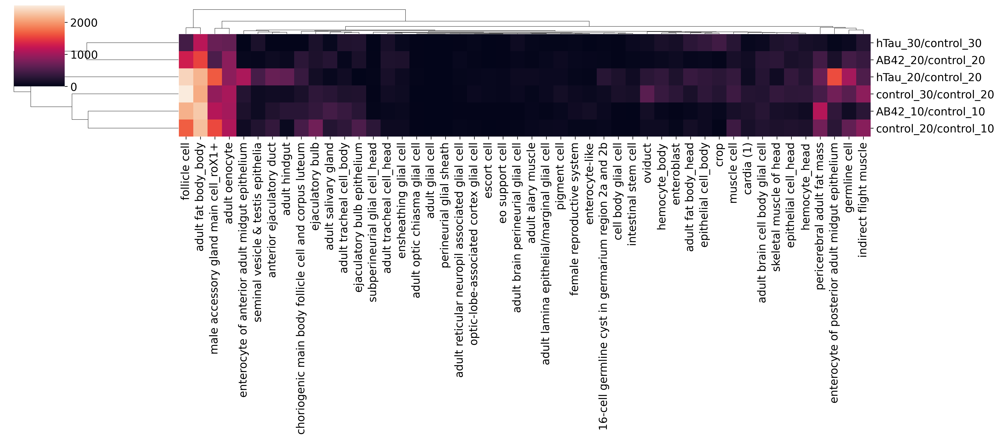

In [57]:
with rc_context({'figure.figsize': (30, 12)}): 
    sns.clustermap(degN_nonNeuron_mtx.transpose(), xticklabels=True, figsize=(18,8)) #, figsize=(12,20)
    plt.ylabel('')
    # plt.tight_layout()
    # plt.savefig(f'{figure2PicFolder}/degN_neuron_mtx_normalizeToControl_heatmap.pdf')
    plt.show()

In [58]:
corr = degN_nonNeuron_mtx.corr(method = 'spearman').round(2)
corr

,hTau_20/control_20,hTau_30/control_30,AB42_10/control_10,AB42_20/control_20,control_30/control_20,control_20/control_10
hTau_20/control_20,1.00,0.54,0.62,0.59,0.75,0.63
hTau_30/control_30,0.54,1.00,0.51,0.59,0.74,0.57
AB42_10/control_10,0.62,0.51,1.00,0.78,0.72,0.86
AB42_20/control_20,0.59,0.59,0.78,1.00,0.77,0.81
control_30/control_20,0.75,0.74,0.72,0.77,1.00,0.72
control_20/control_10,0.63,0.57,0.86,0.81,0.72,1.00


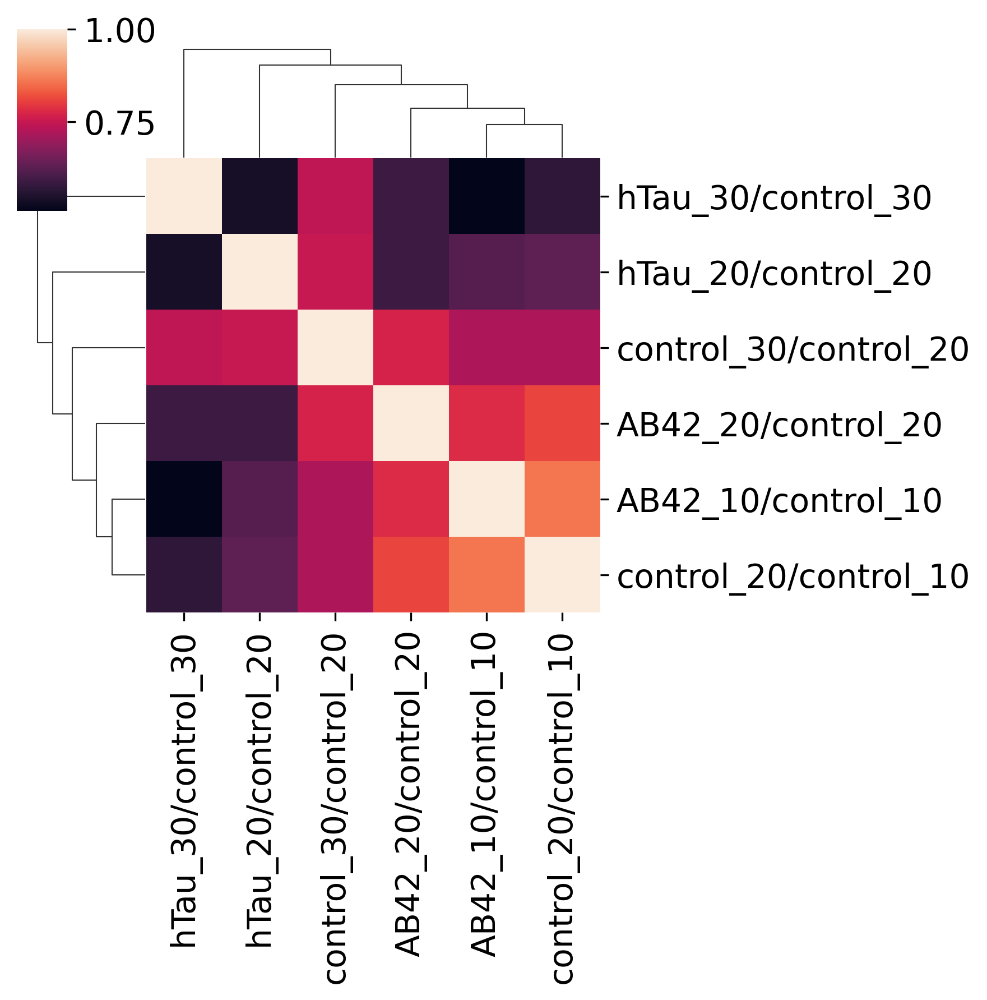

In [59]:
sns.clustermap(corr, figsize=(6, 6), annot=False)
# plt.savefig(f'{figure5PicFolder}/heatmap_agingFeature_correlation_noNoise_noClock.pdf', bbox_inches='tight')
plt.show()

## b. Identity decline

### Load files

In [51]:
adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.1/adfca_head_v0.1_woHarmony.h5ad')
adata_body = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.1/adfca_body_v0.1_woHarmony.h5ad')

In [52]:
adata_headBody = adata_head.concatenate(adata_body, join='outer')
adata_headBody

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


AnnData object with n_obs × n_vars = 624458 × 3285
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad'
    var: 'gene_ids-0', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'mean-0', 'std-0', 'gene_ids-1', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1', 'mean-1', 'std-1'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'

### Identify cell-type markers using age- or genotype-specific adata

In [36]:
for tissue in ['body', 'head']:
    if tissue == 'body': 
        
        adata = adata_body
    else: 
        
        adata = adata_head
    
    adata=adata[adata.obs.adfca_annotation.isin(celltypeN700_L)]
    for genoAge in genoAge_L:
        adata_age = adata[adata.obs.genoAge == genoAge]
        
        # deg
        sc.tl.rank_genes_groups(adata_age, groupby='adfca_annotation', method='wilcoxon')
        result = adata_age.uns['rank_genes_groups']
        groups = result['names'].dtype.names
        degDf =pd.DataFrame(
            {group + '_' + key: result[key][group]
            for group in groups for key in ['names', 'pvals', 'pvals_adj', 'logfoldchanges']})

        degDf.to_csv(f'{markerFolder}/cellType_markers_{tissue}_{genoAge}.csv', index=False)
        

ranking genes


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:31)


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:399: Perf

ranking genes


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:27)


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:399: Perf

ranking genes


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:17)


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:399: Perf

ranking genes


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:38)


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:399: Perf

ranking genes


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:18)


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:399: Perf

ranking genes


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:28)


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:399: Perf

ranking genes


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:14)


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:399: Perf

ranking genes


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instea

    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:27)


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:409: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'pvals_adj'] = pvals_adj[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:420: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: Performance

ranking genes


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instea

    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:27)


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:409: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'pvals_adj'] = pvals_adj[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:420: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: Performance

ranking genes


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instea

    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:20)


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:399: Perf

ranking genes


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instea

    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:23)


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'pvals'] = pvals[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:409: PerformanceWa

ranking genes


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instea

    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:21)


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:409: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'pvals_adj'] = pvals_adj[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:420: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: Performance

ranking genes


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instea

    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:25)


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:409: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'pvals_adj'] = pvals_adj[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:420: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: Performance

ranking genes


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instea

    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:19)


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:399: Perf

### Extract top 200 markers from each genoAge group

In [60]:
for genoAge in genoAge_L[:]:
    print(genoAge)
    marker_Df = pd.DataFrame(columns=['names', 'pvals', 'pvals_adj', 'logfoldchanges', 'annotation'])
    marker_Df_fdr = pd.DataFrame(columns=['names', 'pvals', 'pvals_adj', 'logfoldchanges', 'annotation'])
    
    top200names_Df = pd.DataFrame(index=range(200))

    for tissue in ['body', 'head']:
        markerFile = f'{markerFolder}/cellType_markers_{tissue}_{genoAge}.csv'

        if tissue == 'body': adata = adata_body
        else: adata = adata_head

        degLongDf, degLongDf_fdr = degSummary.markerSummary(markerFile)

        marker_Df=pd.concat([marker_Df, degLongDf])
        marker_Df_fdr=pd.concat([marker_Df_fdr, degLongDf_fdr])
        
        # cellType_L=['_'.join(colName.split('_')[:-1]) for colName in marker_Df.columns.to_list()[::4]]
        cellType_L = list(set(marker_Df.annotation.to_list()))
        # print(cellType_L)
        
        ### top 200 marker genes
        for cellType in cellType_L:
            # cellType_Df = marker_Df.loc[:199, 
            #                         [f'names' for cellType in cellType_L]]
            top200names_Df[cellType] = marker_Df[marker_Df.annotation == cellType].iloc[:200,:].names.to_list()
        print(top200names_Df.shape)
        
        top200names_Df.to_csv(f'{markerFolder}/top200names_{genoAge}.csv', index=False)
    print()

control_10
cellType_L:  35
(200, 35)
cellType_L:  63
(200, 98)

control_20
cellType_L:  35
(200, 35)
cellType_L:  63
(200, 98)

control_30
cellType_L:  35
(200, 35)
cellType_L:  63
(200, 98)

AB42_10
cellType_L:  35
(200, 35)
cellType_L:  63
(200, 98)

AB42_20
cellType_L:  35
(200, 35)
cellType_L:  63
(200, 98)

hTau_20
cellType_L:  35
(200, 35)
cellType_L:  63
(200, 98)

hTau_30
cellType_L:  35
(200, 35)
cellType_L:  63
(200, 98)



### Include DEG information from each genoAge

In [61]:
for i, cellType in enumerate( [x for x in top200names_Df.columns[:]] ):
    print(cellType)
    cellTypeName='_'.join(cellType.split('/'))
    
    degFile=f'{figure4Folder}/degSummary/{cellTypeName}_compareGenoAge_allPairs.csv'
    degDf = pd.read_csv(degFile)
    colName_L = [colName for genoAgeCompare in genoAgeCompare_L for colName in degDf.columns if genoAgeCompare in colName ]
    degSelect_Df = degDf.loc[:,colName_L]
    
    degSelect_Df.to_csv(f'{degGenoAgeSummarySelectFolder}/{cellTypeName}_compareGenoAge_selectPairs.csv', index=False)
    
    # print()

cell body glial cell
ejaculatory bulb
crop
adult hindgut
enterocyte-like
cardia (1)
escort cell
adult peripheral nervous system
perineurial glial sheath
adult oenocyte
anterior ejaculatory duct
follicle cell
adult glial cell
male accessory gland main cell_roX1+
oviduct
adult ventral nervous system
enteroblast
16-cell germline cyst in germarium region 2a and 2b
hemocyte_body
adult alary muscle
muscle cell
adult fat body_body
seminal vesicle & testis epithelia
ejaculatory bulb epithelium
adult tracheal cell_body
adult salivary gland
intestinal stem cell
germline cell
epithelial cell_body
enterocyte of posterior adult midgut epithelium
indirect flight muscle
enterocyte of anterior adult midgut epithelium
female reproductive system
eo support cell
choriogenic main body follicle cell and corpus luteum
lamina monopolar neuron L3
photoreceptor cell R8
adult brain cell body glial cell
gamma Kenyon cell
hemocyte_head
T neuron T2
distal medullary amacrine neuron Dm3
epithelial cell_head
T neuron

In [53]:
markerDE_Df=pd.DataFrame()
for j, genoAgeCompare in enumerate(genoAgeCompare_L[:]):
    print(genoAgeCompare)
    genoAgeCompareName = '_'.join(genoAgeCompare.split('/'))
    # print(genoAgeCompare_L[j])
    
    exp, ref = genoAgeCompare.split('/')
    print(exp, ref)
    expMarker_Df = pd.read_csv(f'{markerFolder}/top200names_{exp}.csv')
    refMarker_Df = pd.read_csv(f'{markerFolder}/top200names_{ref}.csv')

    # print(marker_L)
    
    for i, cellType in enumerate( celltypeN700_L ):
        # print(cellType)
        cellTypeName='_'.join(cellType.split('/'))
        
        expMarker_L=expMarker_Df.loc[:,cellType].to_list()
        refMarker_L=refMarker_Df.loc[:,cellType].to_list()
        marker_L = list( set(expMarker_L) | set(refMarker_L))
        
        degFile=f'{degGenoAgeSummarySelectFolder}/{cellTypeName}_compareGenoAge_selectPairs.csv'
        # print(degDf.columns)
        
        # print(degFile,)
        # print(cellType, [genoAgeCompare], marker_L)
        geneSummaryDf, geneSummaryFdrDf = degSummary.degSummary(degFile, cellType, [genoAgeCompare], marker_L, fdrCutoff=0.05, prefix=genoAgeCompare) # prefix=True
        
        # try:
        #     geneSummaryDf, geneSummaryFdrDf = degSummary.degSummary(degFile, cellTypeName, genoAgeCompare_L, marker_L, prefix=True)
        # except: continue

        # # print(geneSummaryDf.head())
        # geneSummaryDf_50d = geneSummaryDf[geneSummaryDf.age == '50']
        # print(cellType, len(geneSummaryDf_50d))

        if len(markerDE_Df) == 0: markerDE_Df=geneSummaryDf
        else: markerDE_Df = pd.concat([markerDE_Df, geneSummaryDf])


hTau_20/control_20
hTau_20 control_20


/data/tcl/code/myPyLib/degSummary.py:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  degLongDf.iloc[:,0]=degLongDf.iloc[:,0].astype(str) # make sure 'nan' gene is included
/data/tcl/code/myPyLib/degSummary.py:60: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  degLongDf['annotation'] = cellType
/data/tcl/code/myPyLib/degSummary.py:61: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the doc

hTau_30/control_30
hTau_30 control_30


/data/tcl/code/myPyLib/degSummary.py:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  degLongDf.iloc[:,0]=degLongDf.iloc[:,0].astype(str) # make sure 'nan' gene is included
/data/tcl/code/myPyLib/degSummary.py:60: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  degLongDf['annotation'] = cellType
/data/tcl/code/myPyLib/degSummary.py:61: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the doc

AB42_10/control_10
AB42_10 control_10


/data/tcl/code/myPyLib/degSummary.py:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  degLongDf.iloc[:,0]=degLongDf.iloc[:,0].astype(str) # make sure 'nan' gene is included
/data/tcl/code/myPyLib/degSummary.py:60: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  degLongDf['annotation'] = cellType
/data/tcl/code/myPyLib/degSummary.py:61: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the doc

AB42_20/control_20
AB42_20 control_20


/data/tcl/code/myPyLib/degSummary.py:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  degLongDf.iloc[:,0]=degLongDf.iloc[:,0].astype(str) # make sure 'nan' gene is included
/data/tcl/code/myPyLib/degSummary.py:60: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  degLongDf['annotation'] = cellType
/data/tcl/code/myPyLib/degSummary.py:61: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the doc

control_30/control_20
control_30 control_20


/data/tcl/code/myPyLib/degSummary.py:61: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  degLongDf['group'] = group_L[0]
/data/tcl/code/myPyLib/degSummary.py:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  degLongDf.iloc[:,0]=degLongDf.iloc[:,0].astype(str) # make sure 'nan' gene is included
/data/tcl/code/myPyLib/degSummary.py:60: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docume

control_20/control_10
control_20 control_10


/data/tcl/code/myPyLib/degSummary.py:61: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  degLongDf['group'] = group_L[0]
/data/tcl/code/myPyLib/degSummary.py:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  degLongDf.iloc[:,0]=degLongDf.iloc[:,0].astype(str) # make sure 'nan' gene is included
/data/tcl/code/myPyLib/degSummary.py:60: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docume

In [54]:
markerDE_Df

,names,pvals,pvals_adj,logfoldchanges,annotation,group
16217,pAbp,1.604378e-20,1.301070e-16,-1.693143,16-cell germline cyst in germarium region 2a a...,hTau_20/control_20
16216,Pde9,9.211048e-20,4.979800e-16,-1.441190,16-cell germline cyst in germarium region 2a a...,hTau_20/control_20
16213,lncRNA:CR44833,1.171788e-14,2.715033e-11,-0.620204,16-cell germline cyst in germarium region 2a a...,hTau_20/control_20
1,kirre,6.571133e-09,2.732749e-06,0.278548,16-cell germline cyst in germarium region 2a a...,hTau_20/control_20
16181,CG32767,7.100290e-09,2.878990e-06,-0.658761,16-cell germline cyst in germarium region 2a a...,hTau_20/control_20
...,...,...,...,...,...,...
15003,Pde1c,8.415197e-01,1.000000e+00,-0.189850,transmedullary neuron Tm9,control_20/control_10
15105,side-IV,8.201094e-01,1.000000e+00,-0.145045,transmedullary neuron Tm9,control_20/control_10
15218,Toll-6,7.880492e-01,1.000000e+00,-0.157822,transmedullary neuron Tm9,control_20/control_10
13151,stj,9.818160e-01,1.000000e+00,-0.020738,transmedullary neuron Tm9,control_20/control_10


In [55]:
markerDE_Df.reset_index(drop=True, inplace=True)
padj_05_L=[]
for i, adj in enumerate(markerDE_Df.pvals_adj):
    logFC = markerDE_Df.logfoldchanges[i]
    if adj <= 0.05:
        if logFC >0: padj_05_L.append('Increased')
        else: padj_05_L.append('Decreased')
    else: padj_05_L.append('Non-significant')

markerDE_Df['padj_05'] = pd.Categorical(padj_05_L)
markerDE_Df

,names,pvals,pvals_adj,logfoldchanges,annotation,group,padj_05
0,pAbp,1.604378e-20,1.301070e-16,-1.693143,16-cell germline cyst in germarium region 2a a...,hTau_20/control_20,Decreased
1,Pde9,9.211048e-20,4.979800e-16,-1.441190,16-cell germline cyst in germarium region 2a a...,hTau_20/control_20,Decreased
2,lncRNA:CR44833,1.171788e-14,2.715033e-11,-0.620204,16-cell germline cyst in germarium region 2a a...,hTau_20/control_20,Decreased
3,kirre,6.571133e-09,2.732749e-06,0.278548,16-cell germline cyst in germarium region 2a a...,hTau_20/control_20,Increased
4,CG32767,7.100290e-09,2.878990e-06,-0.658761,16-cell germline cyst in germarium region 2a a...,hTau_20/control_20,Decreased
...,...,...,...,...,...,...,...
136569,Pde1c,8.415197e-01,1.000000e+00,-0.189850,transmedullary neuron Tm9,control_20/control_10,Non-significant
136570,side-IV,8.201094e-01,1.000000e+00,-0.145045,transmedullary neuron Tm9,control_20/control_10,Non-significant
136571,Toll-6,7.880492e-01,1.000000e+00,-0.157822,transmedullary neuron Tm9,control_20/control_10,Non-significant
136572,stj,9.818160e-01,1.000000e+00,-0.020738,transmedullary neuron Tm9,control_20/control_10,Non-significant


In [241]:
# markerDE_Df.reset_index(drop=True, inplace=True)
# padj_05_L=[]
# for i, adj in enumerate(markerDE_Df.pvals_adj):
#     logFC = markerDE_Df.logfoldchanges[i]
#     if adj <= 0.05:
#         if logFC >0: padj_05_L.append('Increased')
#         else: padj_05_L.append('Decreased')
#     else: padj_05_L.append('Non-significant')

# markerDE_Df['padj_05'] = pd.Categorical(padj_05_L)
# markerDE_Df

,names,pvals,pvals_adj,logfoldchanges,annotation,group,padj_05
0,CG10077,4.628123e-61,7.506352e-57,-4.032554,male accessory gland main cell_roX1+,hTau_20/control_20,Decreased
1,qkr58E-1,1.565965e-57,1.269919e-53,-4.820511,male accessory gland main cell_roX1+,hTau_20/control_20,Decreased
2,kl-2,2.123134e-52,8.608778e-49,-4.438777,male accessory gland main cell_roX1+,hTau_20/control_20,Decreased
3,pre-rRNA:CR45847,1.098977e-51,3.244194e-48,-5.007798,male accessory gland main cell_roX1+,hTau_20/control_20,Decreased
4,Gmap,1.200146e-51,3.244194e-48,-3.434359,male accessory gland main cell_roX1+,hTau_20/control_20,Decreased
...,...,...,...,...,...,...,...
114313,Tl,8.732969e-01,1.000000e+00,-0.180351,T neuron T2,control_20/control_10,Non-significant
114314,Pdfr,8.393210e-01,1.000000e+00,-0.059673,T neuron T2,control_20/control_10,Non-significant
114315,CG42524,8.355908e-01,1.000000e+00,-0.078845,T neuron T2,control_20/control_10,Non-significant
114316,Ih,9.317647e-01,1.000000e+00,-0.109933,T neuron T2,control_20/control_10,Non-significant


In [56]:
markerDE_Df.annotation.value_counts()

Ldh-high neuron                                    1613
enterocyte of anterior adult midgut epithelium     1564
seminal vesicle & testis epithelia                 1547
male accessory gland main cell_roX1+               1532
enterocyte of posterior adult midgut epithelium    1513
                                                   ... 
lamina monopolar neuron L2                         1306
columnar neuron T1                                 1300
adult ventral nervous system                       1299
alpha/beta Kenyon cell                             1295
gamma Kenyon cell                                  1287
Name: annotation, Length: 98, dtype: int64

In [57]:
summaryDf=pd.DataFrame(columns=['annotation', 'genoAgeCompare', 'increase#Exp', 'decrease#Exp', 'nonSignificant#Exp', 'total#Exp', 'increase#Ref', 'decrease#Ref', 'nonSignificant#Ref', 'total#Ref'])

for j, genoAgeCompare in enumerate(genoAgeCompare_L[:]):
    # print(genoAgeCompare)
    genoAgeCompareName = '_'.join(genoAgeCompare.split('/'))
    
    exp, ref = genoAgeCompare.split('/')
    # print(exp, ref)
    expMarker_Df = pd.read_csv(f'{markerFolder}/top200names_{exp}.csv')
    refMarker_Df = pd.read_csv(f'{markerFolder}/top200names_{ref}.csv')

    
    for i, cellType in enumerate( celltypeN700_L ):
        # print(cellType)
        cellTypeName='_'.join(cellType.split('/'))
        
        expMarker_L=expMarker_Df.loc[:,cellType].to_list()
        refMarker_L=refMarker_Df.loc[:,cellType].to_list()
        marker_L = list( set(expMarker_L) | set(refMarker_L))
        
        # exp group
        degExpDf = markerDE_Df[ (markerDE_Df.annotation == cellType) & (markerDE_Df.group == genoAgeCompare) & (markerDE_Df.names.isin(expMarker_L))]
        valueExp_S = degExpDf.padj_05.value_counts()
        # ref group
        degRefDf = markerDE_Df[ (markerDE_Df.annotation == cellType) & (markerDE_Df.group == genoAgeCompare) & (markerDE_Df.names.isin(refMarker_L))]
        valueRef_S = degRefDf.padj_05.value_counts()
        
        summaryDf.loc[len(summaryDf)] = [cellType, genoAgeCompare, 
                                         valueExp_S['Increased'], valueExp_S['Decreased'], valueExp_S['Non-significant'], sum([valueExp_S['Increased'], valueExp_S['Decreased'], valueExp_S['Non-significant']]), 
                                         valueRef_S['Increased'], valueRef_S['Decreased'], valueRef_S['Non-significant'], sum([valueRef_S['Increased'], valueRef_S['Decreased'], valueRef_S['Non-significant']]) ]
summaryDf['expGain_ratio'] = summaryDf['increase#Exp']/200
summaryDf['refLoss_ratio'] = summaryDf['decrease#Ref']/200
summaryDf['expGain_refLoss_ratio'] = (summaryDf['increase#Exp'] + summaryDf['decrease#Ref'])/400
summaryDf.sort_values(by='expGain_refLoss_ratio', inplace=True, ascending=False)
summaryDf

,annotation,genoAgeCompare,increase#Exp,decrease#Exp,nonSignificant#Exp,total#Exp,increase#Ref,decrease#Ref,nonSignificant#Ref,total#Ref,expGain_ratio,refLoss_ratio,expGain_refLoss_ratio
447,indirect flight muscle,control_30/control_20,119,54,27,200,41,120,39,200,0.595,0.600,0.5975
63,male accessory gland main cell_roX1+,hTau_20/control_20,51,68,81,200,2,188,10,200,0.255,0.940,0.5975
402,adult fat body_body,control_30/control_20,89,87,24,200,48,134,18,200,0.445,0.670,0.5575
545,indirect flight muscle,control_20/control_10,69,83,48,200,24,143,33,200,0.345,0.715,0.5300
553,male accessory gland main cell_roX1+,control_20/control_10,79,84,37,200,38,132,30,200,0.395,0.660,0.5275
...,...,...,...,...,...,...,...,...,...,...,...,...,...
466,neuron 6,control_30/control_20,0,0,200,200,0,0,200,200,0.000,0.000,0.0000
464,neuron 4,control_30/control_20,0,0,200,200,0,0,200,200,0.000,0.000,0.0000
463,neuron 3,control_30/control_20,0,0,200,200,0,0,200,200,0.000,0.000,0.0000
462,neuron 2,control_30/control_20,0,0,200,200,0,0,200,200,0.000,0.000,0.0000


In [58]:
color_L=sns.color_palette("coolwarm", 7)[::3]
color_L=[color_L[0], color_L[2], color_L[1]]

In [90]:
### Neuron cells
# with rc_context({'figure.figsize': (12, 3)}):
    
for genoAgeCompare in genoAgeCompare_L:
    genoAgeCompareName = '_'.join(genoAgeCompare.split('/'))

    summaryEachDf = summaryDf[ (summaryDf.genoAgeCompare == genoAgeCompare) & (summaryDf.annotation.isin(neuronCellType_L))]
    summaryEachDf.index = summaryEachDf.annotation.to_list()
    ax=(summaryEachDf.loc[:,['refLoss_ratio', 'expGain_ratio']]/2).plot(kind='bar', stacked=True, color=color_L, figsize=(15, 3))
    # ax=sns.barplot(data=markerFluctuation_Df, x='Marker loss', y='annotation', color=color_L[0])
    # ax2=sns.barplot(data=markerFluctuation_Df, x='Marker gain', y='annotation', color=color_L[0])
    ax.grid(axis='both',visible=False)
    plt.legend(bbox_to_anchor=(1.00, 1.00))
    plt.ylabel('Ratio of marker genes')
    plt.title(f'{genoAgeCompare}')
    plt.savefig(f'{markerFolder}/Marker_lossGain_ratio_stacked_neuron_{genoAgeCompareName}.pdf', bbox_inches='tight')
    # plt.show()
    plt.close()

In [93]:
### Non-Neuronal cells
with rc_context({'figure.figsize': (17, 3)}):
    
    for genoAgeCompare in genoAgeCompare_L:
        genoAgeCompareName = '_'.join(genoAgeCompare.split('/'))
        
        summaryEachDf = summaryDf[ (summaryDf.genoAgeCompare == genoAgeCompare) & (summaryDf.annotation.isin(nonNeuronCellType_L))]
        summaryEachDf.index = summaryEachDf.annotation.to_list()
        ax=(summaryEachDf.loc[:,['refLoss_ratio', 'expGain_ratio']]/2).plot(kind='bar', stacked=True, color=color_L, figsize=(20, 3))
        # ax=sns.barplot(data=markerFluctuation_Df, x='Marker loss', y='annotation', color=color_L[0])
        # ax2=sns.barplot(data=markerFluctuation_Df, x='Marker gain', y='annotation', color=color_L[0])
        ax.grid(axis='both',visible=False)
        plt.legend(bbox_to_anchor=(1.00, 1.00))
        plt.ylabel('Ratio of marker genes')
        plt.title(f'{genoAgeCompare}')
        plt.savefig(f'{markerFolder}/Marker_lossGain_ratio_stacked_nonneuron_{genoAgeCompareName}.pdf', bbox_inches='tight')
        # plt.show()
        plt.close()

In [64]:
### Use non-neuronal cells for calculating the correlation
summaryPivot_Df = summaryDf[['annotation', 'genoAgeCompare', 'expGain_refLoss_ratio']].pivot(index="annotation", columns="genoAgeCompare", values="expGain_refLoss_ratio")
summaryPivot_Df.index.name = None
summaryPivot_Df.columns.name = None
summaryPivot_Df = summaryPivot_Df.loc[nonNeuronCellType_L,:]
# summaryPivot_Df

In [65]:
markerDE_Df.to_csv(f'{markerFolder}/markerDE_Df.csv', index=False)
summaryDf.to_csv(f'{markerFolder}/summaryDf.csv', index=False)
summaryPivot_Df.to_csv(f'{markerFolder}/summaryPivot_Df_nonNeuron.csv')

In [66]:
corr = summaryPivot_Df.corr(method = 'spearman').round(2)
corr

,AB42_10/control_10,AB42_20/control_20,control_20/control_10,control_30/control_20,hTau_20/control_20,hTau_30/control_30
AB42_10/control_10,1.00,0.81,0.82,0.64,0.52,0.51
AB42_20/control_20,0.81,1.00,0.83,0.75,0.54,0.64
control_20/control_10,0.82,0.83,1.00,0.65,0.53,0.58
control_30/control_20,0.64,0.75,0.65,1.00,0.67,0.73
hTau_20/control_20,0.52,0.54,0.53,0.67,1.00,0.54
hTau_30/control_30,0.51,0.64,0.58,0.73,0.54,1.00


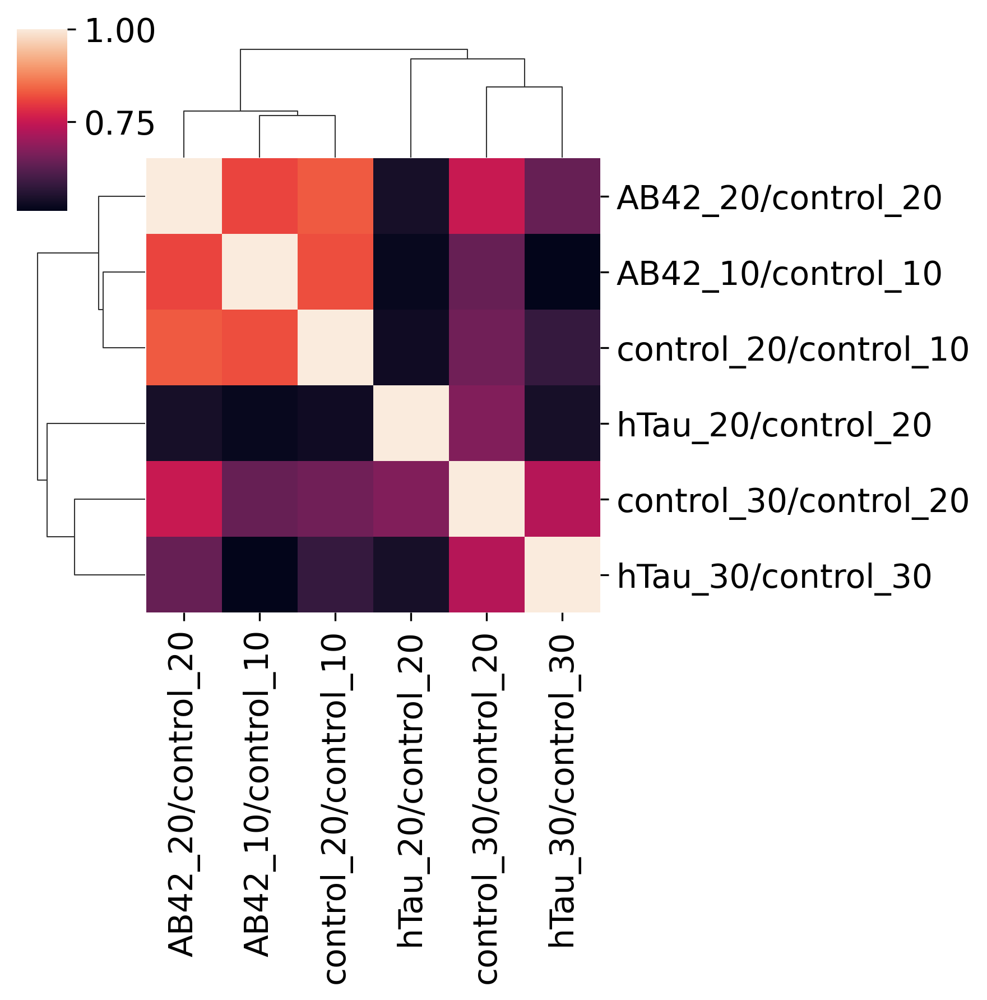

In [67]:
sns.clustermap(corr, figsize=(6, 6), annot=False)
plt.savefig(f'{figure4PicFolder}/heatmap_identityDecline_correlation_NonNeuron_genoAgeCompare.pdf', bbox_inches='tight')
plt.show()

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.ob

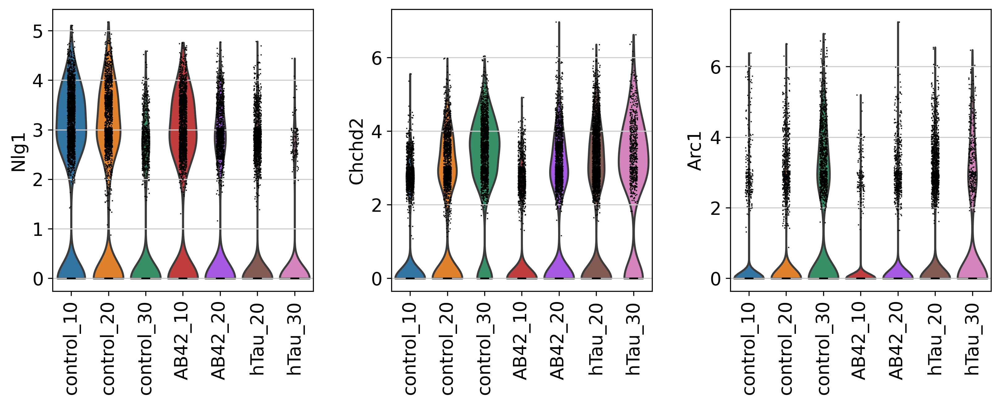

In [110]:
sc.pl.violin(adata_headBody[adata_headBody.obs.adfca_annotation == 'indirect flight muscle'], keys=['Nlg1', 'Chchd2', 'Arc1'], groupby='genoAge', rotation=90)

## c. gene#

### Load files

In [27]:
adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.1/adfca_head_v0.1_woHarmony.h5ad')
adata_body = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.1/adfca_body_v0.1_woHarmony.h5ad')

In [28]:
adata_headBody = adata_head.concatenate(adata_body, join='outer')
adata_headBody

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


AnnData object with n_obs × n_vars = 624458 × 3285
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad'
    var: 'gene_ids-0', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'mean-0', 'std-0', 'gene_ids-1', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1', 'mean-1', 'std-1'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'

### Compare gene#

In [64]:
for cellType in celltypeN700_L[:]:
    cellTypeName='_'.join(cellType.split('/'))
    adata=adata_headBody[adata_headBody.obs.adfca_annotation == cellType]
    for n, count in enumerate(['n_genes_by_counts', 'total_counts']):
        fig, ax = plt.subplots(figsize=(5, 5))
        sc.pl.violin(adata, keys=[count], groupby='genoAge', rotation=90, show=False, ax=ax) # 
        ax.set_title(f'{count}__{cellType}')
        plt.savefig(f'{geneNumPicFolder}/violin__{count}__{cellTypeName}.pdf', bbox_inches='tight')
        plt.close()
        
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{geneNumPicFolder}/{x}')

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.ob

In [29]:
genoAgeCompare_L

['hTau_20/control_20',
 'hTau_30/control_30',
 'AB42_10/control_10',
 'AB42_20/control_20',
 'control_30/control_20',
 'control_20/control_10']

In [68]:
### calculate median gene# & umi#
geneN_Df = pd.DataFrame(columns=['genoAgeCompare', 'annotation', 'medGeneNum_exp', 'medGeneNum_ref', 'medUmiNum_exp', 'medUmiNum_ref', 'genenRatio', 'genenLog2Ratio', 'umiRatio', 'umiLog2Ratio' ])

n=0
for genoAgeCompare in genoAgeCompare_L:
    print(genoAgeCompare)
    genoAgeCompareName = '_'.join(genoAgeCompare.split('/'))
    exp, ref = genoAgeCompare.split('/')
    
    umiRatio_L=[]
    umiLog2Ratio_L=[]
    geneN_ratio_L=[]
    geneN_log2ratio_L=[]
    
    for k, cellType in enumerate(celltypeN700_L):
        adata = adata_headBody[ (adata_headBody.obs.genoAge.isin([exp, ref])) & (adata_headBody.obs.adfca_annotation == cellType) ]
        # print(cellType)
        # print(adata)
        
        medGeneNum_exp, medGeneNum_ref, medUmiNum_exp, medUmiNum_ref = adata[adata.obs.genoAge == exp].obs.n_genes_by_counts.median(), adata[adata.obs.genoAge == ref].obs.n_genes_by_counts.median(), \
            adata[adata.obs.genoAge == exp].obs.total_counts.median(), adata[adata.obs.genoAge == ref].obs.total_counts.median()
        
        genenRatio=medGeneNum_exp/medGeneNum_ref
        genenLog2Ratio=np.log2(genenRatio)
        geneN_ratio_L.append(genenRatio)
        geneN_log2ratio_L.append(genenLog2Ratio)
        
        umiRatio=medUmiNum_exp/medUmiNum_ref
        umiLog2Ratio=np.log2(umiRatio)
        umiRatio_L.append(umiRatio)
        umiLog2Ratio_L.append(umiLog2Ratio)
        
        # print(medGeneNum_exp, medGeneNum_ref, medUmiNum_exp, medUmiNum_ref)
        # print(genenRatio, genenLog2Ratio, umiRatio, umiLog2Ratio)
        
        geneN_Df.loc[n] = [genoAgeCompare, cellType, medGeneNum_exp, medGeneNum_ref, medUmiNum_exp, medUmiNum_ref, genenRatio, genenLog2Ratio, umiRatio, umiLog2Ratio]
        n+=1
        
    print()

# geneN_Df.reset_index(drop=True, inplace=True)
geneN_Df.to_csv(f'{geneNumFolder}/geneNum_genoAgeCompareName.csv', index=False)

hTau_20/control_20

hTau_30/control_30

AB42_10/control_10

AB42_20/control_20

control_30/control_20

control_20/control_10



In [69]:
sortOrder_L = geneN_Df[geneN_Df.genoAgeCompare == 'hTau_20/control_20'].sort_values(by='genenLog2Ratio', ascending=False).annotation.to_list()

In [70]:
geneN_sort_Df = pd.DataFrame(columns=['genoAgeCompare', 'annotation', 'ratioType', 'log2Ratio'])
for genoAgeCompare in genoAgeCompare_L:
    print(genoAgeCompare)
    genoAgeCompareName = '_'.join(genoAgeCompare.split('/'))
    exp, ref = genoAgeCompare.split('/')
    
    #sorted DF
    genoAge_sort_Df = geneN_Df[geneN_Df.genoAgeCompare == genoAgeCompare]
    genoAge_sort_Df.index = genoAge_sort_Df.annotation.to_list()
    genoAge_sort_Df=genoAge_sort_Df.loc[sortOrder_L]
    genoAge_sort_Df=genoAge_sort_Df.loc[:,['genoAgeCompare', 'annotation', 'genenLog2Ratio', 'umiLog2Ratio']
                                       ].melt(id_vars=['genoAgeCompare', 'annotation'], var_name='ratioType', value_name='log2Ratio') #  
    geneN_sort_Df = pd.concat([geneN_sort_Df, genoAge_sort_Df ], axis=0)

geneN_sort_Df.reset_index(drop=True, inplace=True)
geneN_sort_Df

hTau_20/control_20
hTau_30/control_30
AB42_10/control_10
AB42_20/control_20
control_30/control_20
control_20/control_10


,genoAgeCompare,annotation,ratioType,log2Ratio
0,hTau_20/control_20,hemocyte_body,genenLog2Ratio,0.386481
1,hTau_20/control_20,ejaculatory bulb,genenLog2Ratio,0.340979
2,hTau_20/control_20,adult ventral nervous system,genenLog2Ratio,0.185075
3,hTau_20/control_20,intestinal stem cell,genenLog2Ratio,0.175012
4,hTau_20/control_20,hemocyte_head,genenLog2Ratio,0.157135
...,...,...,...,...
1171,control_20/control_10,seminal vesicle & testis epithelia,umiLog2Ratio,-0.066939
1172,control_20/control_10,anterior ejaculatory duct,umiLog2Ratio,-0.596953
1173,control_20/control_10,enterocyte of anterior adult midgut epithelium,umiLog2Ratio,-0.256904
1174,control_20/control_10,male accessory gland main cell_roX1+,umiLog2Ratio,-0.012971


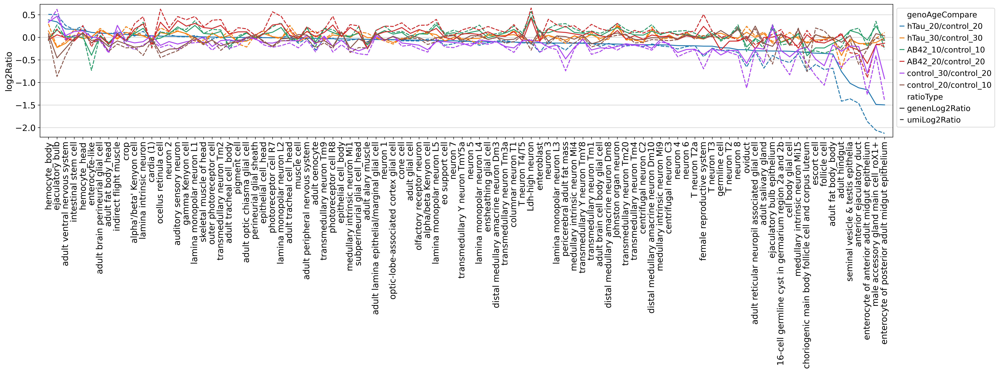

In [71]:
with rc_context({'figure.figsize': (25, 4)}):
    fig, ax = plt.subplots()
    
    ax.margins(0.01, 0.03)
    ax.grid(axis='x',visible=False)
    
    sns.lineplot(data=geneN_sort_Df, x='annotation', y='log2Ratio', hue='genoAgeCompare', style='ratioType', ) # palette=set2Color_L
    plt.xticks(rotation=90)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xlabel('')
    
    # plt.savefig(f'{figure5PicFolder}/log2Ratio_umi_geneN.pdf', bbox_inches='tight')

In [72]:
geneN_sort_Df.head()

,genoAgeCompare,annotation,ratioType,log2Ratio
0,hTau_20/control_20,hemocyte_body,genenLog2Ratio,0.386481
1,hTau_20/control_20,ejaculatory bulb,genenLog2Ratio,0.340979
2,hTau_20/control_20,adult ventral nervous system,genenLog2Ratio,0.185075
3,hTau_20/control_20,intestinal stem cell,genenLog2Ratio,0.175012
4,hTau_20/control_20,hemocyte_head,genenLog2Ratio,0.157135


In [73]:
geneN_mtx = geneN_sort_Df[geneN_sort_Df.ratioType == 'genenLog2Ratio'].loc[:,['genoAgeCompare','annotation','log2Ratio']].pivot(index='annotation', columns='genoAgeCompare') #
geneN_mtx.index.name = None
geneN_mtx.columns = [colIndex[1] for colIndex in geneN_mtx.columns.to_list()]
geneN_mtx

,AB42_10/control_10,AB42_20/control_20,control_20/control_10,control_30/control_20,hTau_20/control_20,hTau_30/control_30
16-cell germline cyst in germarium region 2a and 2b,-0.113751,0.069348,0.065684,-0.296201,-0.303770,-0.102534
Johnston organ neuron,0.214886,0.149420,0.096037,-0.201892,-0.149425,0.246364
Ldh-high neuron,0.451258,0.424439,-0.151701,-0.064816,-0.119507,-0.094583
T neuron T2,0.032892,-0.085247,0.032892,-0.292301,-0.237250,0.016200
T neuron T2a,0.020780,-0.002953,0.019306,-0.263034,-0.188857,-0.010660
...,...,...,...,...,...,...
transmedullary neuron Tm2,0.131128,0.265590,-0.189572,-0.072386,0.003066,-0.014597
transmedullary neuron Tm20,0.116758,-0.035785,0.052348,-0.141687,-0.155936,-0.046833
transmedullary neuron Tm3a,0.095839,0.018034,-0.053439,-0.202617,-0.103430,0.042864
transmedullary neuron Tm4,0.054340,0.037243,-0.050418,-0.172946,-0.161086,-0.039670


In [74]:
geneN_mtx_nonNeuron = geneN_mtx[geneN_mtx.index.isin(nonNeuronCellType_L)]

In [75]:
geneN_Df.to_csv(f'{geneNumFolder}/geneN_Df.csv')
geneN_sort_Df.to_csv(f'{geneNumFolder}/geneN_sort_Df.csv')

geneN_mtx.to_csv(f'{geneNumFolder}/geneN_mtx.csv')
geneN_mtx_nonNeuron.to_csv(f'{geneNumFolder}/geneN_mtx_nonNeuron.csv')

In [37]:
corr = geneN_mtx_nonNeuron.corr(method = 'spearman').round(2)
corr

,AB42_10/control_10,AB42_20/control_20,control_20/control_10,control_30/control_20,hTau_20/control_20,hTau_30/control_30
AB42_10/control_10,1.00,0.28,0.16,0.39,0.11,-0.30
AB42_20/control_20,0.28,1.00,-0.08,0.27,0.29,-0.12
control_20/control_10,0.16,-0.08,1.00,0.06,-0.06,0.13
control_30/control_20,0.39,0.27,0.06,1.00,0.72,0.00
hTau_20/control_20,0.11,0.29,-0.06,0.72,1.00,0.35
hTau_30/control_30,-0.30,-0.12,0.13,0.00,0.35,1.00


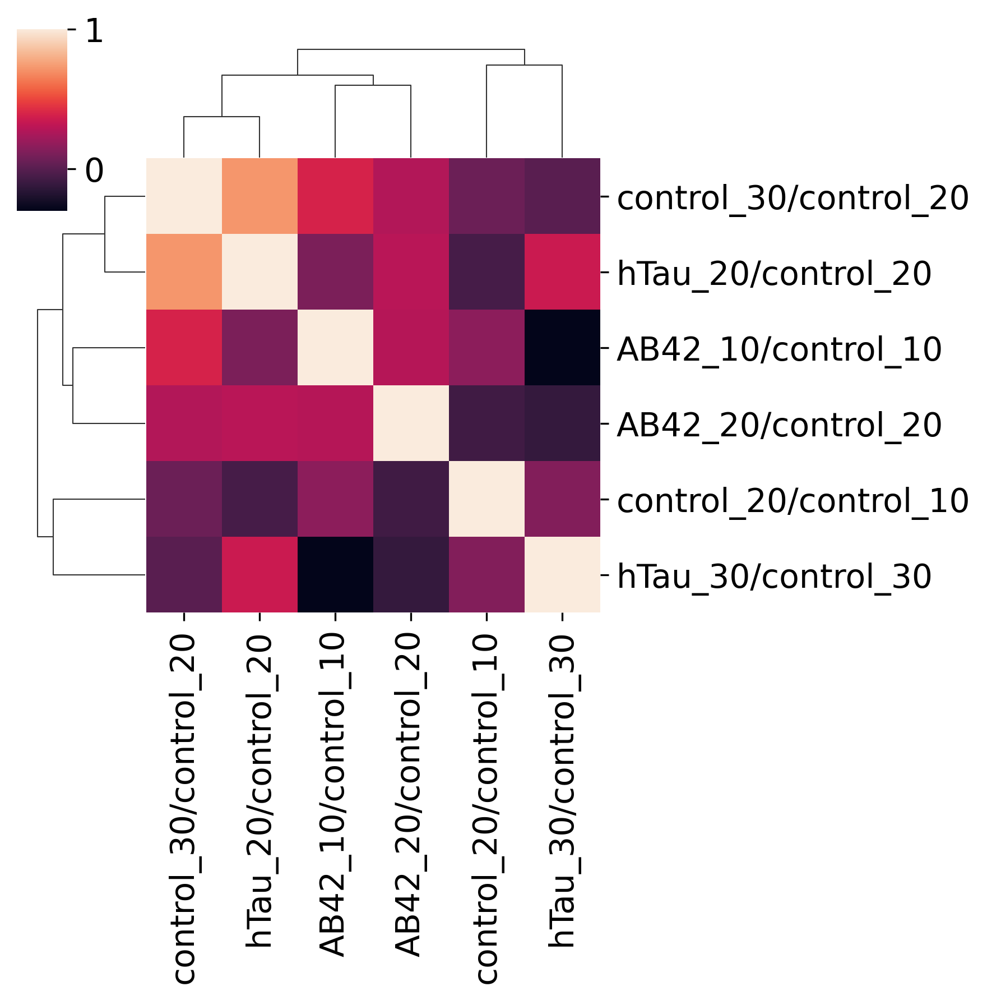

In [38]:
sns.clustermap(corr, figsize=(6, 6), annot=False)
# plt.savefig(f'{figure5PicFolder}/heatmap_agingFeature_correlation_noNoise_noClock.pdf', bbox_inches='tight')
plt.show()

## d. Compare different aging features in hTau_20/control_20

### Load features

In [80]:
# cell composition
normalRatioNonNeuron_Df = pd.read_csv(f'{cellnFig4Folder}/normalRatioNonNeuron_Df_genoAge.csv', index_col=0)
# degN
degN_nonNeuron_mtx = pd.read_csv(f'{degN_genoAgeSummaryFolder}/degN_nonNeuron_mtx.csv', index_col=0)
# identity decline
summaryPivot_Df = pd.read_csv(f'{markerFolder}/summaryPivot_Df_nonNeuron.csv', index_col=0)
# gene#
geneN_mtx_nonNeuron = pd.read_csv(f'{geneNumFolder}/geneN_mtx_nonNeuron.csv', index_col=0)

# geneN_mtx_nonNeuron

In [89]:
geneN_mtx_nonNeuron

,AB42_10/control_10,AB42_20/control_20,control_20/control_10,control_30/control_20,hTau_20/control_20,hTau_30/control_30
16-cell germline cyst in germarium region 2a and 2b,-0.113751,0.069348,0.065684,-0.296201,-0.303770,-0.102534
adult alary muscle,-0.168976,-0.254183,-0.132450,-0.224706,-0.045088,-0.006499
adult brain cell body glial cell,0.033274,0.034567,-0.089617,-0.231724,-0.141674,-0.024662
adult brain perineurial glial cell,0.033588,0.012697,-0.045505,-0.024112,0.091115,0.156535
adult fat body_body,-0.131839,-0.044002,-0.006827,-0.167290,-0.370494,0.000640
adult fat body_head,-0.117885,-0.144621,-0.206276,-0.326097,0.088391,0.078060
adult glial cell,-0.034599,0.087463,0.033788,-0.147557,-0.061401,-0.033683
adult hindgut,-0.045629,0.058333,-0.108998,-0.308567,-0.757735,-0.404475
adult lamina epithelial/marginal glial cell,0.057333,0.053995,0.088227,0.043653,-0.049753,-0.001483
adult oenocyte,-0.102205,0.012978,-0.119483,-0.146221,-0.024837,0.036406


In [90]:
tau20control20_Df = pd.DataFrame()
tau20control20_Df['NucleiN'] = normalRatioNonNeuron_Df['hTau_20/control_20']
tau20control20_Df['degN'] = degN_nonNeuron_mtx['hTau_20/control_20']
tau20control20_Df['identity'] = summaryPivot_Df['hTau_20/control_20']
tau20control20_Df['geneN'] = geneN_mtx_nonNeuron['hTau_20/control_20']

tau20control20_Df

,NucleiN,degN,identity,geneN
optic-lobe-associated cortex glial cell,-0.037707,40,0.0650,-0.050984
adult optic chiasma glial cell,0.126813,28,0.0425,-0.004785
adult lamina epithelial/marginal glial cell,-0.052453,76,0.1125,-0.049753
subperineurial glial cell_head,-0.587784,24,0.0325,-0.041410
adult reticular neuropil associated glial cell,0.076380,39,0.0475,-0.299801
adult fat body_head,0.011678,365,0.2500,0.088391
pigment cell,-0.186650,76,0.1300,-0.003391
adult brain perineurial glial cell,0.262347,88,0.1025,0.091115
ensheathing glial cell,0.084556,83,0.0950,-0.101015
hemocyte_head,-0.181942,240,0.2075,0.157135


**Use the original ratio for calculating the correlation**

In [96]:
tau20control20_Df

,NucleiN,degN,identity,geneN
optic-lobe-associated cortex glial cell,-0.037707,40,0.0650,-0.050984
adult optic chiasma glial cell,0.126813,28,0.0425,-0.004785
adult lamina epithelial/marginal glial cell,-0.052453,76,0.1125,-0.049753
subperineurial glial cell_head,-0.587784,24,0.0325,-0.041410
adult reticular neuropil associated glial cell,0.076380,39,0.0475,-0.299801
adult fat body_head,0.011678,365,0.2500,0.088391
pigment cell,-0.186650,76,0.1300,-0.003391
adult brain perineurial glial cell,0.262347,88,0.1025,0.091115
ensheathing glial cell,0.084556,83,0.0950,-0.101015
hemocyte_head,-0.181942,240,0.2075,0.157135


In [91]:
corrOri = tau20control20_Df.corr(method = 'spearman').round(2)
corrOri

,NucleiN,degN,identity,geneN
NucleiN,1.00,-0.29,-0.28,0.31
degN,-0.29,1.00,0.97,-0.34
identity,-0.28,0.97,1.00,-0.36
geneN,0.31,-0.34,-0.36,1.00


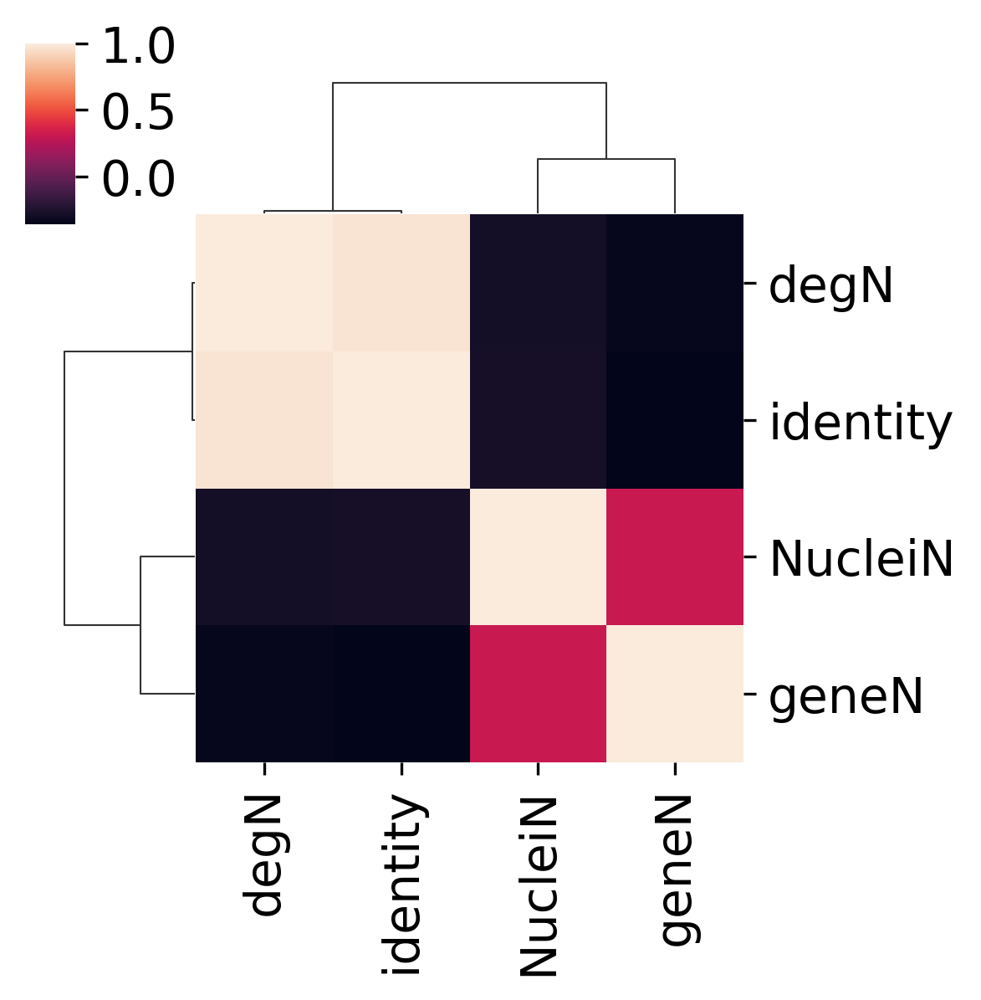

In [93]:
sns.clustermap(corrOri, figsize=(4, 4), annot=False)
# plt.savefig(f'{figure5PicFolder}/heatmap_agingFeature_correlation_noNoise_noClock.pdf', bbox_inches='tight')
plt.show()

**Use absolute ratio for calculating the correlation**

In [94]:
corrAbs = abs(tau20control20_Df).corr(method = 'spearman').round(2)
corrAbs

,NucleiN,degN,identity,geneN
NucleiN,1.00,0.10,0.08,0.22
degN,0.10,1.00,0.97,0.46
identity,0.08,0.97,1.00,0.43
geneN,0.22,0.46,0.43,1.00


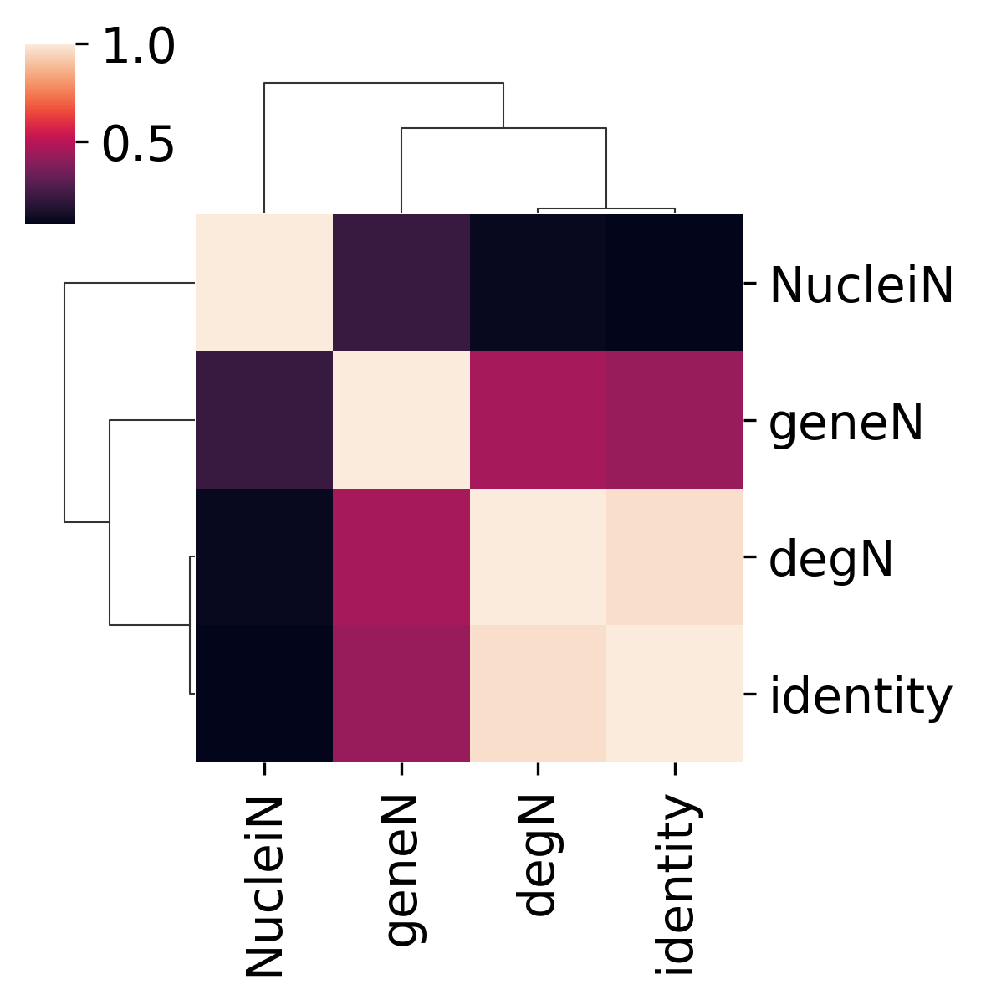

In [95]:
sns.clustermap(corrAbs, figsize=(4, 4), annot=False)
# plt.savefig(f'{figure5PicFolder}/heatmap_agingFeature_correlation_noNoise_noClock.pdf', bbox_inches='tight')
plt.show()

# Finish

### Plot gene#/umi# ratio: sorted by tau20/contol20

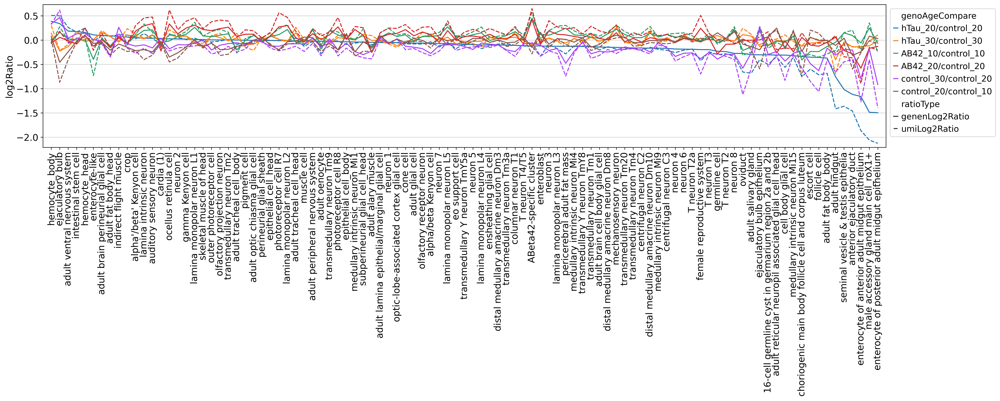

In [39]:
with rc_context({'figure.figsize': (23, 4)}):
    fig, ax = plt.subplots()
    
    ax.margins(0.01, 0.03)
    ax.grid(axis='x',visible=False)
    
    sns.lineplot(data=geneN_sort_Df, x='annotation', y='log2Ratio', hue='genoAgeCompare', style='ratioType', ) # palette=set2Color_L
    plt.xticks(rotation=90)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xlabel('')
    
    plt.savefig(f'{figure5PicFolder}/log2Ratio_umi_geneN.pdf', bbox_inches='tight')

### sorted by "hTau_20/control_20" UMI

In [36]:
geneN_Df = pd.read_csv(f'{geneNumFolder}/geneNum_genoAgeCompareName.csv')
geneN_sort_Df = pd.read_csv(f'{geneNumFolder}/geneN_sort_Df_genoAgeCompare_wilcoxon.csv')
geneN_sort_Df

,genoAgeCompare,annotation,ratioType,log2Ratio,ranksumsTwoSides_stat,ranksumsTwoSides_pvalue,ranksumsGreater_stat,ranksumsGreater_pvalue,ranksumsLess_stat,ranksumsLess_pvalue
0,hTau_20/control_20,hemocyte_body,genenLog2Ratio,0.386481,13.802174,2.472802e-43,13.802174,1.236401e-43,13.802174,1.000000e+00
1,hTau_20/control_20,ejaculatory bulb,genenLog2Ratio,0.340979,6.727306,1.728336e-11,6.727306,8.641681e-12,6.727306,1.000000e+00
2,hTau_20/control_20,adult ventral nervous system,genenLog2Ratio,0.185075,9.276021,1.759253e-20,9.276021,8.796264e-21,9.276021,1.000000e+00
3,hTau_20/control_20,intestinal stem cell,genenLog2Ratio,0.175012,5.037615,4.713694e-07,5.037615,2.356847e-07,5.037615,9.999998e-01
4,hTau_20/control_20,hemocyte_head,genenLog2Ratio,0.157135,8.031052,9.664037e-16,8.031052,4.832019e-16,8.031052,1.000000e+00
...,...,...,...,...,...,...,...,...,...,...
1183,control_20/control_10,seminal vesicle & testis epithelia,umiLog2Ratio,-0.066939,-1.419655,1.557081e-01,-1.419655,9.221460e-01,-1.419655,7.785404e-02
1184,control_20/control_10,anterior ejaculatory duct,umiLog2Ratio,-0.596953,-8.198830,2.427389e-16,-8.198830,1.000000e+00,-8.198830,1.213694e-16
1185,control_20/control_10,enterocyte of anterior adult midgut epithelium,umiLog2Ratio,-0.256904,-0.884019,3.766860e-01,-0.884019,8.116570e-01,-0.884019,1.883430e-01
1186,control_20/control_10,male accessory gland main cell_roX1+,umiLog2Ratio,-0.012971,-0.489433,6.245353e-01,-0.489433,6.877324e-01,-0.489433,3.122676e-01


In [37]:
### sorted by 'hTau_20/control_20' UMI
sortOrder_L = geneN_Df[geneN_Df.genoAgeCompare == 'hTau_20/control_20'].sort_values(by='umiRatio', ascending=False).annotation.to_list()
sortOrder_L

geneN_sort_Df = pd.DataFrame(columns=['genoAgeCompare', 'annotation', 'ratioType', 'log2Ratio',])
for genoAgeCompare in genoAgeCompare_L:
    print(genoAgeCompare)
    genoAgeCompareName = '_'.join(genoAgeCompare.split('/'))
    exp, ref = genoAgeCompare.split('/')
    
    #sorted DF
    genoAge_sort_Df = geneN_Df[geneN_Df.genoAgeCompare == genoAgeCompare]
    genoAge_sort_Df.index = genoAge_sort_Df.annotation.to_list()
    genoAge_sort_Df=genoAge_sort_Df.loc[sortOrder_L]
    genoAge_sort_Df=genoAge_sort_Df.loc[:,['genoAgeCompare', 'annotation', 'genenLog2Ratio', 'umiLog2Ratio']
                                       ].melt(id_vars=['genoAgeCompare', 'annotation'], var_name='ratioType', value_name='log2Ratio') #  
    geneN_sort_Df = pd.concat([geneN_sort_Df, genoAge_sort_Df ], axis=0)
    

geneN_sort_Df.reset_index(drop=True, inplace=True)
geneN_sort_Df

hTau_20/control_20
hTau_30/control_30
AB42_10/control_10
AB42_20/control_20
control_30/control_20
control_20/control_10


,genoAgeCompare,annotation,ratioType,log2Ratio
0,hTau_20/control_20,hemocyte_body,genenLog2Ratio,0.386481
1,hTau_20/control_20,ejaculatory bulb,genenLog2Ratio,0.340979
2,hTau_20/control_20,adult ventral nervous system,genenLog2Ratio,0.185075
3,hTau_20/control_20,hemocyte_head,genenLog2Ratio,0.157135
4,hTau_20/control_20,intestinal stem cell,genenLog2Ratio,0.175012
...,...,...,...,...
1183,control_20/control_10,adult hindgut,umiLog2Ratio,-0.274611
1184,control_20/control_10,anterior ejaculatory duct,umiLog2Ratio,-0.596953
1185,control_20/control_10,enterocyte of anterior adult midgut epithelium,umiLog2Ratio,-0.256904
1186,control_20/control_10,male accessory gland main cell_roX1+,umiLog2Ratio,-0.012971


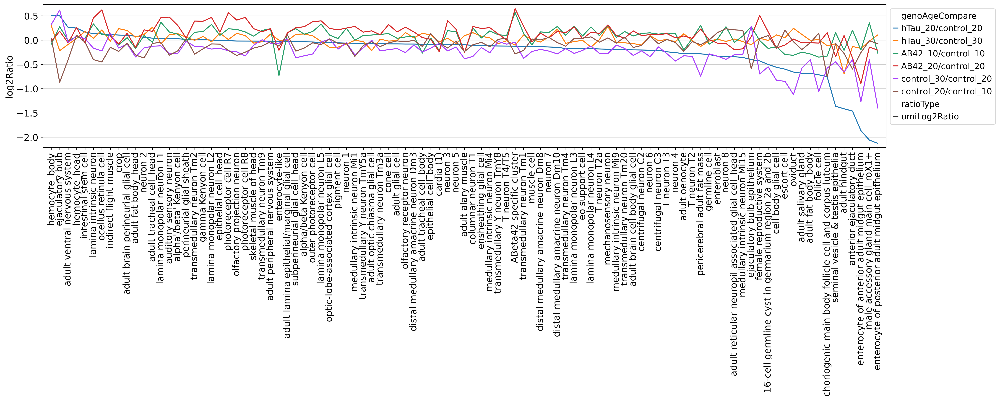

In [38]:
with rc_context({'figure.figsize': (23, 4)}):
    fig, ax = plt.subplots()
    
    ax.margins(0.01, 0.03)
    ax.grid(axis='x',visible=False)
    
    sns.lineplot(data=geneN_sort_Df[geneN_sort_Df.ratioType == 'umiLog2Ratio'], x='annotation', y='log2Ratio', hue='genoAgeCompare', style='ratioType', ) # palette=set2Color_L
    plt.xticks(rotation=90)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xlabel('')
    
    plt.savefig(f'{figure4PicFolder}/log2Ratio_umi_sortedByUMI.pdf', bbox_inches='tight')

### sort UMI ratio by "AB42_20/control_20"

In [39]:
sortOrder_L = geneN_Df[geneN_Df.genoAgeCompare == 'AB42_20/control_20'].sort_values(by='umiRatio', ascending=False).annotation.to_list()
sortOrder_L

geneN_sort_Df = pd.DataFrame(columns=['genoAgeCompare', 'annotation', 'ratioType', 'log2Ratio',])
for genoAgeCompare in genoAgeCompare_L:
    print(genoAgeCompare)
    genoAgeCompareName = '_'.join(genoAgeCompare.split('/'))
    exp, ref = genoAgeCompare.split('/')
    
    #sorted DF
    genoAge_sort_Df = geneN_Df[geneN_Df.genoAgeCompare == genoAgeCompare]
    genoAge_sort_Df.index = genoAge_sort_Df.annotation.to_list()
    genoAge_sort_Df=genoAge_sort_Df.loc[sortOrder_L]
    genoAge_sort_Df=genoAge_sort_Df.loc[:,['genoAgeCompare', 'annotation', 'genenLog2Ratio', 'umiLog2Ratio']
                                       ].melt(id_vars=['genoAgeCompare', 'annotation'], var_name='ratioType', value_name='log2Ratio') #  
    geneN_sort_Df = pd.concat([geneN_sort_Df, genoAge_sort_Df ], axis=0)
    

geneN_sort_Df.reset_index(drop=True, inplace=True)
geneN_sort_Df

hTau_20/control_20
hTau_30/control_30
AB42_10/control_10
AB42_20/control_20
control_30/control_20
control_20/control_10


,genoAgeCompare,annotation,ratioType,log2Ratio
0,hTau_20/control_20,ABeta42-specific cluster,genenLog2Ratio,-0.119507
1,hTau_20/control_20,ocellus retinula cell,genenLog2Ratio,0.026304
2,hTau_20/control_20,photoreceptor cell R7,genenLog2Ratio,-0.009641
3,hTau_20/control_20,female reproductive system,genenLog2Ratio,-0.196055
4,hTau_20/control_20,auditory sensory neuron,genenLog2Ratio,0.037633
...,...,...,...,...
1183,control_20/control_10,cardia (1),umiLog2Ratio,-0.059599
1184,control_20/control_10,adult alary muscle,umiLog2Ratio,-0.236110
1185,control_20/control_10,seminal vesicle & testis epithelia,umiLog2Ratio,-0.066939
1186,control_20/control_10,anterior ejaculatory duct,umiLog2Ratio,-0.596953


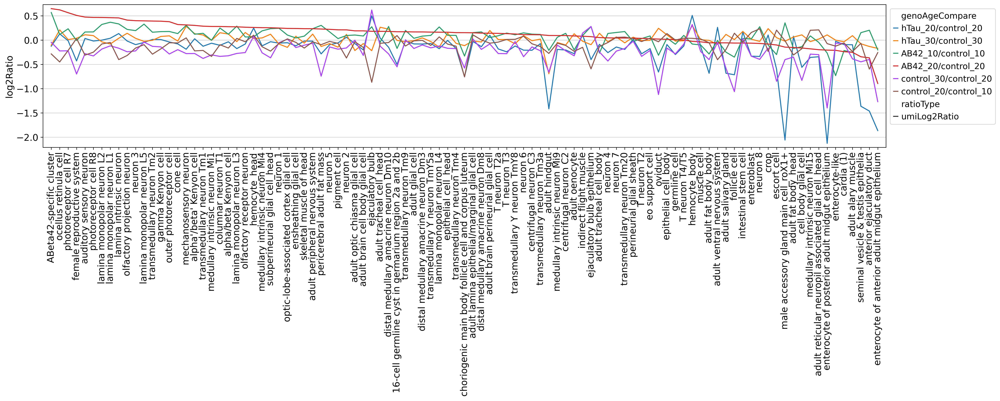

In [40]:
with rc_context({'figure.figsize': (23, 4)}):
    fig, ax = plt.subplots()
    
    ax.margins(0.01, 0.03)
    ax.grid(axis='x',visible=False)
    
    sns.lineplot(data=geneN_sort_Df[geneN_sort_Df.ratioType == 'umiLog2Ratio'], x='annotation', y='log2Ratio', hue='genoAgeCompare', style='ratioType', ) # palette=set2Color_L
    plt.xticks(rotation=90)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xlabel('')
    
    plt.savefig(f'{figure4PicFolder}/log2Ratio_umi_sortedByAB42UMI.pdf', bbox_inches='tight')

In [138]:
cellType_L = ['medullary intrinsic neuron Mi1', 'lamina monopolar neuron L2', 'auditory sensory neuron', 'olfactory receptor neuron', 'lamina intrinsic neuron',
              'adult lamina epithelial/marginal glial cell', 'olfactory projection neuron', 'transmedullary neuron Tm3a', 'outer photoreceptor cell', 'ocellus retinula cell']

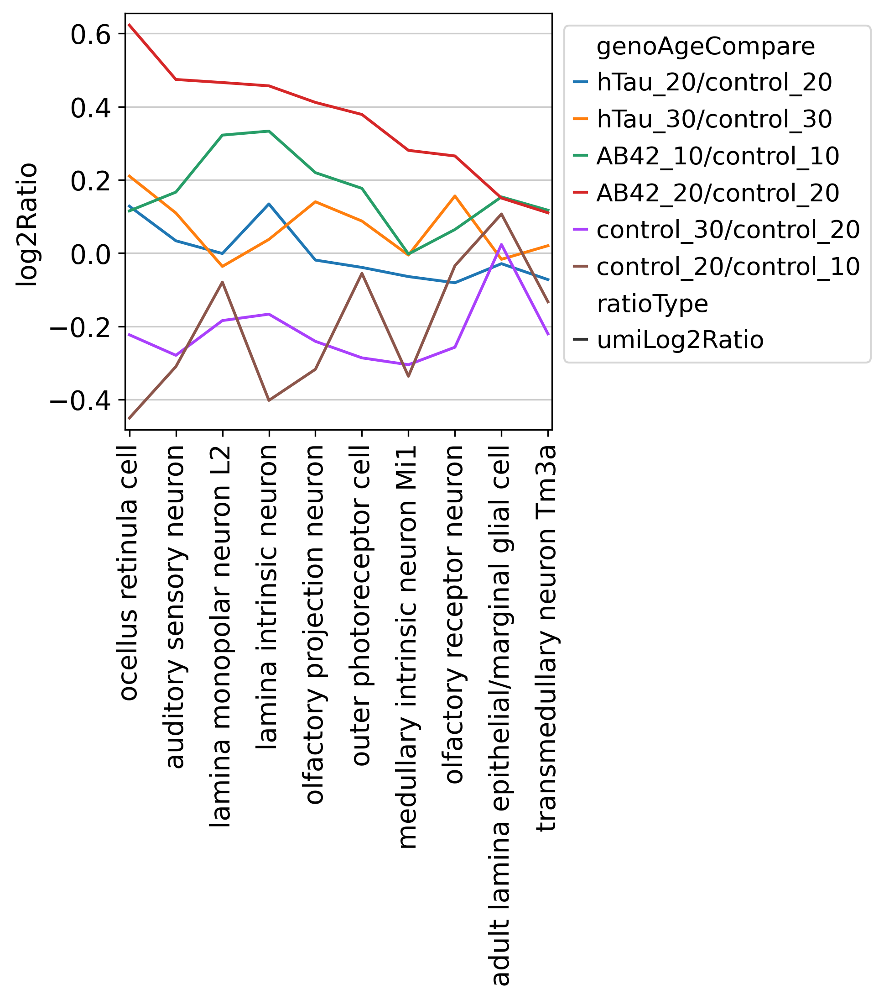

In [139]:
with rc_context({'figure.figsize': (4, 4)}):
    fig, ax = plt.subplots()
    
    ax.margins(0.01, 0.03)
    ax.grid(axis='x',visible=False)
    
    sns.lineplot(data=geneN_sort_Df[ (geneN_sort_Df.ratioType == 'umiLog2Ratio') & (geneN_sort_Df.annotation.isin(cellType_L)) ], 
                 x='annotation', y='log2Ratio', hue='genoAgeCompare', style='ratioType', ) # palette=set2Color_L
    plt.xticks(rotation=90)
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.xlabel('')
    
    plt.savefig(f'{figure4PicFolder}/log2Ratio_umi_sortedByAB42UMI_AB42downNeuron.pdf', bbox_inches='tight')